In [ ]:

# Installs & Imports

!pip install nltk gensim

import os, re, random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# NLP / NLTK
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
from gensim.models import Word2Vec
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# Sklearn
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE

# Utilities
from dataclasses import dataclass
from typing import List, Callable, Dict

# Downloads
nltk.download('punkt', quiet=True)
nltk.download('punkt_tab', quiet=True)
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)
nltk.download('omw-1.4', quiet=True)


# Load Corpus

url = "https://raw.githubusercontent.com/barrycforever/MSDS_453_NLP/main/MSDS453_ClassCorpus/MSDS453_ClassCorpus_Final_Sec56_v1_20250924.csv"
corpus_df = pd.read_csv(url)

print(corpus_df.shape)
print(corpus_df[['Doc_ID', 'Movie Title']].head())


#Dataclasses

@dataclass
class Document:
    doc_id: str
    text: str

@dataclass
class TokenizedDocument:
    doc_id: str
    tokens: List[str]


#  Normalization Functions

def remove_punctuation(text): return re.sub('[^a-zA-Z]', ' ', str(text))
def lower_case(text): return text.lower()
def remove_tags(text): return re.sub("&lt;/?.*?&gt;", " ", text)
def remove_special_chars_and_digits(text): return re.sub("(\\d|\\W)+", " ", text)

def normalize_document(document: Document) -> Document:
    text = remove_punctuation(document.text)
    text = lower_case(text)
    text = remove_tags(text)
    text = remove_special_chars_and_digits(text)
    return Document(document.doc_id, text)

def normalize_documents(documents: List[Document]) -> List[Document]:
    return [normalize_document(x) for x in documents]



# 5. Tokenization, Lemmatization, Stemming, Stopwords
def tokenize_document(document: Document) -> TokenizedDocument:
    tokens = nltk.word_tokenize(document.text)
    return TokenizedDocument(document.doc_id, tokens)

def tokenize_documents(documents: List[Document]) -> List[TokenizedDocument]:
    return [tokenize_document(x) for x in documents]

def lemmatize_documents(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    lemmatizer = WordNetLemmatizer()
    for document in documents:
        output_tokens = [lemmatizer.lemmatize(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))
    return result

def stem_documents(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    stemmer = PorterStemmer()
    for document in documents:
        output_tokens = [stemmer.stem(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))
    return result

def remove_stop_words(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    stop_words = set(stopwords.words('english'))
    result = []
    for document in documents:
        filtered_tokens = [w for w in document.tokens if w not in stop_words]
        result.append(TokenizedDocument(document.doc_id, filtered_tokens))
    return result


#  Wrap Docs for Use
documents = [Document(x, y) for x, y in zip(corpus_df.Doc_ID, corpus_df.Text)]
normalized_documents = normalize_documents(documents)


#  Helper Cleaning Pipelines
def clean_and_lemmatize(docs): return lemmatize_documents(tokenize_documents(normalize_documents(docs)))
def clean_and_stem(docs): return stem_documents(tokenize_documents(normalize_documents(docs)))
def clean_and_remove_stopwords(docs): return remove_stop_words(tokenize_documents(normalize_documents(docs)))

def clean_method(documents: List[Document]) -> List[TokenizedDocument]:
    """normalize, tokenize , lemmatize , stopwords , stem"""
    documents = normalize_documents(documents)
    documents = tokenize_documents(documents)
    documents = lemmatize_documents(documents)
    documents = remove_stop_words(documents)
    documents = stem_documents(documents)
    return documents


# Lookup Maps
titles_by_doc_ids = {int(x): y for x, y in zip(corpus_df['Doc_ID'], corpus_df['Movie Title'])}
genres_by_doc_ids = {int(x): y for x, y in zip(corpus_df['Doc_ID'], corpus_df['Genre of Movie'])}
descriptors_by_doc_ids = {int(x): f"{titles_by_doc_ids[int(x)]}#{int(x)}" for x in corpus_df['Doc_ID']}


# Helper: Get All Tokens
def get_all_tokens(documents: List[TokenizedDocument]) -> List[str]:
    tokens = {tok for doc in documents for tok in doc.tokens}
    return sorted(list(tokens))


(200, 8)
   Doc_ID Movie Title
0     101  Mean_Girls
1     102  Mean_Girls
2     103  Mean_Girls
3     104  Mean_Girls
4     105  Mean_Girls


In [ ]:

# TF-IDF Runner
def run_tfidf(documents: List[Document],
              clean_func: Callable[[List[Document]], List[TokenizedDocument]],
              important_prevalent_terms: List[str],
              experiment_name: str,
              output_tfidf_vectors: bool=False,
              output_vocabulary: bool=True,
              plot_heatmap: bool=True) -> pd.DataFrame:
    """
    Run TF-IDF experiment with flexible preprocessing and Bridesmaids focus.
    """
    # Clean docs with chosen function
    cleaned_documents = clean_func(documents)
    cleaned_document_text = [' '.join(x.tokens) for x in cleaned_documents]

    vectorizer = TfidfVectorizer(use_idf=True, ngram_range=(1, 1), norm=None)
    transformed_documents = vectorizer.fit_transform(cleaned_document_text)

    # Document-term DataFrame
    doc_term_matrix = transformed_documents.todense()
    doc_term_df = pd.DataFrame(doc_term_matrix,
                               columns=vectorizer.get_feature_names_out(),
                               index=corpus_df.Doc_ID)

    # Add Bridesmaids and Comedy flags
    doc_term_df['is_bridesmaids'] = (corpus_df['Movie Title'] == "Bridesmaids").reindex(doc_term_df.index).fillna(False)
    doc_term_df['is_comedy'] = (corpus_df['Genre of Movie'] == "Comedy").reindex(doc_term_df.index).fillna(False)

    # Top-10 mean TF-IDF
    top10_tfidf = pd.DataFrame(doc_term_df.mean().sort_values(ascending=False).head(10))
    top10_tfidf.rename(columns={0: 'Mean TF-IDF'}, inplace=True)
    display(top10_tfidf)

    # Mean scores for important terms
    tfidf_results = pd.DataFrame(index=important_prevalent_terms)
    all_tfidf_results = doc_term_df[[x for x in important_prevalent_terms if x in doc_term_df.columns]].mean().round(2)
    tfidf_results['All Movies'] = all_tfidf_results
    display(tfidf_results)

    # Histogram
    plt.hist(doc_term_df.mean(), 100, range=(0, 8))
    plt.title("Distribution of TF-IDF Scores")
    plt.show()

    # Bridesmaids-only heatmap
    if plot_heatmap:
        bridesmaids_ids = list(corpus_df[corpus_df['Movie Title'] == "Bridesmaids"]['Doc_ID'])
        if len(bridesmaids_ids) > 1:
            similarities = cosine_similarity(
                doc_term_df.loc[bridesmaids_ids].drop(columns=['is_bridesmaids','is_comedy']),
                doc_term_df.loc[bridesmaids_ids].drop(columns=['is_bridesmaids','is_comedy'])
            )
            fig, ax = plt.subplots(figsize=(10, 10))
            labels = [f"Doc{d}" for d in bridesmaids_ids]
            sns.heatmap(ax=ax, data=similarities, xticklabels=labels, yticklabels=labels)
            plt.show()

    return doc_term_df


/tmp/ipython-input-51230635.py:26: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  doc_term_df['is_bridesmaids'] = (corpus_df['Movie Title'] == "Bridesmaids").reindex(doc_term_df.index).fillna(False)
/tmp/ipython-input-51230635.py:27: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  doc_term_df['is_comedy'] = (corpus_df['Genre of Movie'] == "Comedy").reindex(doc_term_df.index).fillna(False)


,Mean TF-IDF
film,3.548430
movi,3.305180
ha,2.547376
barbi,2.479935
like,2.407103
one,2.263944
wa,2.251497
time,1.999351
charact,1.880528
anni,1.852241


,All Movies
bridesmaids,NaN
annie,NaN
wiig,0.68
helen,0.50
women,NaN
wedding,NaN
comedy,NaN
lillian,0.70


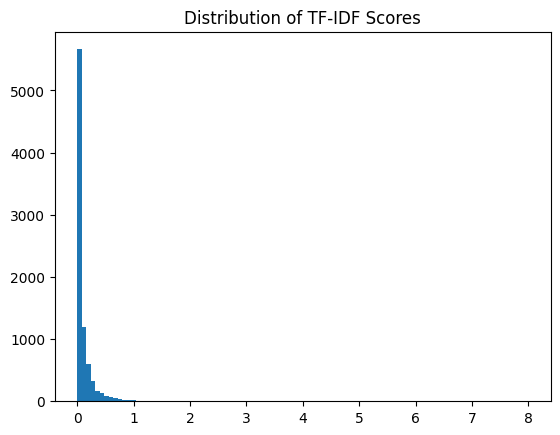

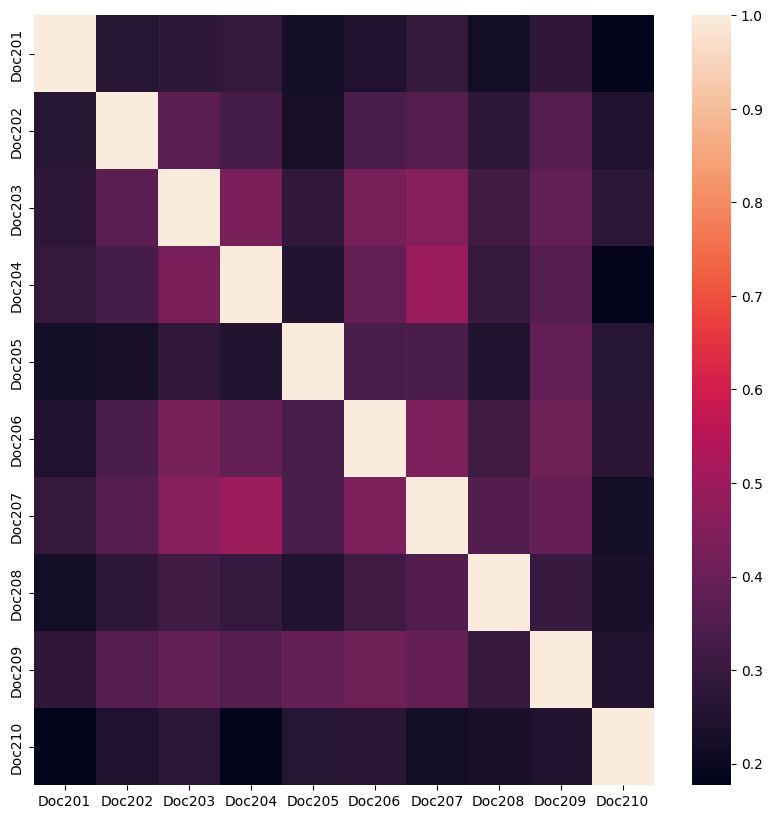

In [ ]:
important_terms = ["bridesmaids", "annie", "wiig", "helen", "women", "wedding", "comedy", "lillian"]


# Run with cleaning method
doc_term_df = run_tfidf(documents, clean_method, important_terms, "Bridesmaids_TFIDF")


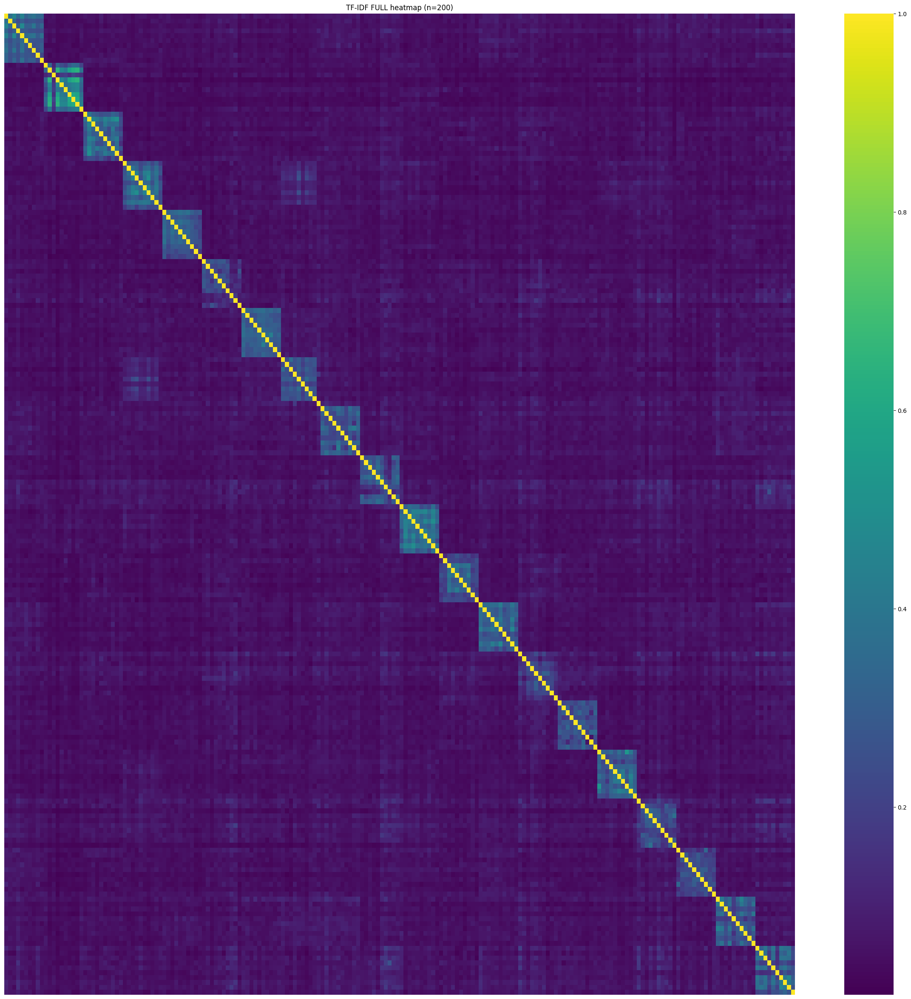

In [ ]:
# TF-IDF document–document heatmaps (FULL and SUBSET)


def _build_tfidf_doc_df(docs):
    """Rebuild TF-IDF doc-term matrix using cleaning config; index = Doc_ID."""
    cleaned = clean_method(docs)
    texts = [' '.join(x.tokens) for x in cleaned]
    vec = TfidfVectorizer(use_idf=True, ngram_range=(1, 1), norm=None)
    X = vec.fit_transform(texts).toarray()
    doc_ids = [d.doc_id for d in cleaned]
    df = pd.DataFrame(X, index=doc_ids, columns=vec.get_feature_names_out())
    return df

def _order_by_movie_title(df):
    """Stable order by movie title so same-movie blocks appear along the diagonal."""
    order = sorted(df.index, key=lambda i: (titles_by_doc_ids[int(i)], int(i)))
    return df.loc[order]

def _subset_one_per_movie(df, n=20):
    """Pick at most one representative doc per movie."""
    seen, keep = set(), []
    for i in df.index:
        t = titles_by_doc_ids[int(i)]
        if t not in seen:
            keep.append(i)
            seen.add(t)
        if len(keep) >= n:
            break
    return df.loc[keep]

def plot_similarity_matrix_unlabeled(data: pd.DataFrame, title: str, figsize=(30, 30)):
    """Doc–doc similarity heatmap without labels (professor’s request)."""
    sims = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(ax=ax, data=sims, xticklabels=False, yticklabels=False, cmap='viridis')
    ax.set_title(title)
    plt.show()

# Compute once, then plot both views
tfidf_doc_df = _order_by_movie_title(_build_tfidf_doc_df(documents))

# FULL n x n
plot_similarity_matrix_unlabeled(tfidf_doc_df, title=f"TF-IDF FULL heatmap (n={len(tfidf_doc_df)})")

# SUBSET
subset_df = _subset_one_per_movie(tfidf_doc_df, n=20)
subset_labeled = subset_df.copy()
subset_labeled.index = [f"{titles_by_doc_ids[int(i)]}#{i}" for i in subset_df.index]


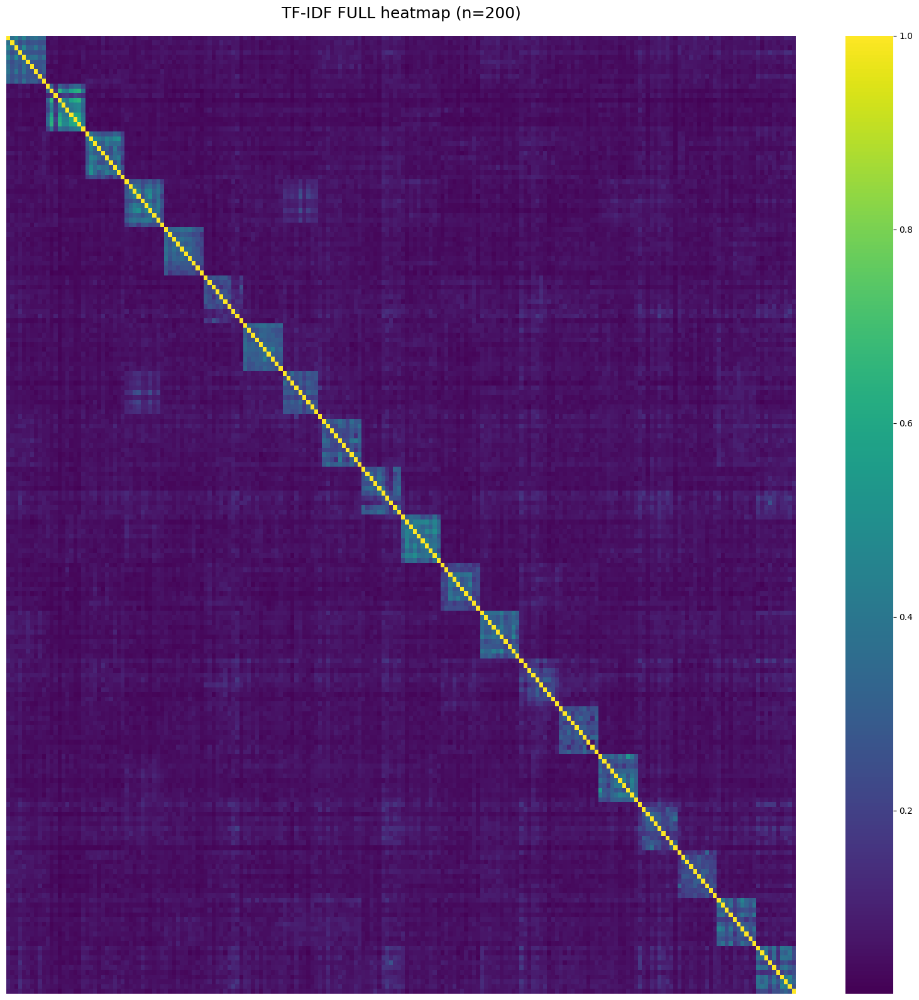

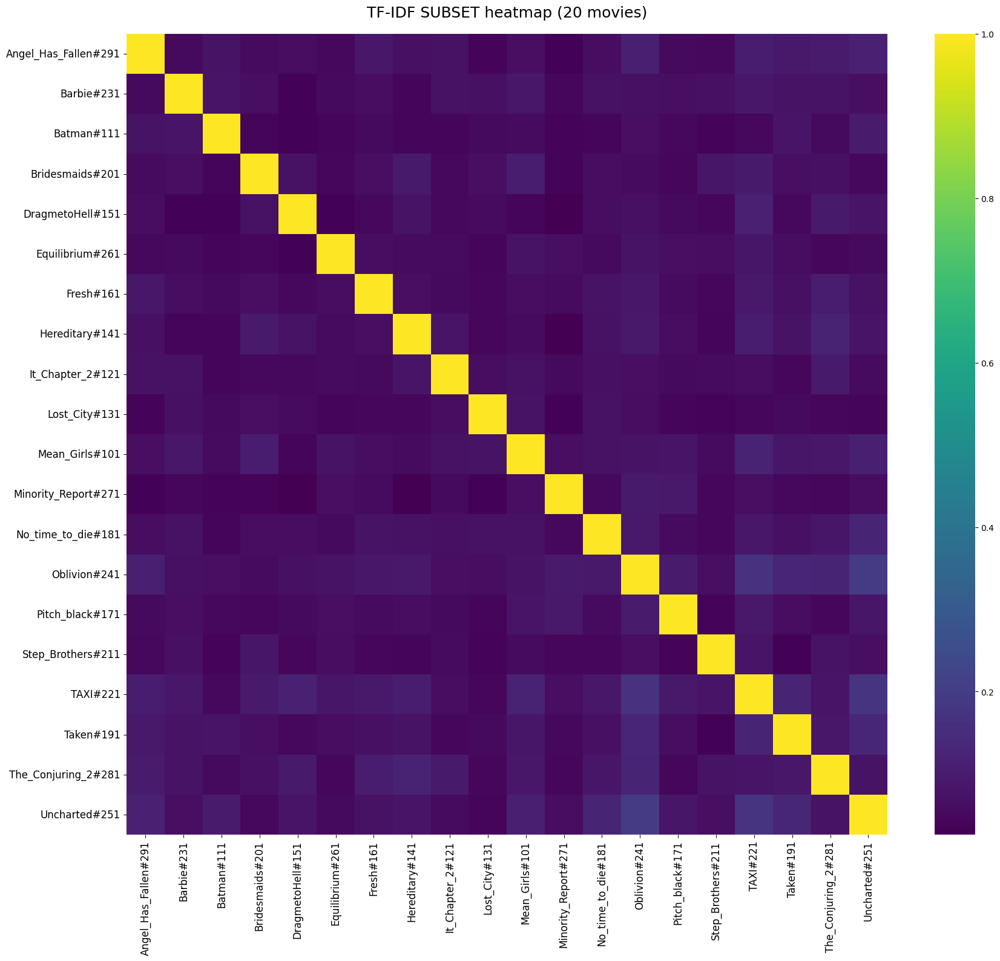

In [ ]:
# TF-IDF document–document heatmaps (FULL and SUBSET, updated for readability)


def _build_tfidf_doc_df(docs):
    """Rebuild TF-IDF doc-term matrix using cleaning config; index = Doc_ID."""
    cleaned = clean_method(docs)
    texts = [' '.join(x.tokens) for x in cleaned]
    vec = TfidfVectorizer(use_idf=True, ngram_range=(1, 1), norm=None)
    X = vec.fit_transform(texts).toarray()
    doc_ids = [d.doc_id for d in cleaned]
    df = pd.DataFrame(X, index=doc_ids, columns=vec.get_feature_names_out())
    return df

def _order_by_movie_title(df):
    """Stable order by movie title so same-movie blocks appear along the diagonal."""
    order = sorted(df.index, key=lambda i: (titles_by_doc_ids[int(i)], int(i)))
    return df.loc[order]

def _subset_one_per_movie(df, n=20):
    """Pick at most one representative doc per movie."""
    seen, keep = set(), []
    for i in df.index:
        t = titles_by_doc_ids[int(i)]
        if t not in seen:
            keep.append(i)
            seen.add(t)
        if len(keep) >= n:
            break
    return df.loc[keep]

def plot_similarity_matrix_unlabeled(data: pd.DataFrame, title: str, figsize=(16, 16)):
    """Doc–doc similarity heatmap without labels (professor’s request)."""
    sims = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(
        ax=ax,
        data=sims,
        xticklabels=False,
        yticklabels=False,
        cmap='viridis'
    )
    ax.set_title(title, fontsize=18, pad=20)
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png", dpi=300, bbox_inches="tight")
    plt.show()

def plot_similarity_matrix_labeled(data: pd.DataFrame, title: str, figsize=(18, 16)):
    """Doc–doc similarity heatmap with readable labels for subset view."""
    sims = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(
        ax=ax,
        data=sims,
        xticklabels=data.index,
        yticklabels=data.index,
        cmap='viridis'
    )
    ax.set_title(title, fontsize=18, pad=20)
    plt.xticks(fontsize=12, rotation=90)
    plt.yticks(fontsize=12)
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png", dpi=300, bbox_inches="tight")
    plt.show()


# Compute and plot
tfidf_doc_df = _order_by_movie_title(_build_tfidf_doc_df(documents))

# FULL n x n (unlabeled, just block structure)
plot_similarity_matrix_unlabeled(tfidf_doc_df, title=f"TF-IDF FULL heatmap (n={len(tfidf_doc_df)})")

# SUBSET (labeled, one per movie)
subset_df = _subset_one_per_movie(tfidf_doc_df, n=20)
subset_labeled = subset_df.copy()
subset_labeled.index = [f"{titles_by_doc_ids[int(i)]}#{i}" for i in subset_df.index]

plot_similarity_matrix_labeled(subset_labeled, title="TF-IDF SUBSET heatmap (20 movies)")


In [ ]:
# Extra terms setup (Bridesmaids focus)


extra_terms = [
    'bridesmaids',
    'annie',
    'lillian',
    'helen',
    'wedding',
    'comedy',
    'friendship'
]

# Build pool of candidate tokens
all_tokens = get_all_tokens(remove_stop_words(clean_method(documents)))
chosen_tokens = random.choices(all_tokens, k=100 - len(extra_terms)) + extra_terms

# Lemmatize + stem chosen tokens
lemmatizer = WordNetLemmatizer()
lemmatized_chosen_tokens = [lemmatizer.lemmatize(x) for x in chosen_tokens]
stemmer = PorterStemmer()
stemmed_chosen_tokens = [stemmer.stem(x) for x in lemmatized_chosen_tokens]


In [ ]:
# Token Selection for Word2Vec

from collections import Counter

def _ensure_pos_tagger():
    """Make sure POS tagger is available for nouns/verbs strategy."""
    try:
        nltk.pos_tag(["ok"])
    except LookupError:
        for res in ("averaged_perceptron_tagger_eng", "averaged_perceptron_tagger"):
            try:
                nltk.download(res, quiet=True)
                nltk.pos_tag(["ok"])
                break
            except Exception:
                pass

def select_tokens_for_word2vec(strategy: str = "most_common", top_k: int = 50):
    """
    Select tokens for Word2Vec visualizations.
    - strategy: 'most_common', 'nouns', or 'verbs'
    - top_k: number of tokens to return
    """
    strategy = strategy.lower()

    # Clean docs fully
    cleaned = clean_method(documents)  # List[TokenizedDocument]
    w2v_tokens = [tok for d in cleaned for tok in d.tokens]
    counts = Counter(w2v_tokens)

    if strategy == "most_common":
        filtered = list(counts.items())

    elif strategy in ("nouns", "verbs"):
        _ensure_pos_tagger()
        # tokenize raw docs for POS tagging
        raw_tokens = [w for td in tokenize_documents(normalize_documents(documents))
                        for w in td.tokens if len(w) > 2]

        # desired POS prefix
        want = "NN" if strategy == "nouns" else "VB"
        tagged = nltk.pos_tag(raw_tokens)
        pos_kept = [w for (w, tag) in tagged if tag.startswith(want)]

        # align with your pipeline (lemmatize → stem)
        aligned_doc = stem_documents(lemmatize_documents([TokenizedDocument(-1, pos_kept)]))[0]
        allowed_tokens = aligned_doc.tokens

        filtered = [(t, c) for (t, c) in counts.items() if t in allowed_tokens]

    else:
        raise ValueError("strategy must be 'most_common', 'nouns', or 'verbs'")

    # Sort & trim
    filtered.sort(key=lambda x: x[1], reverse=True)
    tokens = [t for t, _ in filtered[:top_k]]
    return tokens


# Select top tokens
TOP_K = 100
tokens_most_common = select_tokens_for_word2vec("most_common", TOP_K)
print(f"most_common: selected {len(tokens_most_common)} tokens -> {tokens_most_common[:10]}")

tokens_nouns = select_tokens_for_word2vec("nouns", TOP_K)
print(f"nouns: selected {len(tokens_nouns)} tokens -> {tokens_nouns[:10]}")

tokens_verbs = select_tokens_for_word2vec("verbs", TOP_K)
print(f"verbs: selected {len(tokens_verbs)} tokens -> {tokens_verbs[:10]}")


most_common: selected 100 tokens -> ['film', 'movi', 'ha', 'like', 'one', 'wa', 'time', 'charact', 'make', 'get']
nouns: selected 100 tokens -> ['film', 'movi', 'like', 'one', 'time', 'charact', 'make', 'get', 'play', 'even']
verbs: selected 100 tokens -> ['film', 'ha', 'like', 'one', 'wa', 'time', 'make', 'get', 'play', 'even']


In [ ]:

# Word2Vec Experiment Runner
def get_word2vec_vectors(documents: List[TokenizedDocument], embedding_size: int) -> pd.DataFrame:
    tokens = [x.tokens for x in documents]
    word2vec_model = Word2Vec(sentences=tokens, vector_size=embedding_size,
                              window=3, min_count=1, workers=12)
    vectors = {i: word2vec_model.wv[i] for i in word2vec_model.wv.index_to_key}
    result = pd.DataFrame(vectors).transpose().sort_index()
    return result

def plot_similarity_matrix(data: pd.DataFrame, experiment_name: str, figsize=(25, 25)):
    sims = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(ax=ax, data=sims, xticklabels=data.index, yticklabels=data.index)
    plt.show()

def plot_similarity_clustermap(data: pd.DataFrame, experiment_name: str, figsize=(25, 25)):
    sims = cosine_similarity(data, data)
    cm = sns.clustermap(sims, metric='cosine',
                        xticklabels=data.index, yticklabels=data.index,
                        method='complete', cmap='RdBu', figsize=figsize)
    cm.ax_row_dendrogram.set_visible(False)
    cm.ax_col_dendrogram.set_visible(False)
    plt.show()

def plot_tsne(data: pd.DataFrame, perplexity: int, experiment_name: str, figsize=(40, 40)):
    tsne_model = TSNE(perplexity=perplexity, n_components=2, learning_rate='auto',
                      init='pca', n_iter=1000, random_state=32)
    new_values = tsne_model.fit_transform(data)
    labels = list(data.index)
    plt.figure(figsize=figsize)
    for i, (x, y) in enumerate(new_values):
        plt.scatter(x, y)
        plt.annotate(labels[i], xy=(x, y), xytext=(5, 2),
                     textcoords='offset points', ha='right', va='bottom')
    plt.show()

def run_word2vec_experiment(documents: List[Document],
                            clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                            embedding_size: int,
                            chosen_tokens: List[str],
                            experiment_name: str):
    cleaned_documents = clean_func(documents)
    word2vec_df = get_word2vec_vectors(cleaned_documents, embedding_size)
    filtered_word2vec_df = word2vec_df.loc[chosen_tokens].copy()
    plot_tsne(filtered_word2vec_df, 30, experiment_name)
    plot_similarity_matrix(filtered_word2vec_df, experiment_name)
    plot_similarity_clustermap(filtered_word2vec_df, experiment_name)


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


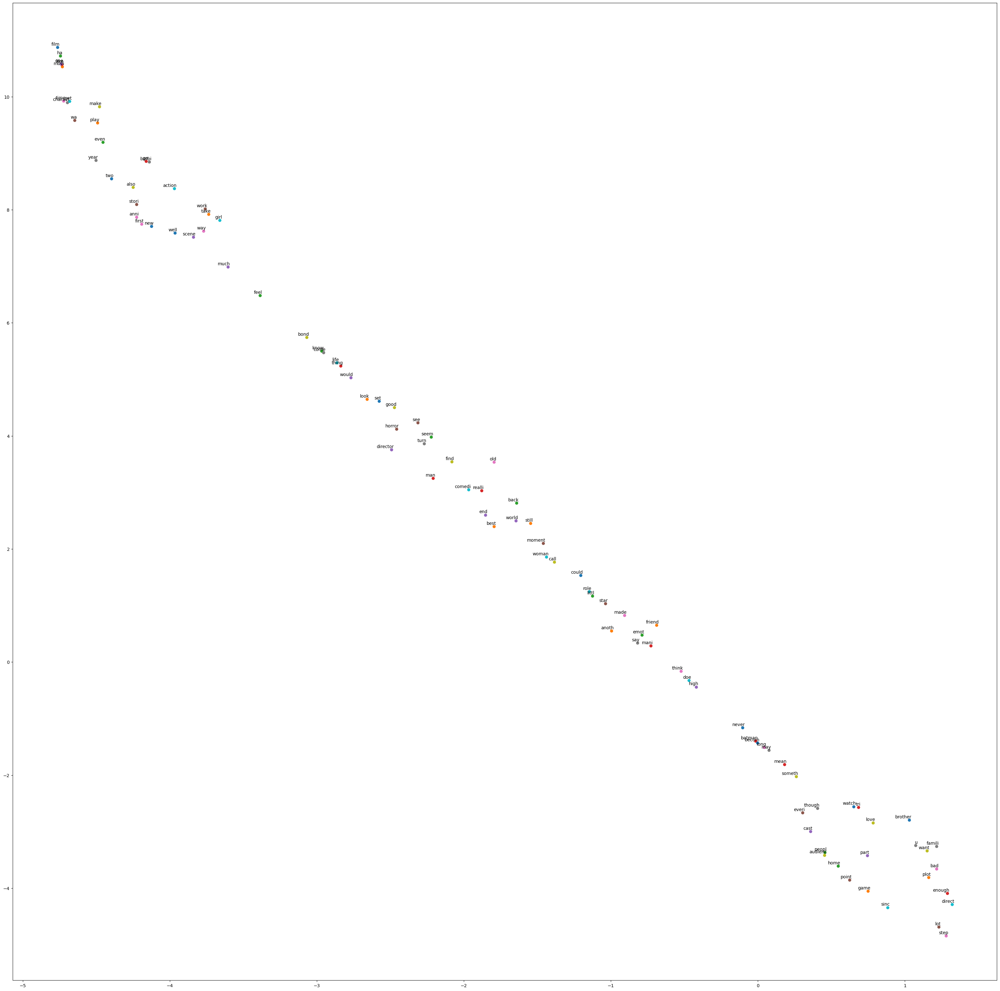

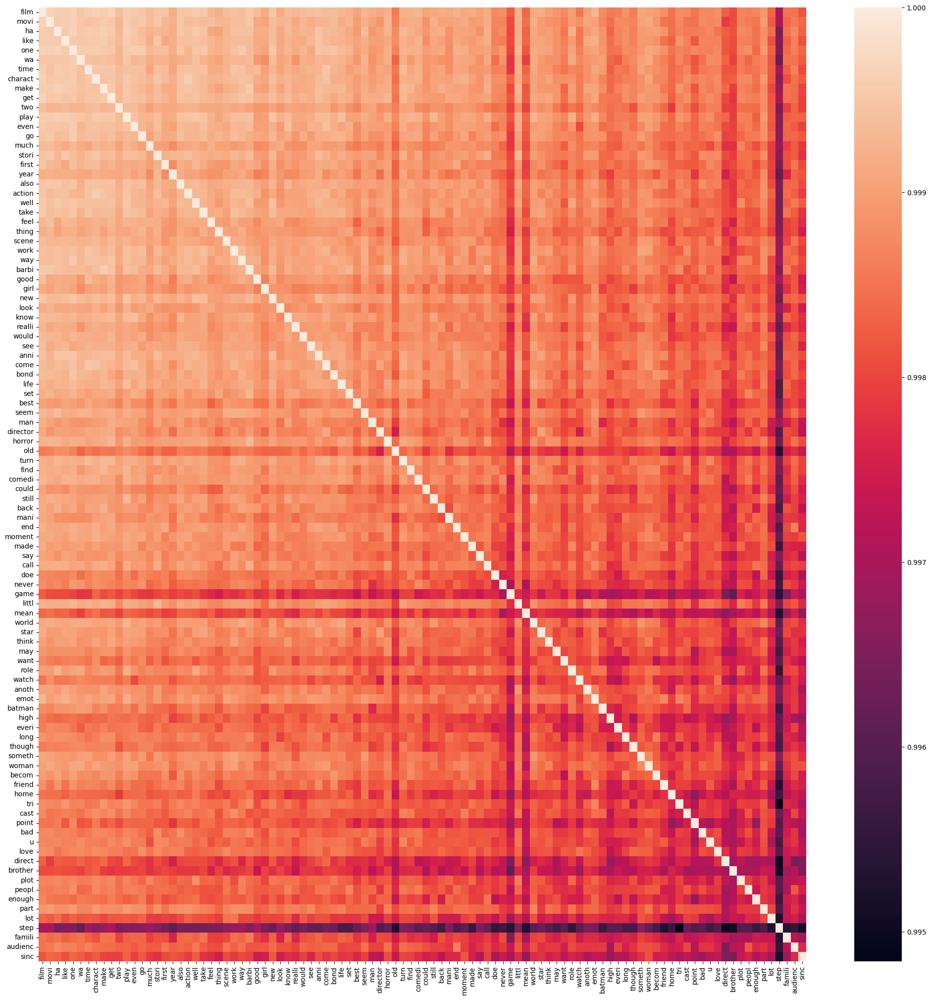

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


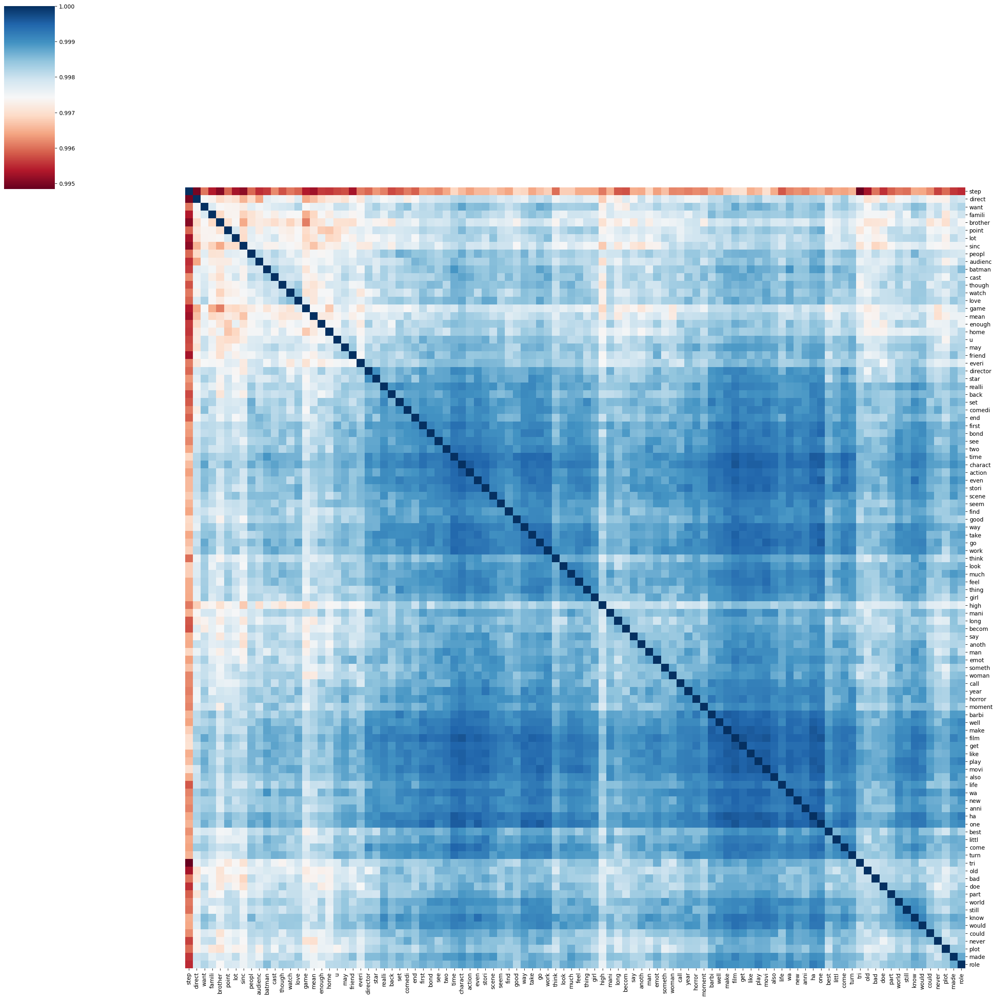

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


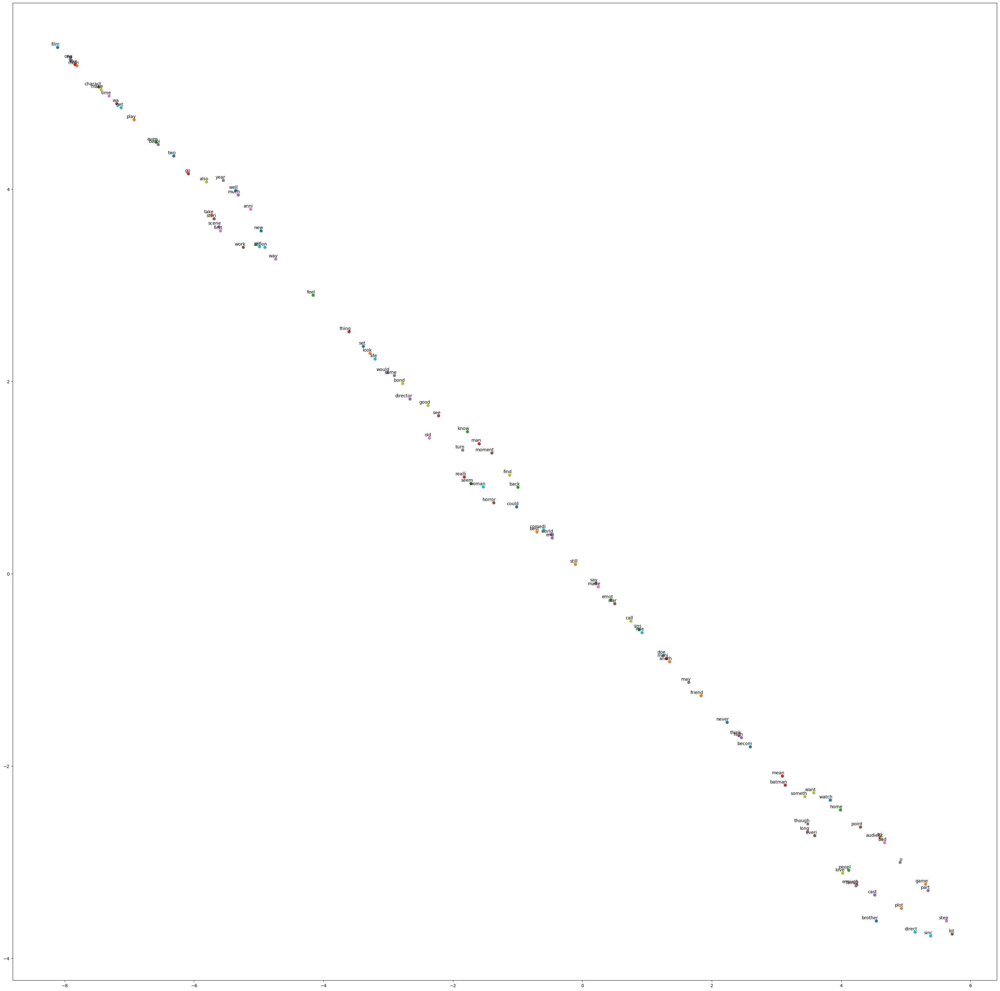

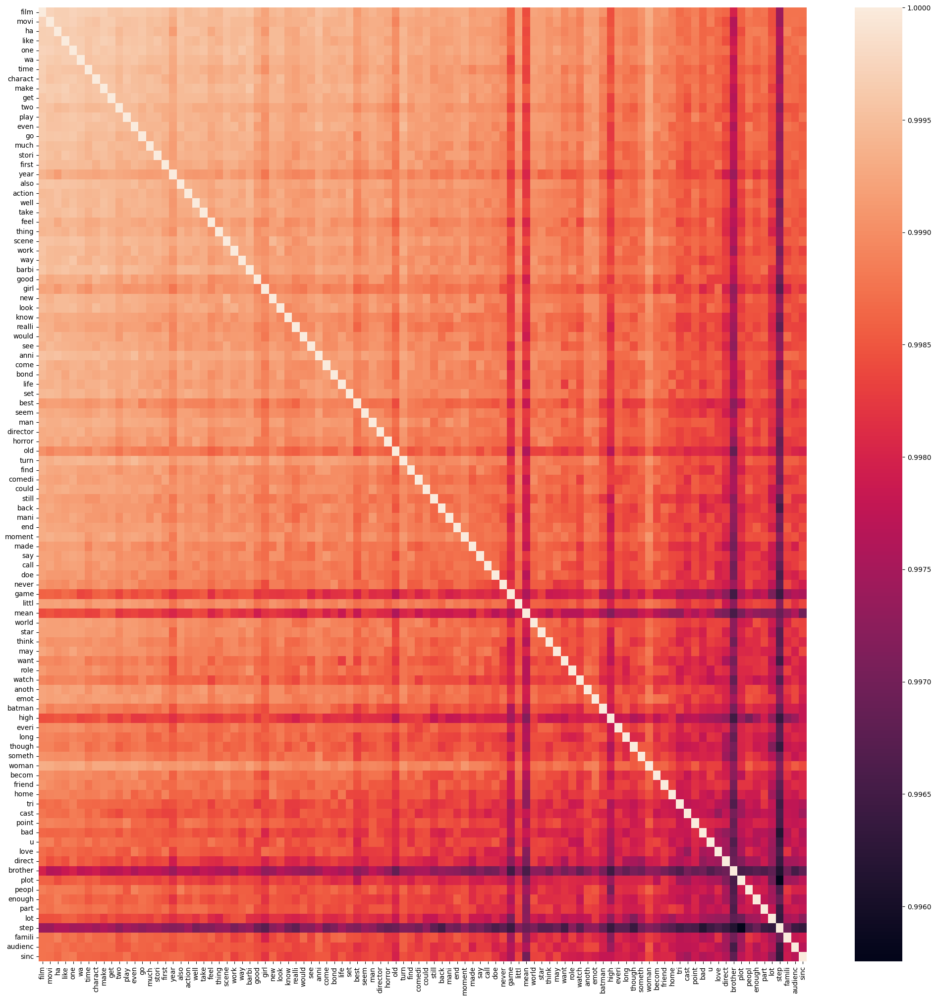

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


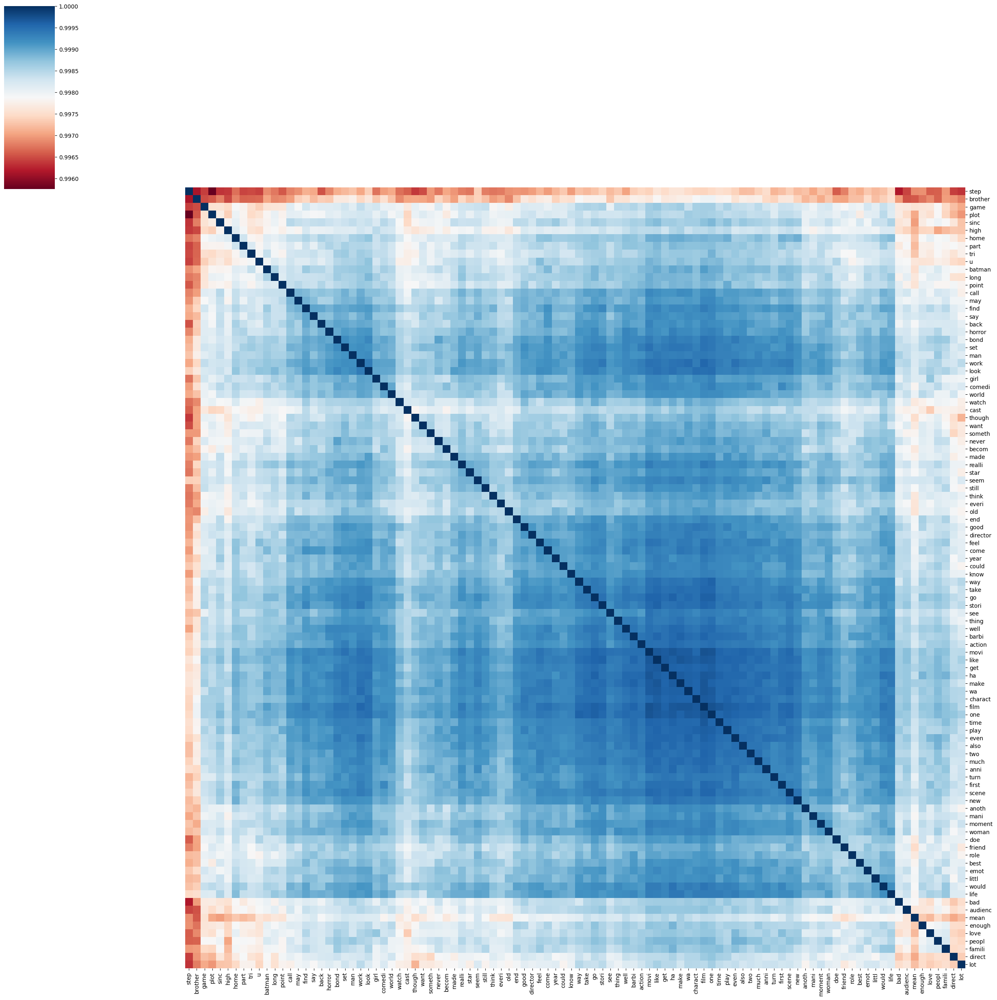

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


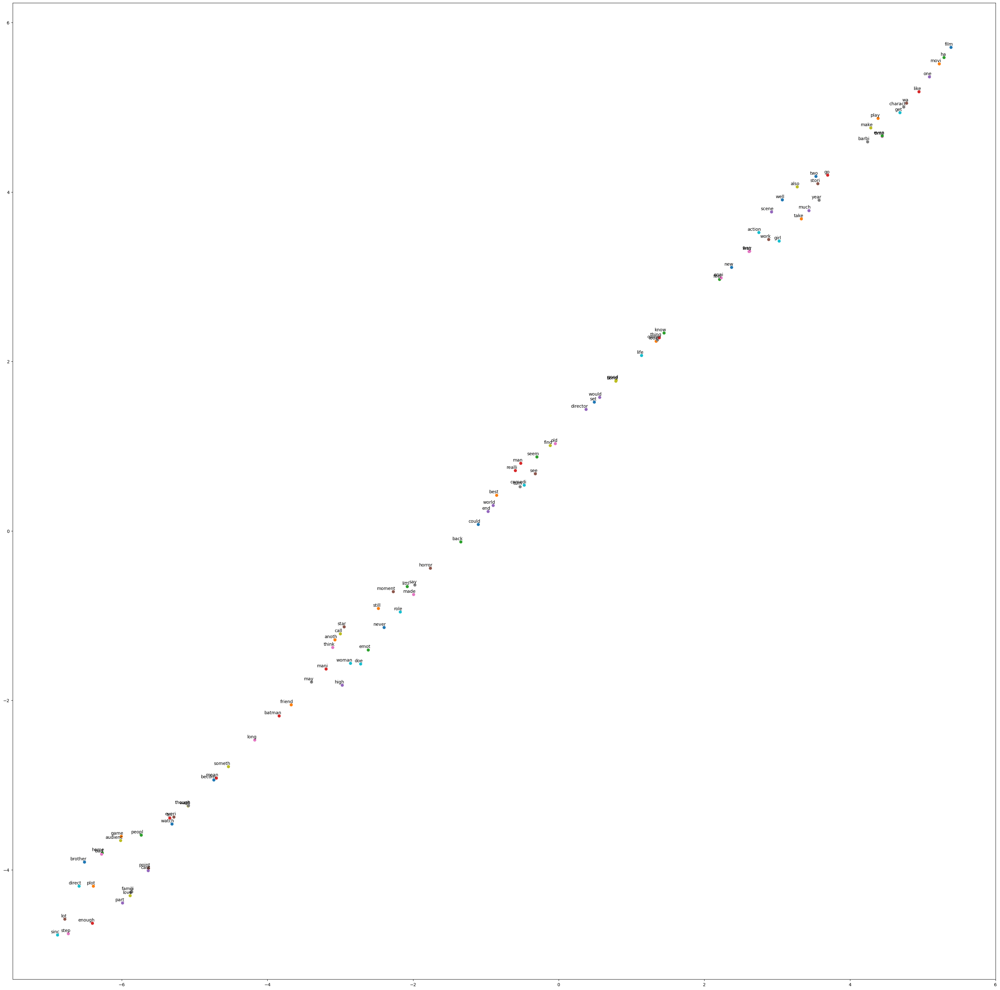

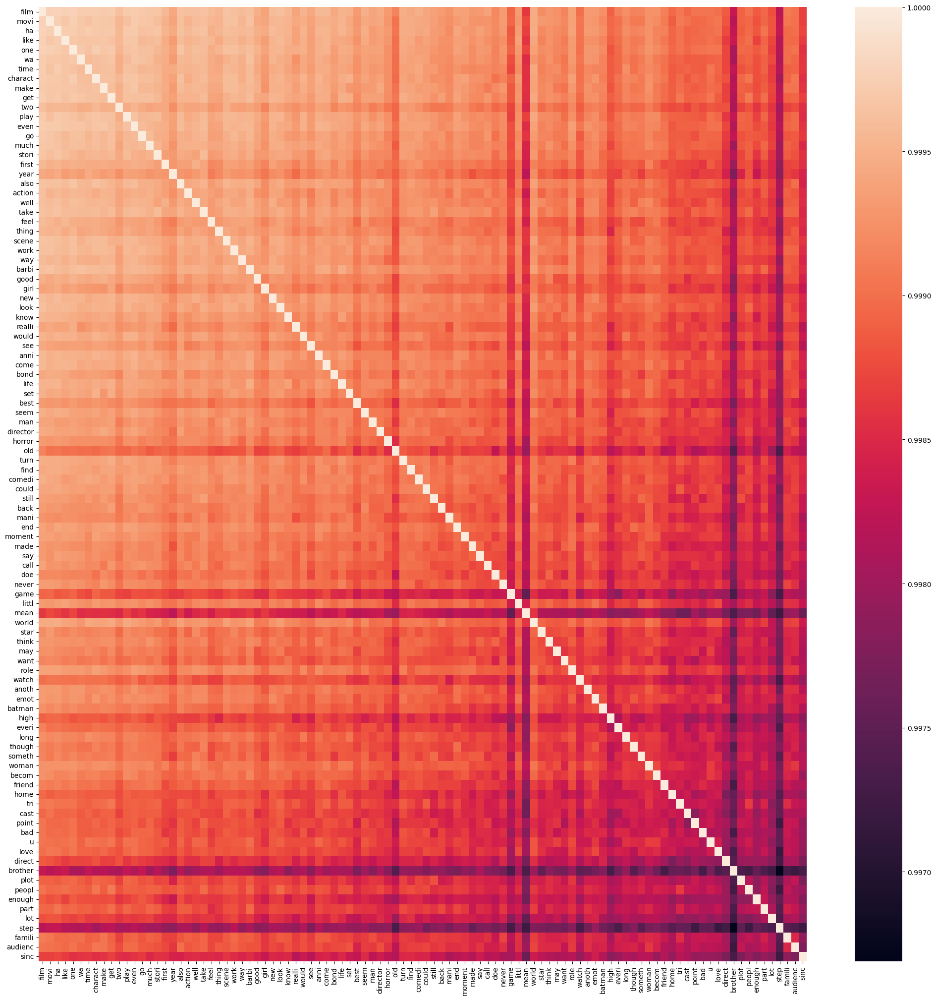

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


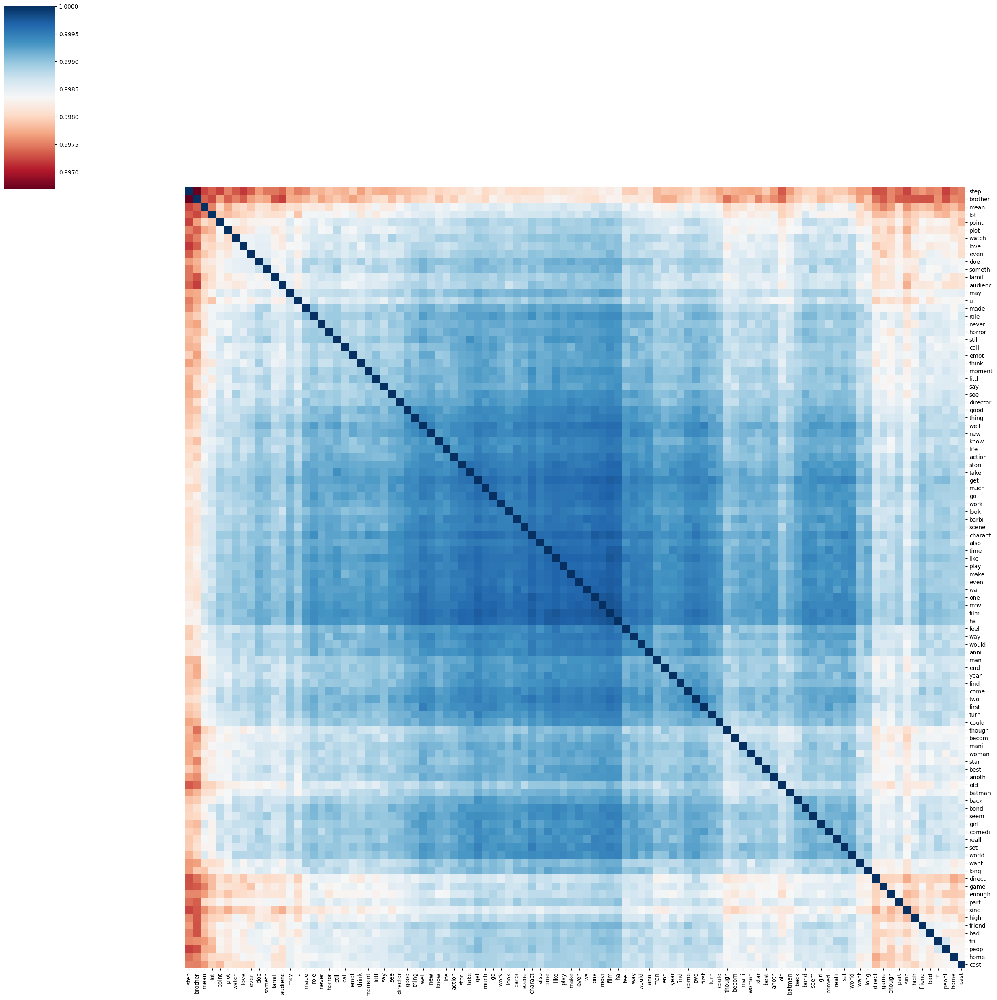

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


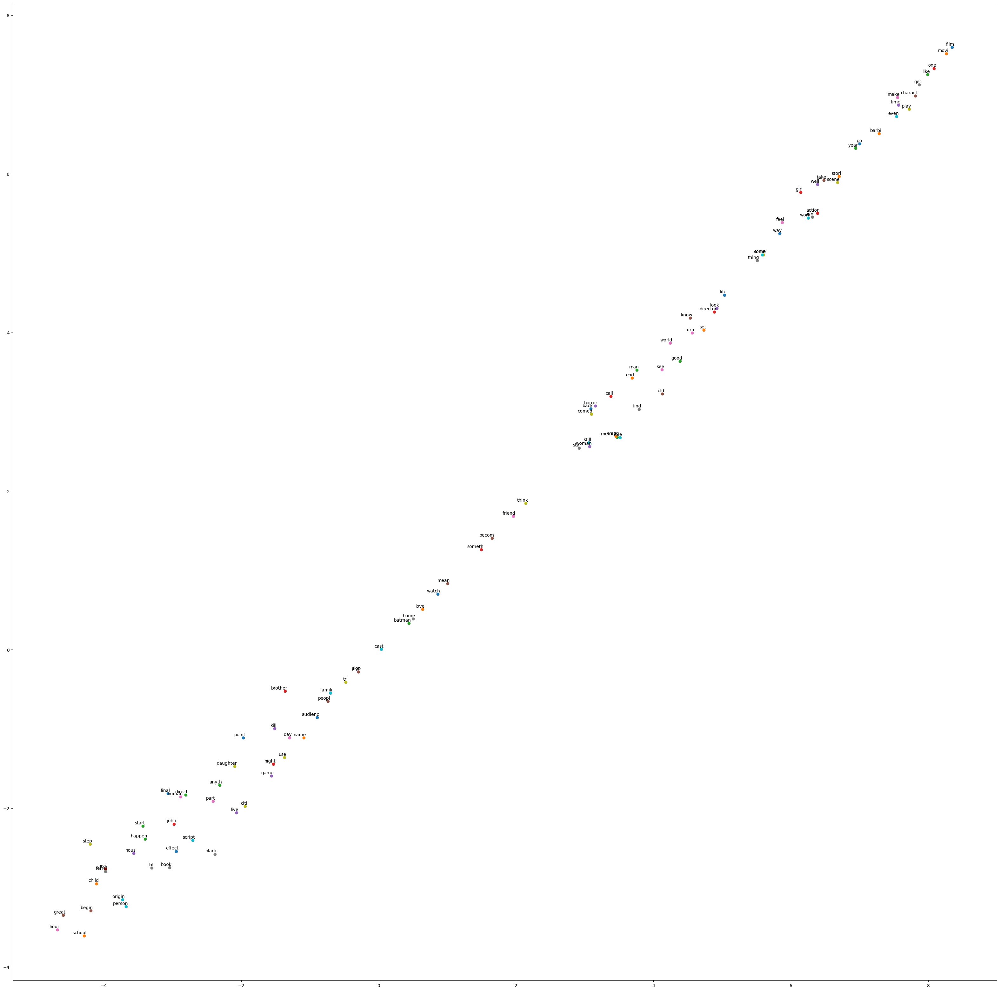

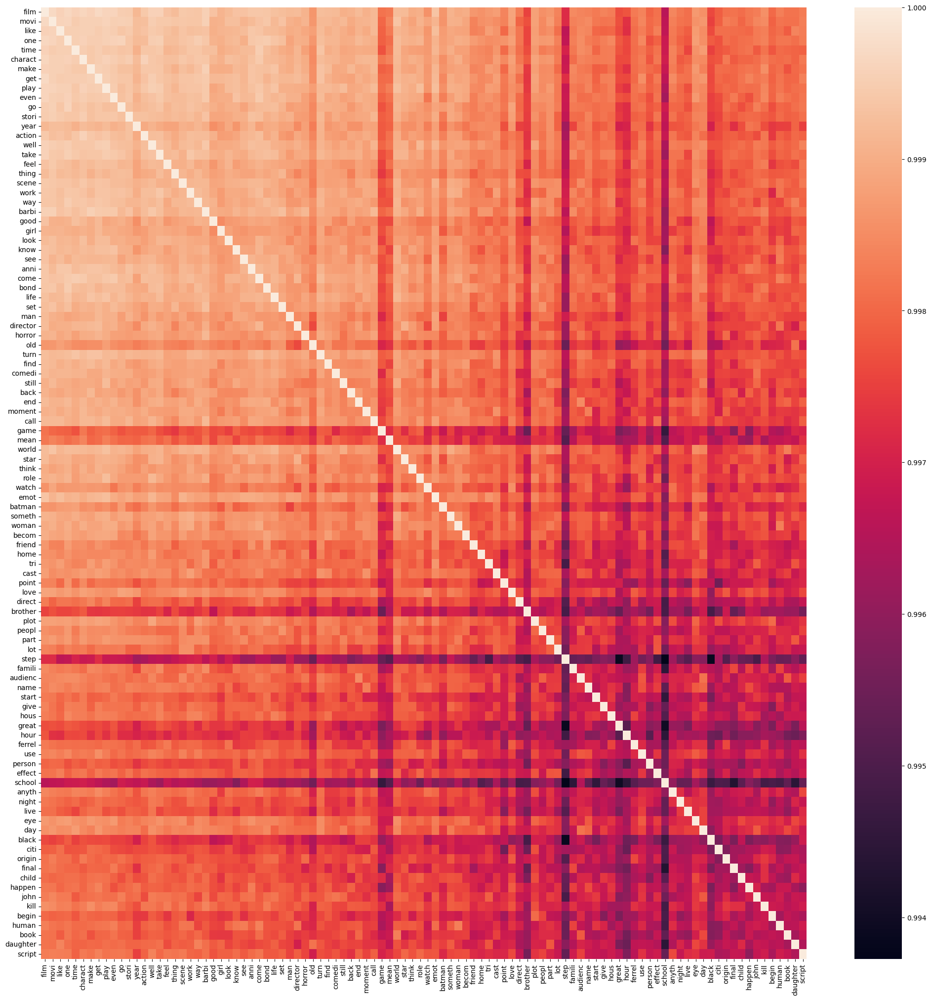

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


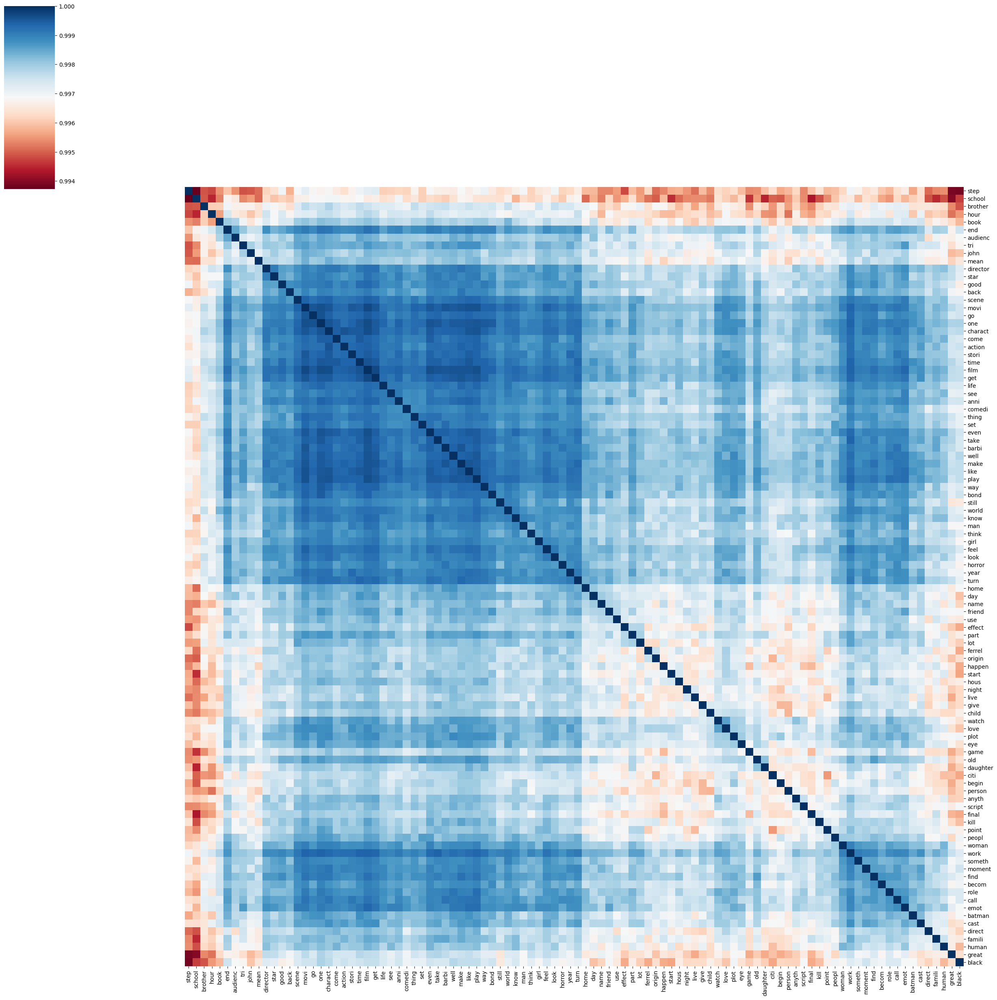

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


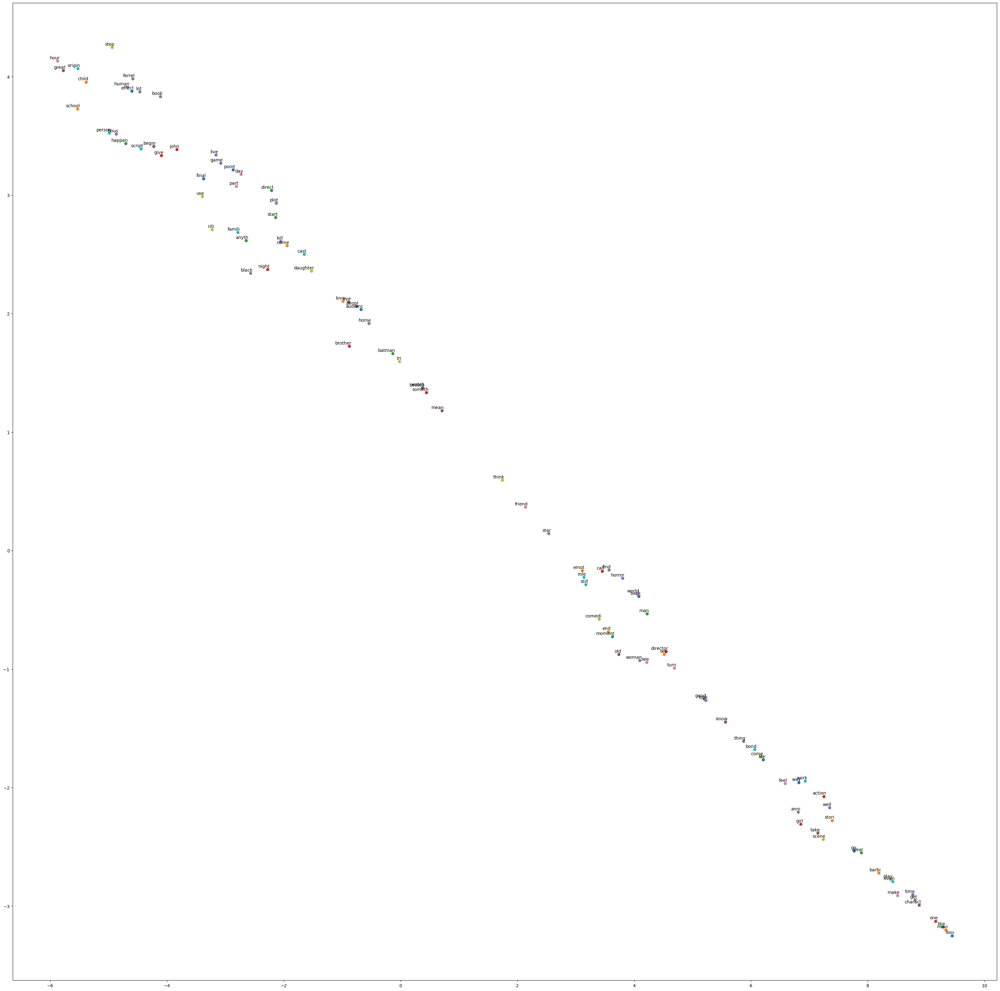

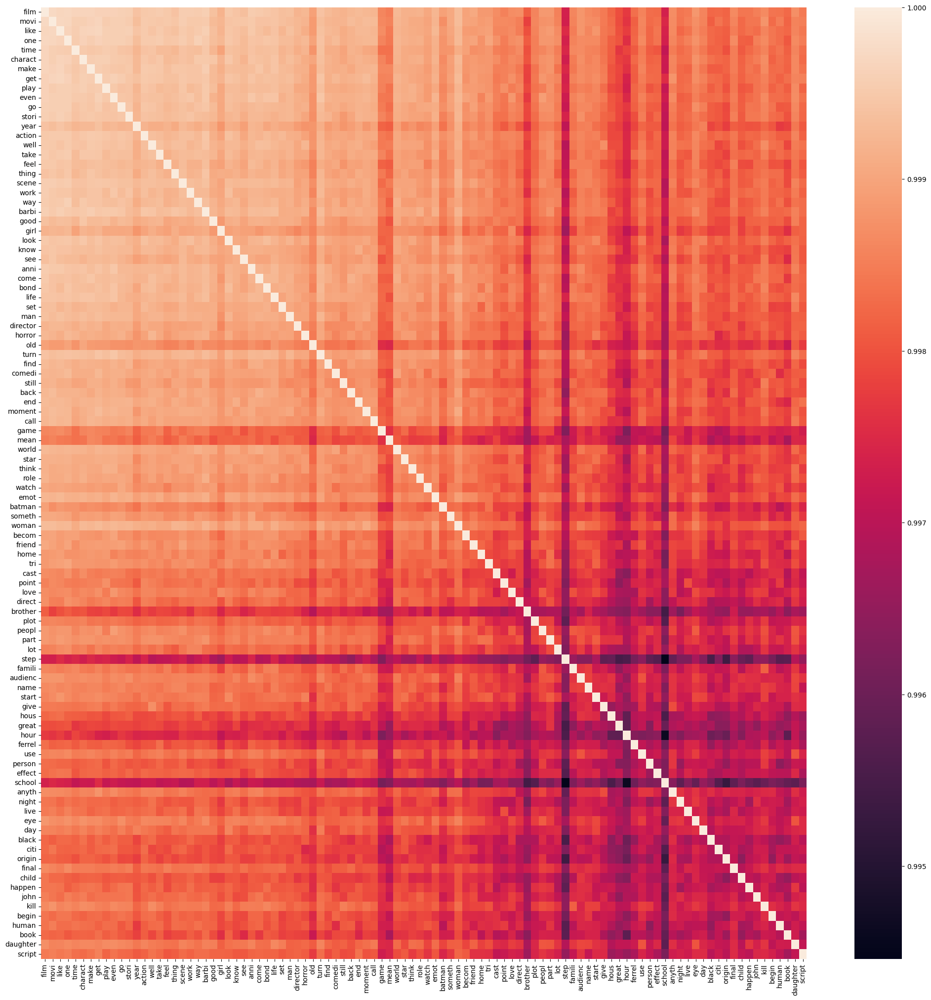

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


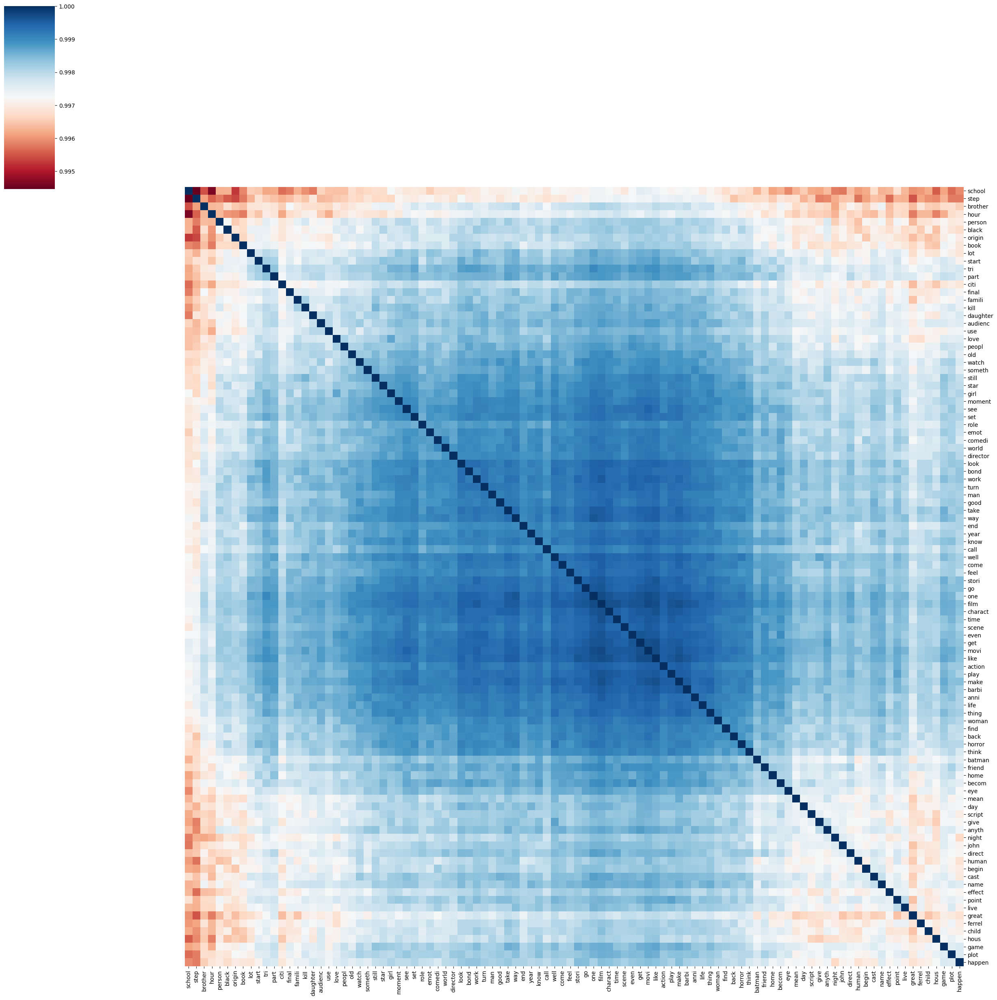

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


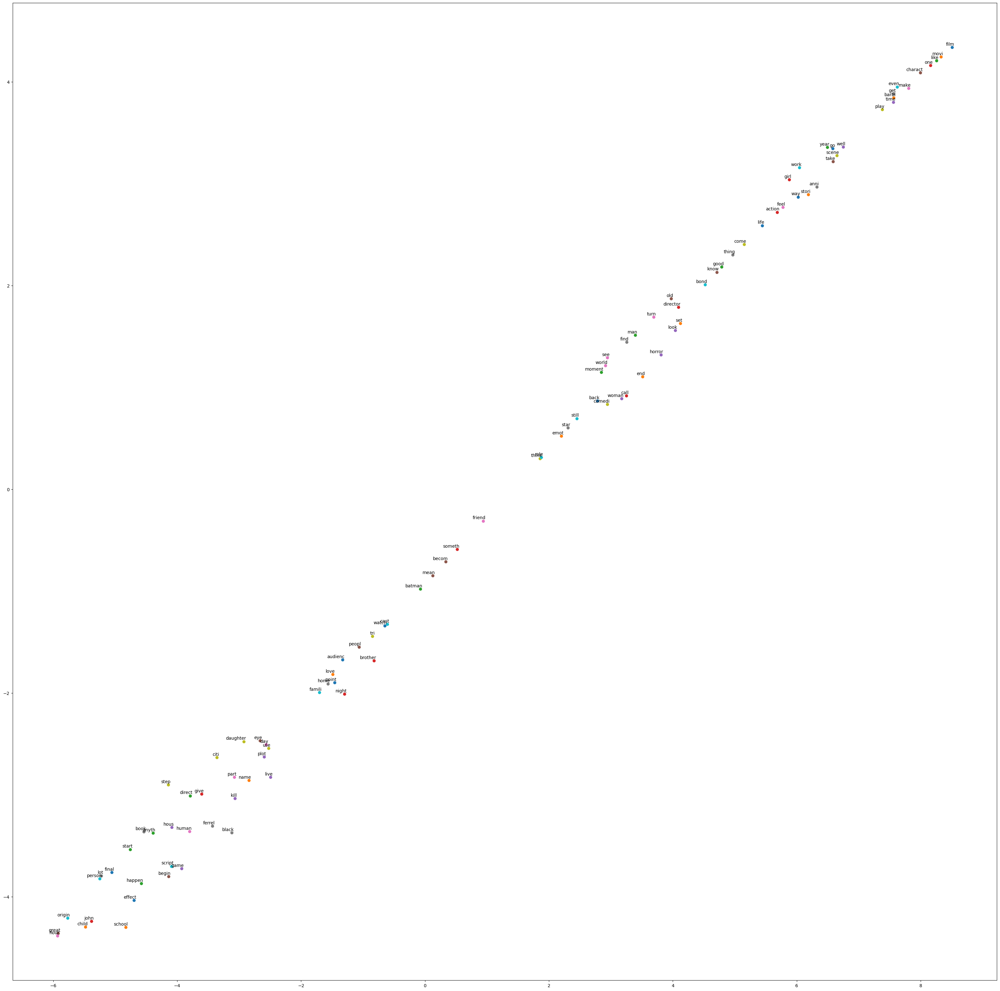

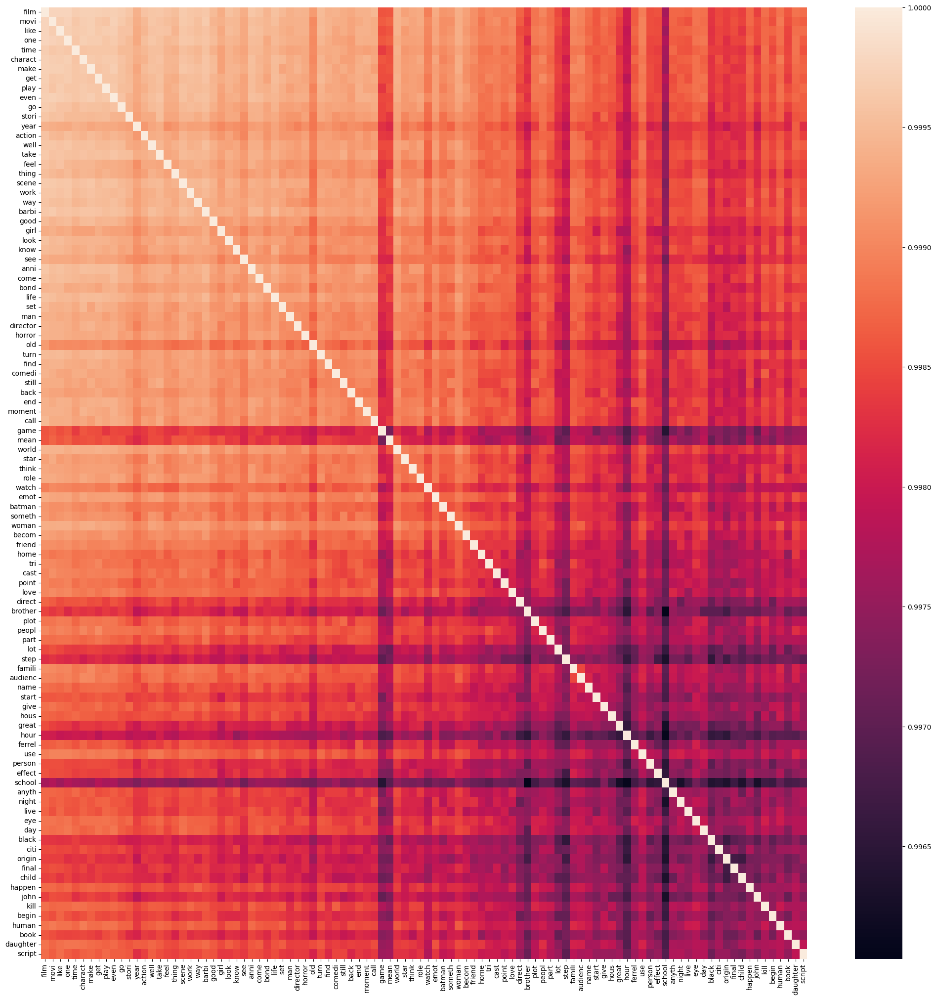

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


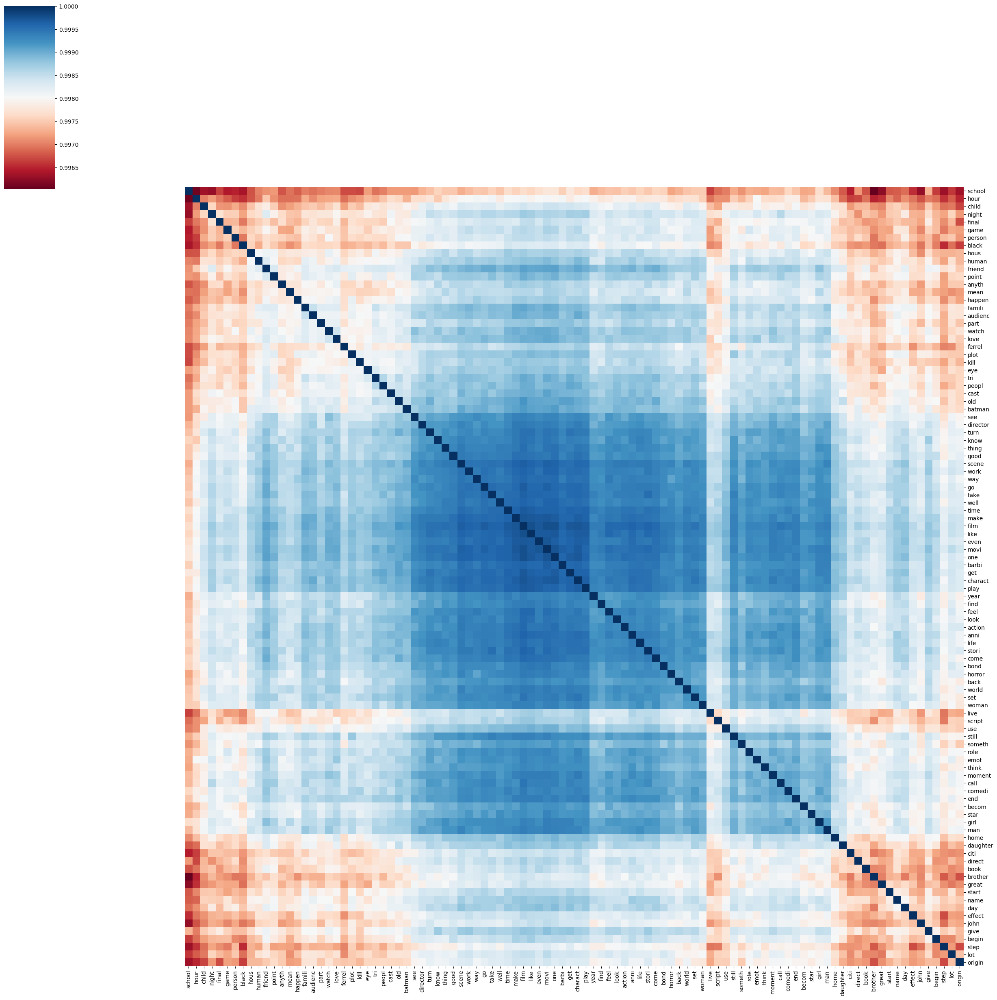

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


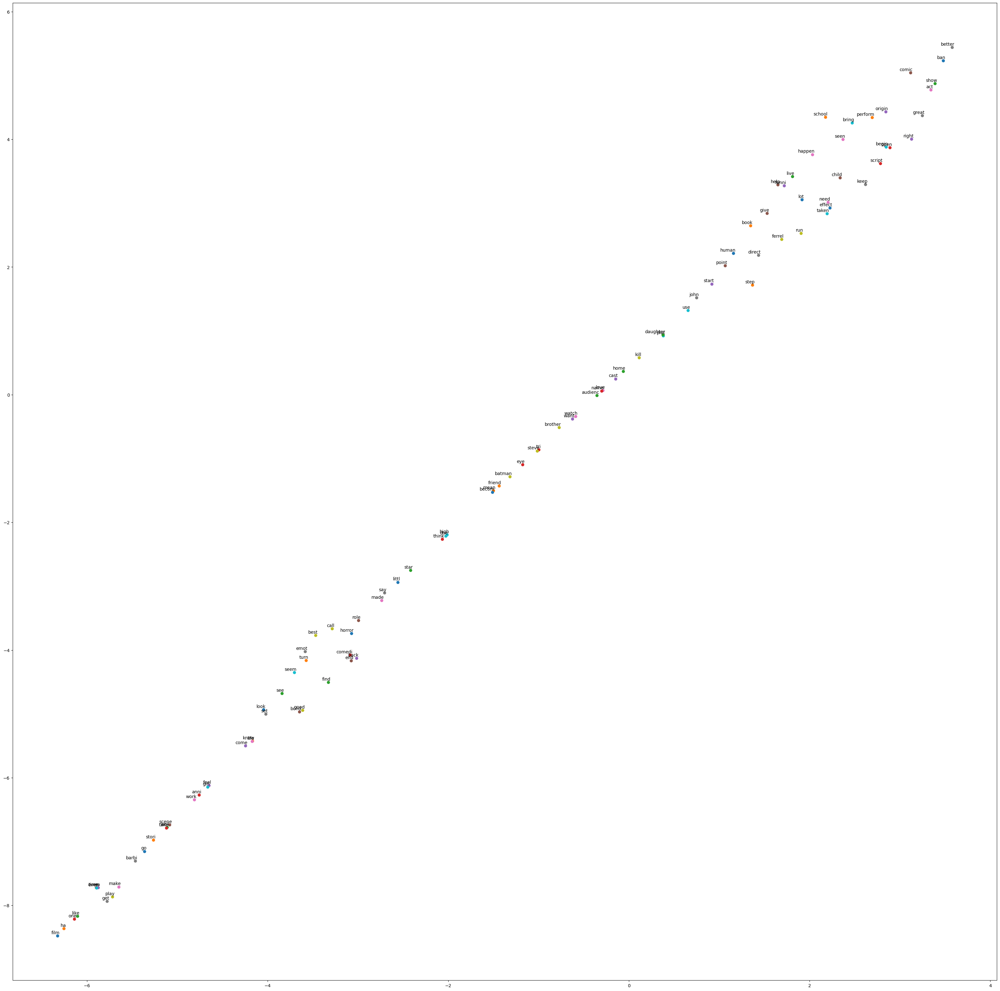

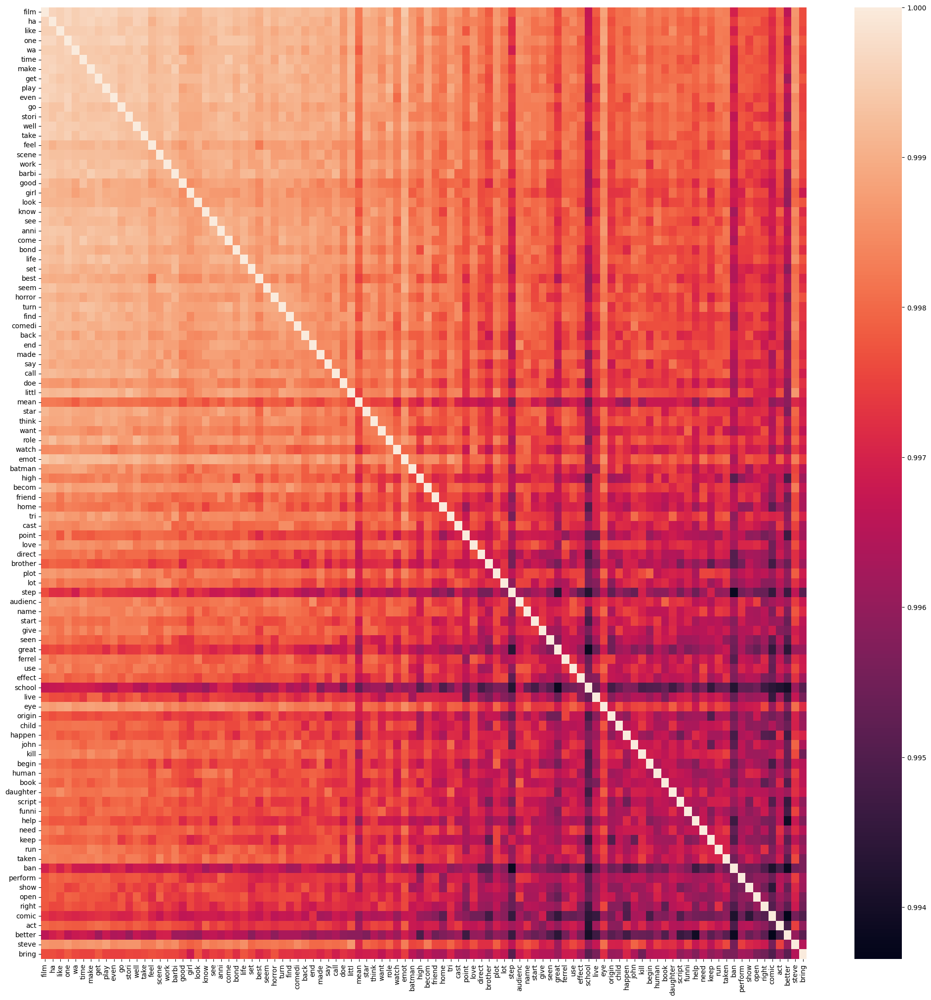

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


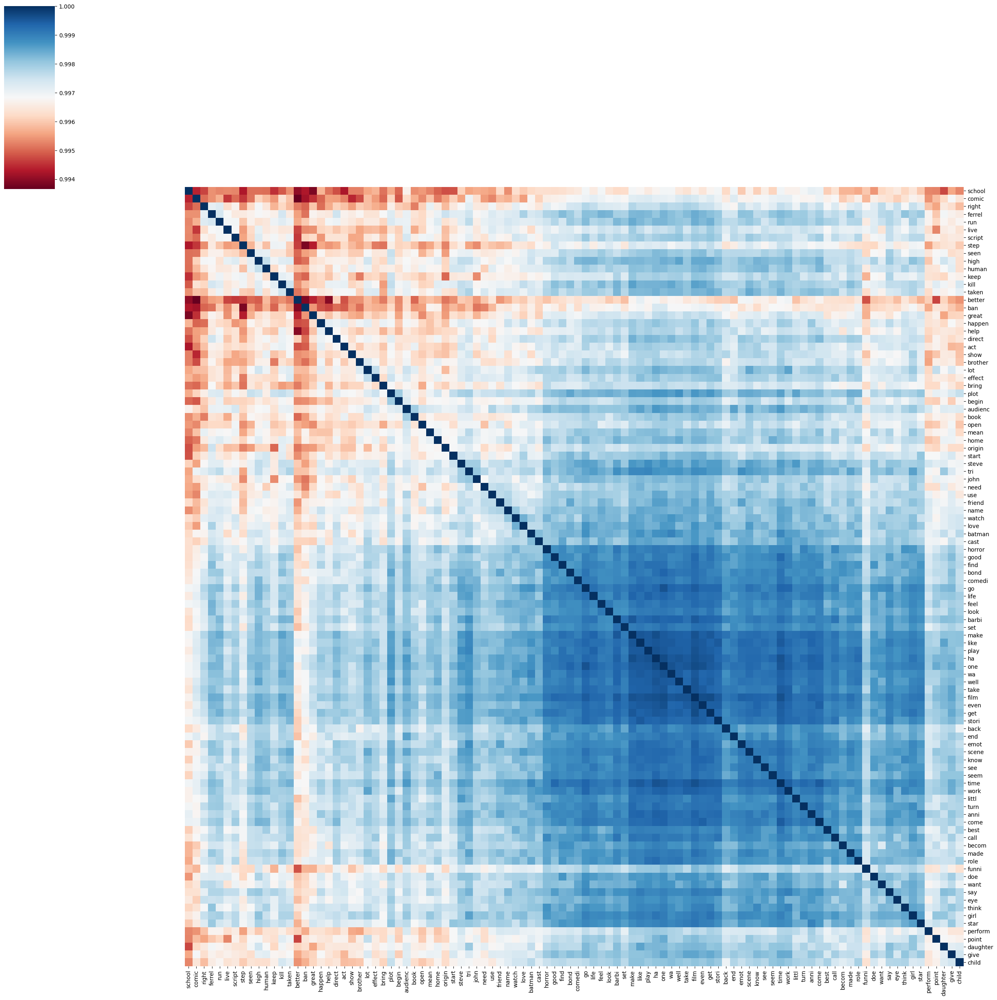

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


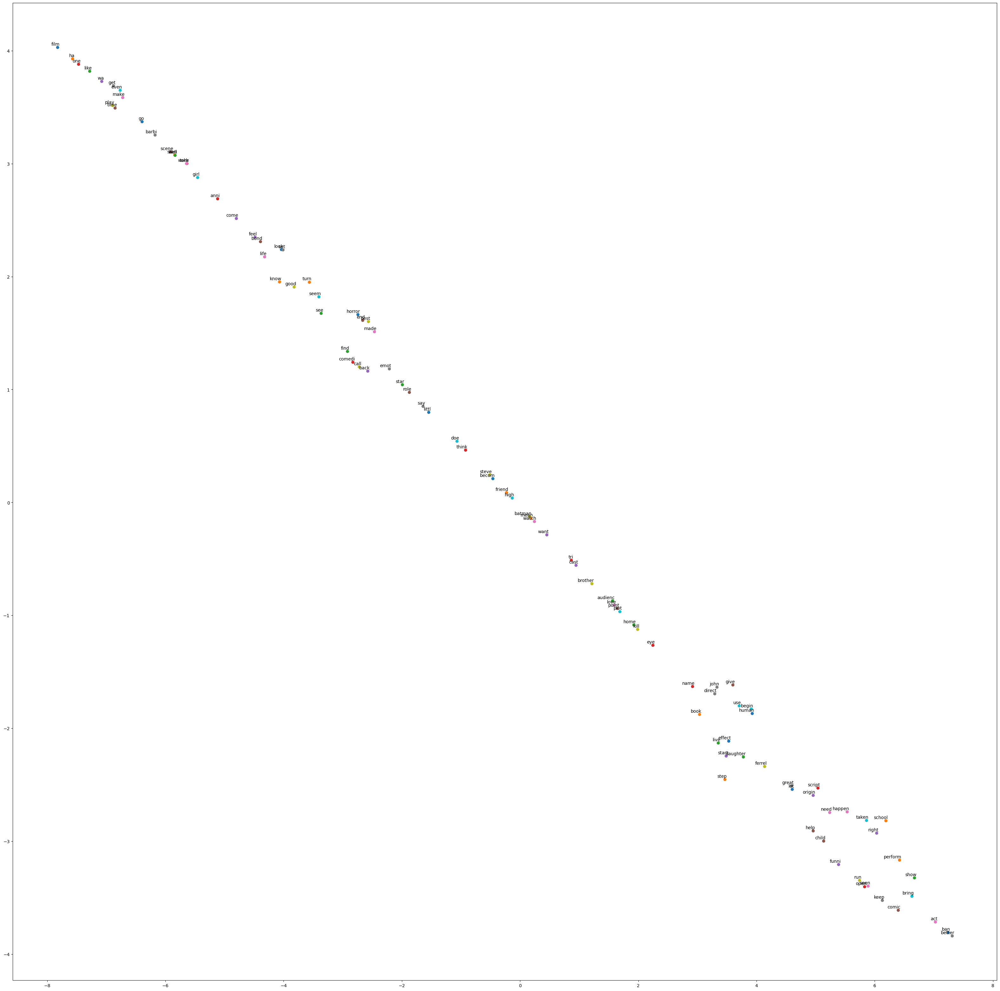

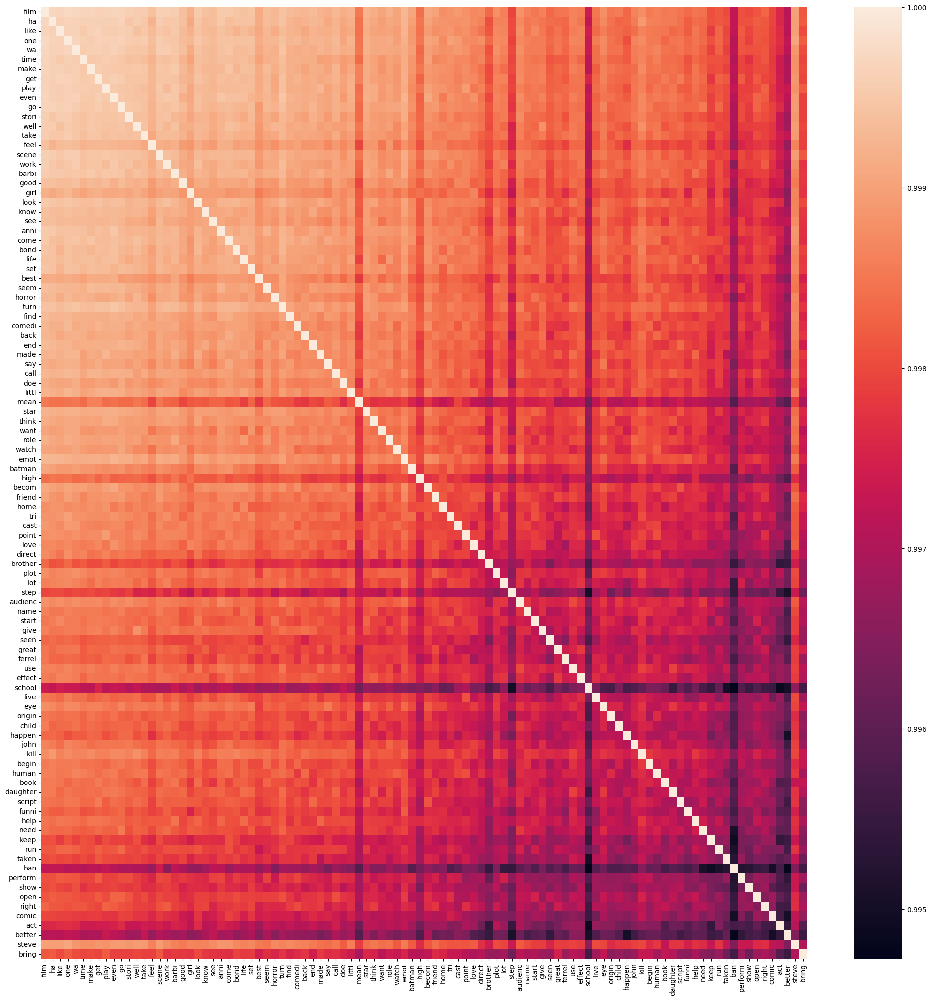

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


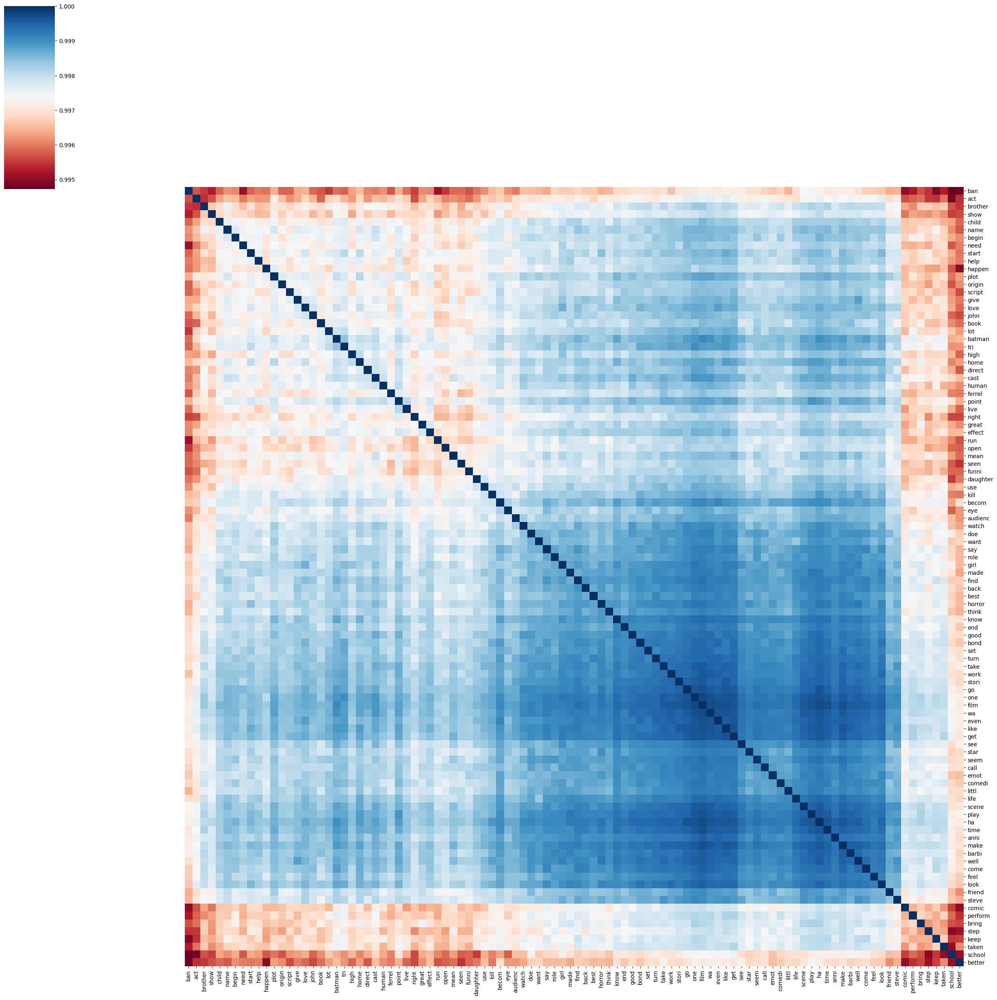

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


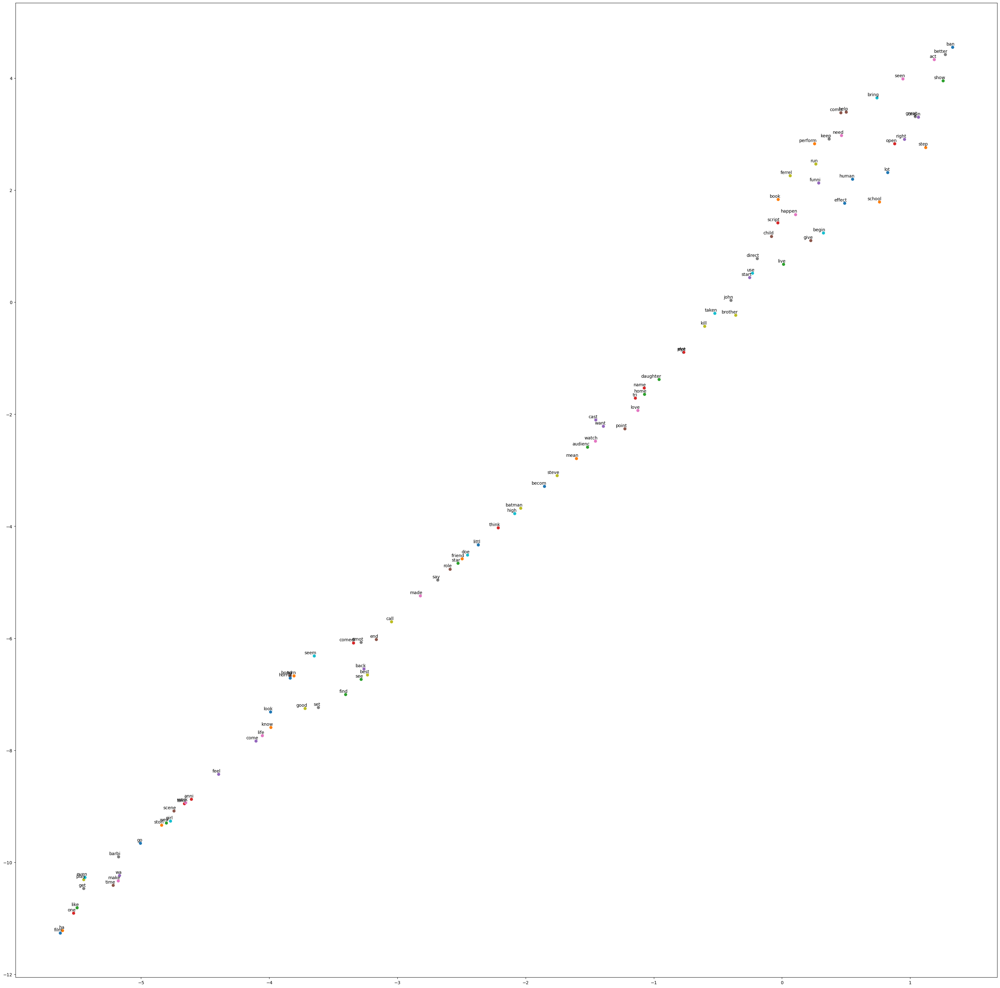

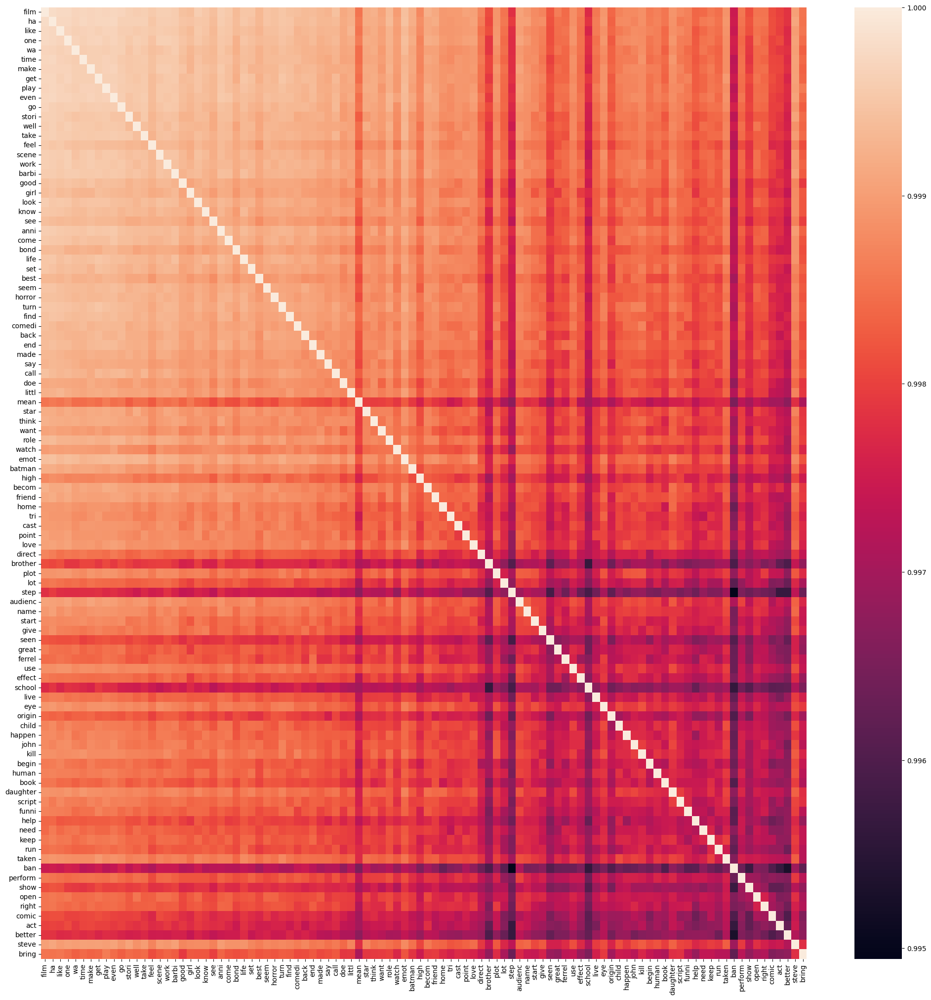

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


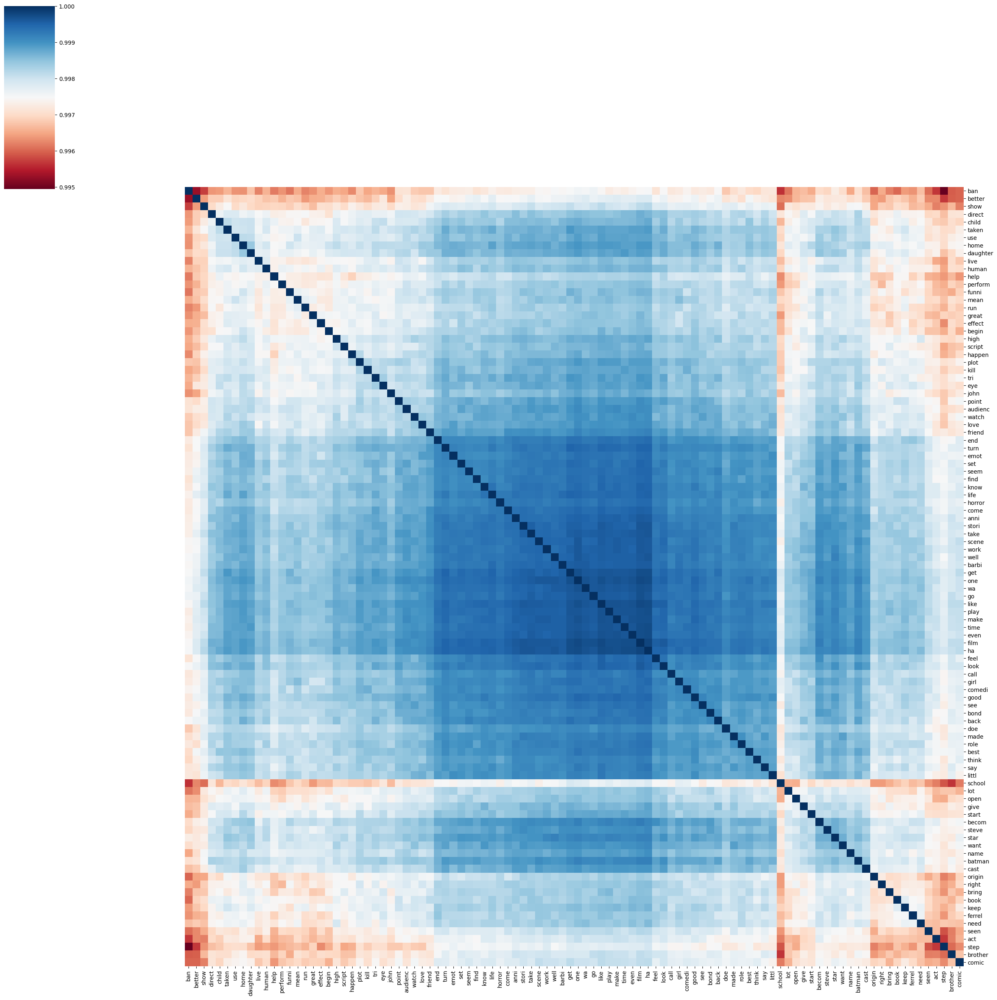

In [ ]:

# Run ALL Word2Vec Experiments


# Most Common tokens
run_word2vec_experiment(documents, clean_method, 100, tokens_most_common, "W2V_most_common_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_most_common, "W2V_most_common_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_most_common, "W2V_most_common_300d")

# Nouns only
run_word2vec_experiment(documents, clean_method, 100, tokens_nouns, "W2V_nouns_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_nouns, "W2V_nouns_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_nouns, "W2V_nouns_300d")

# Verbs only
run_word2vec_experiment(documents, clean_method, 100, tokens_verbs, "W2V_verbs_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_verbs, "W2V_verbs_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_verbs, "W2V_verbs_300d")


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


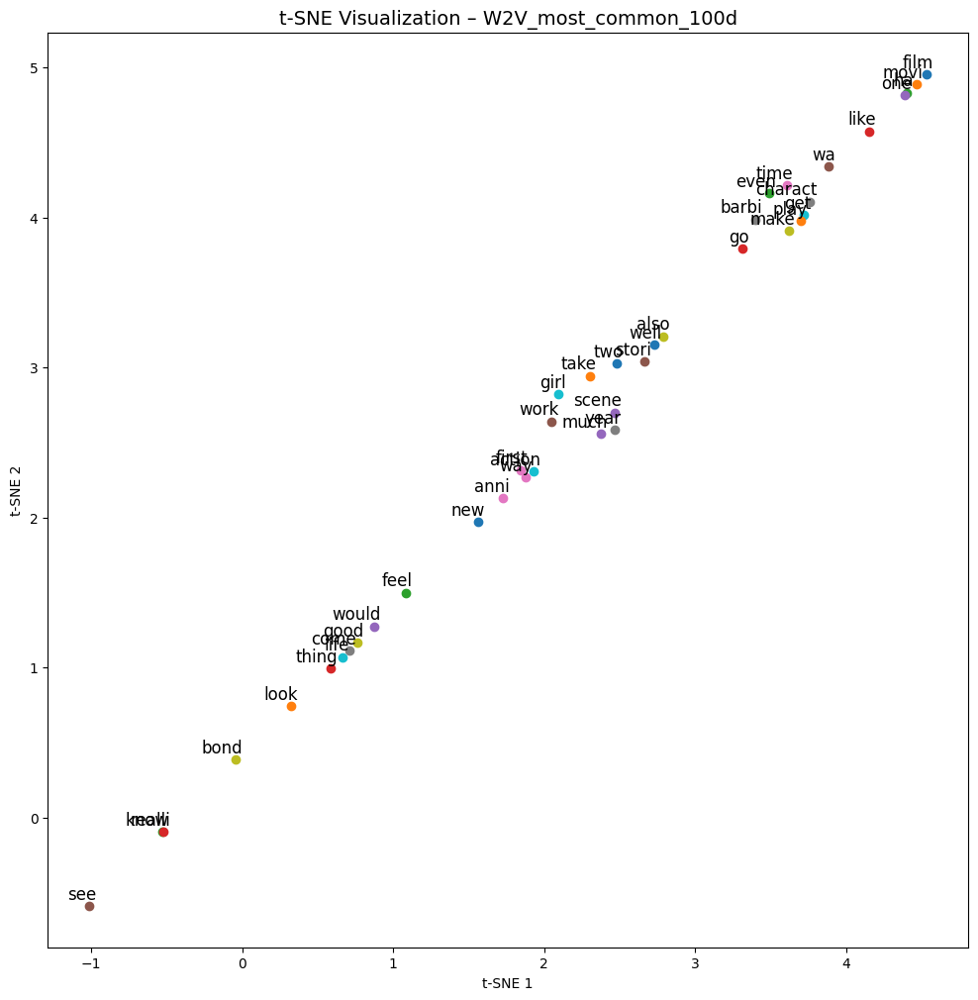

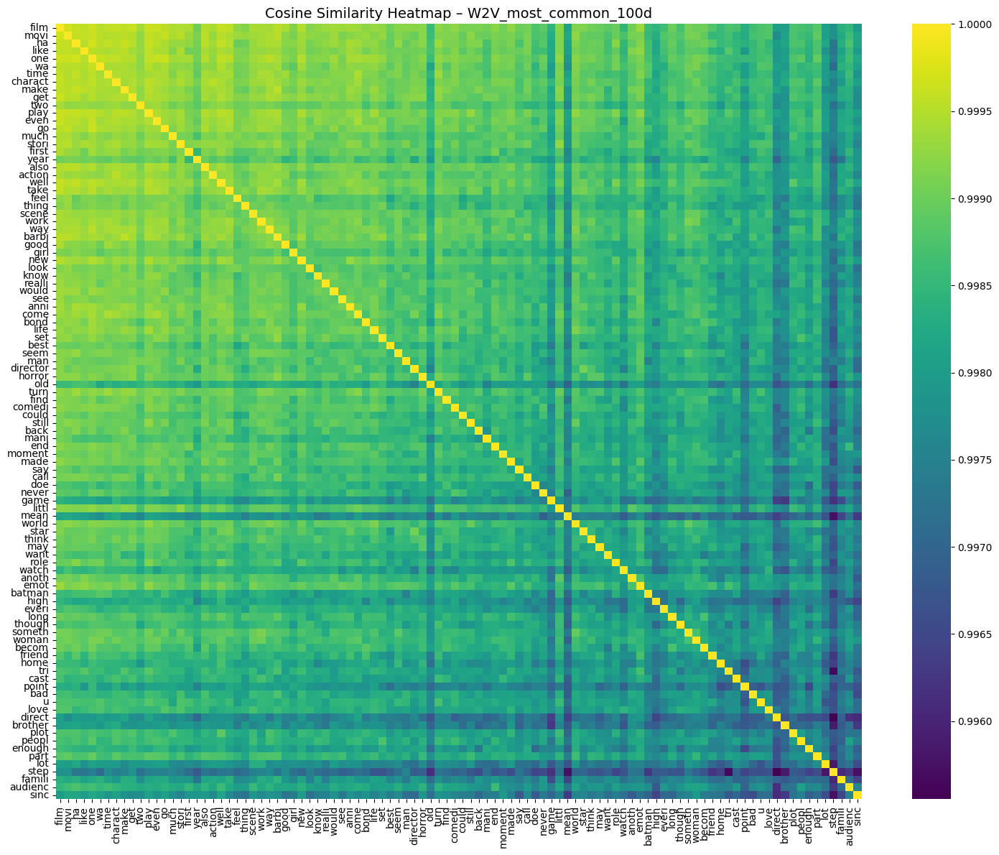

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


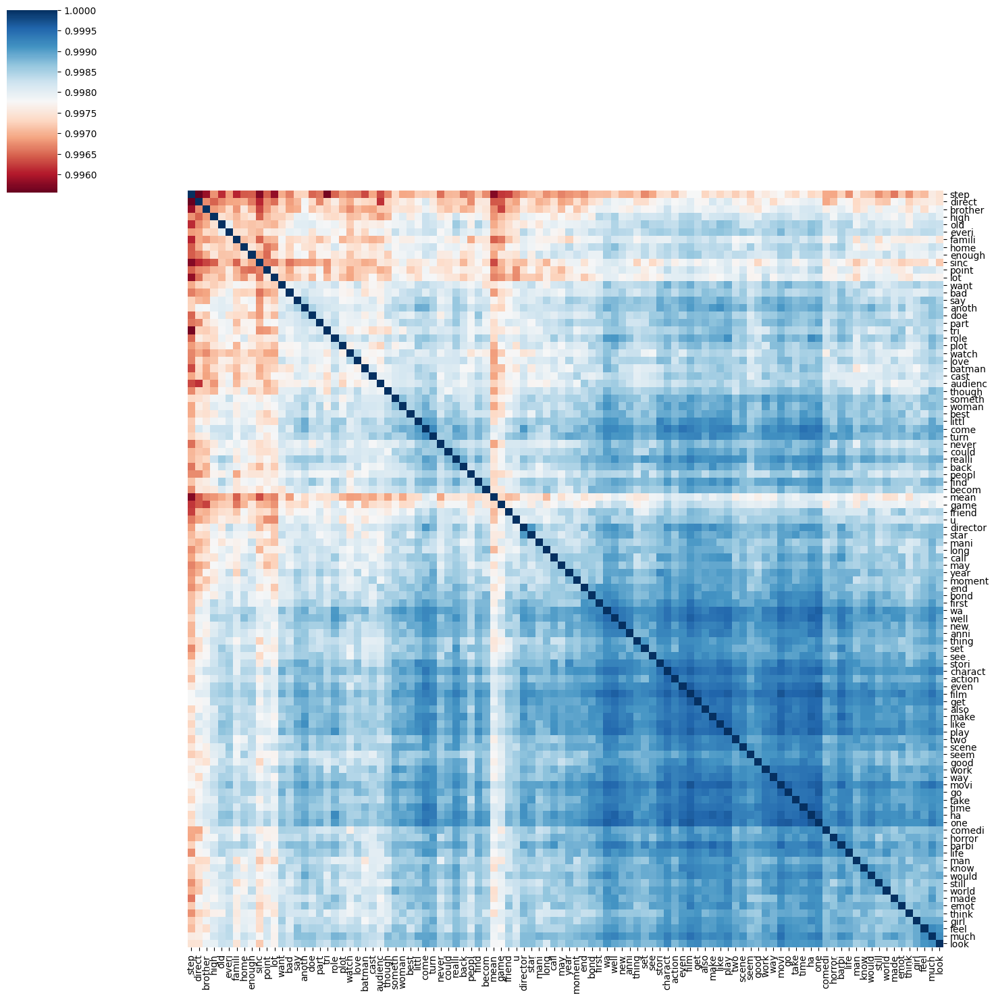

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


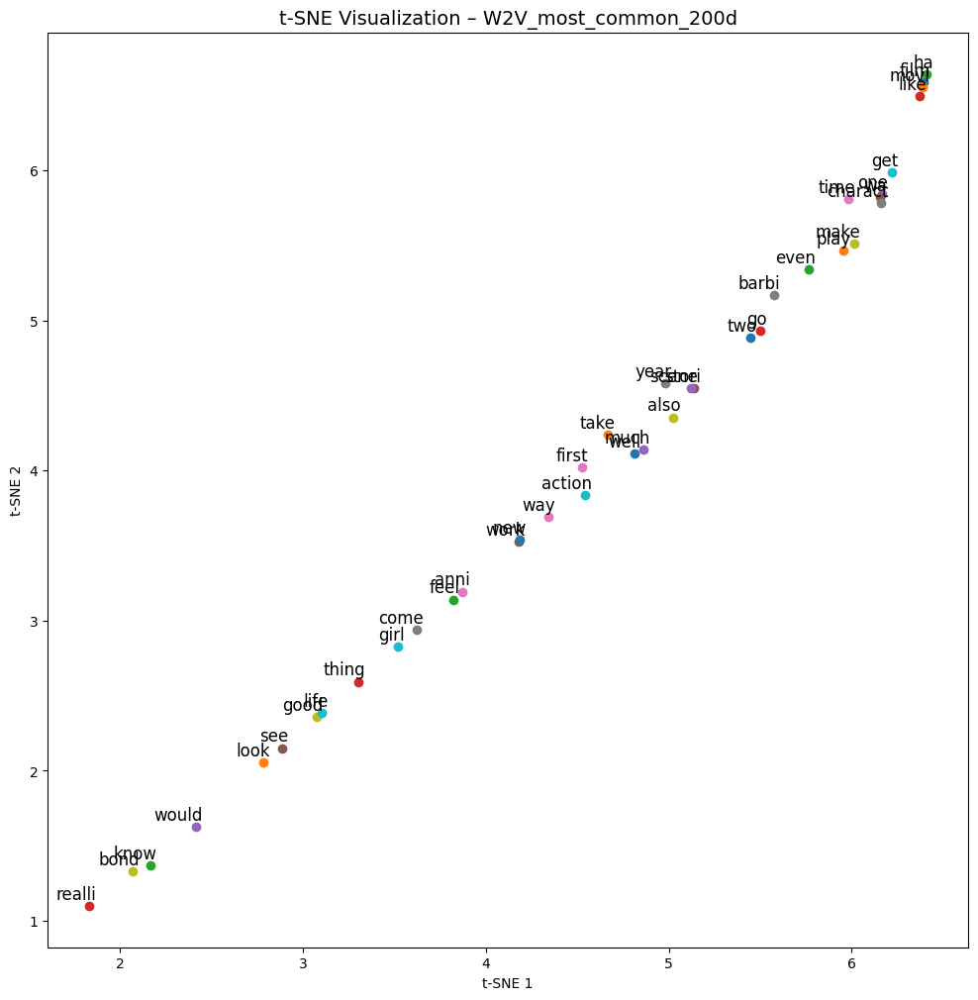

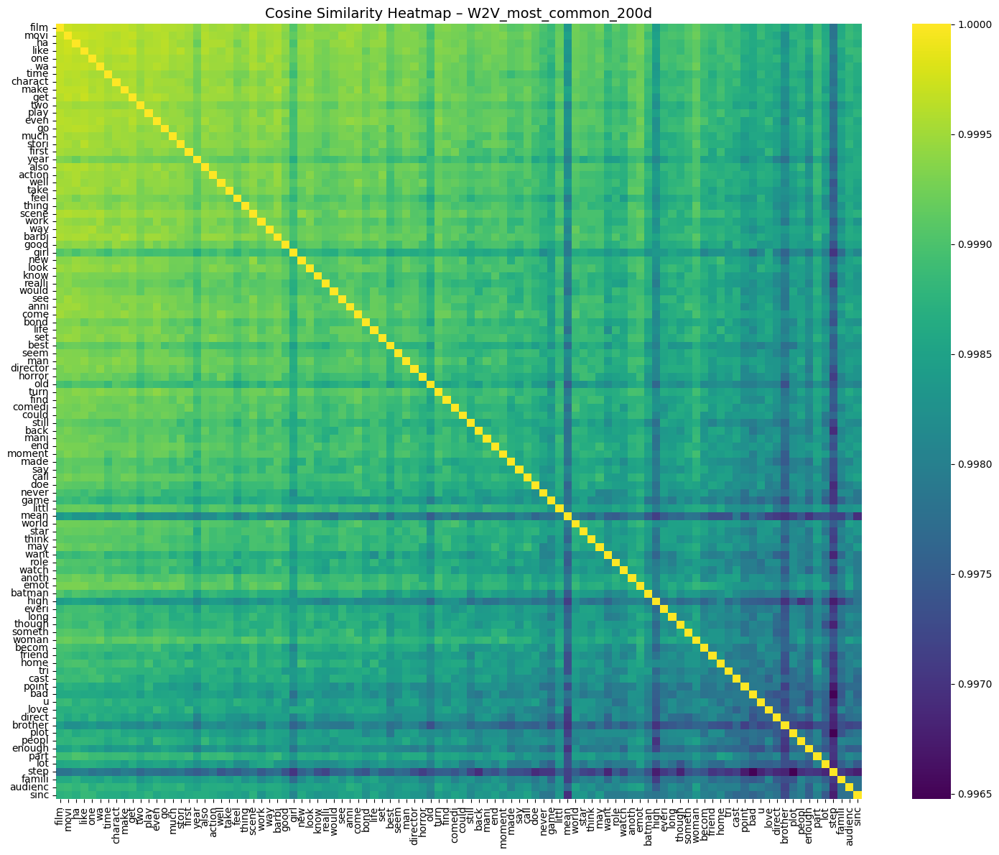

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


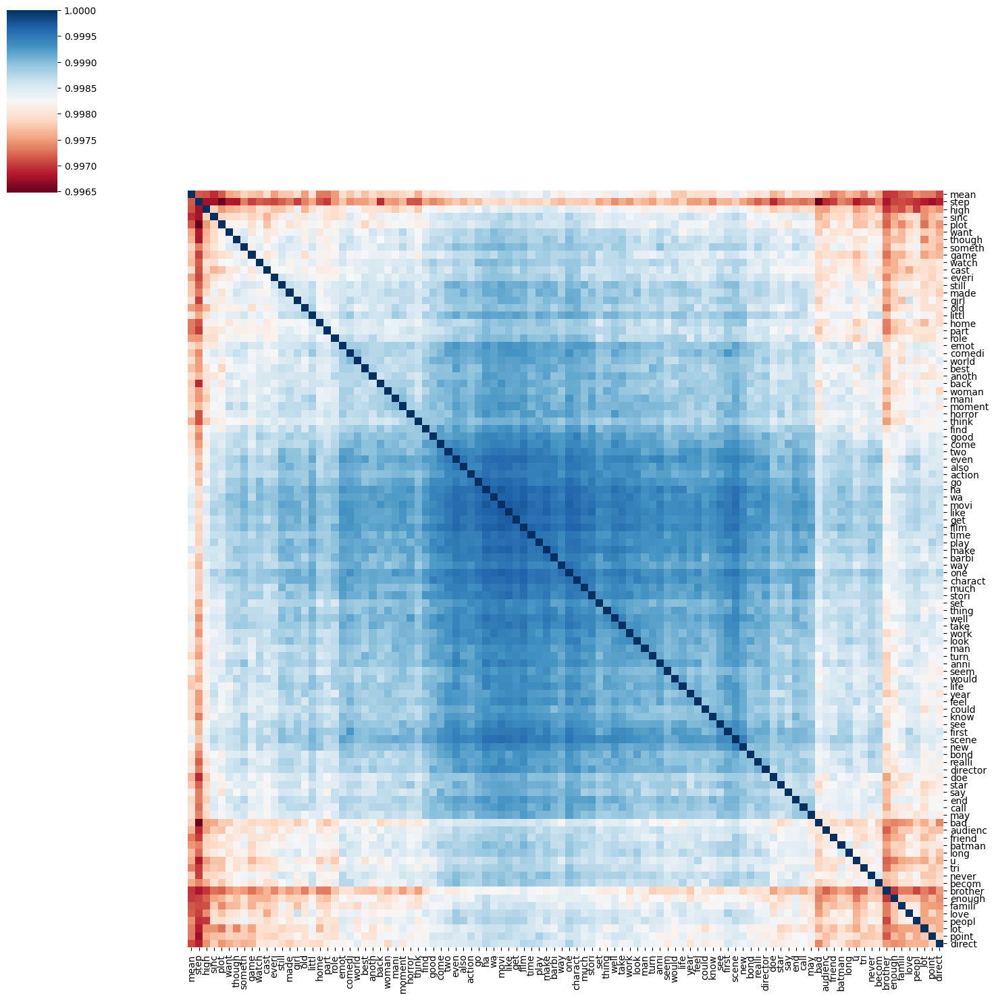

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


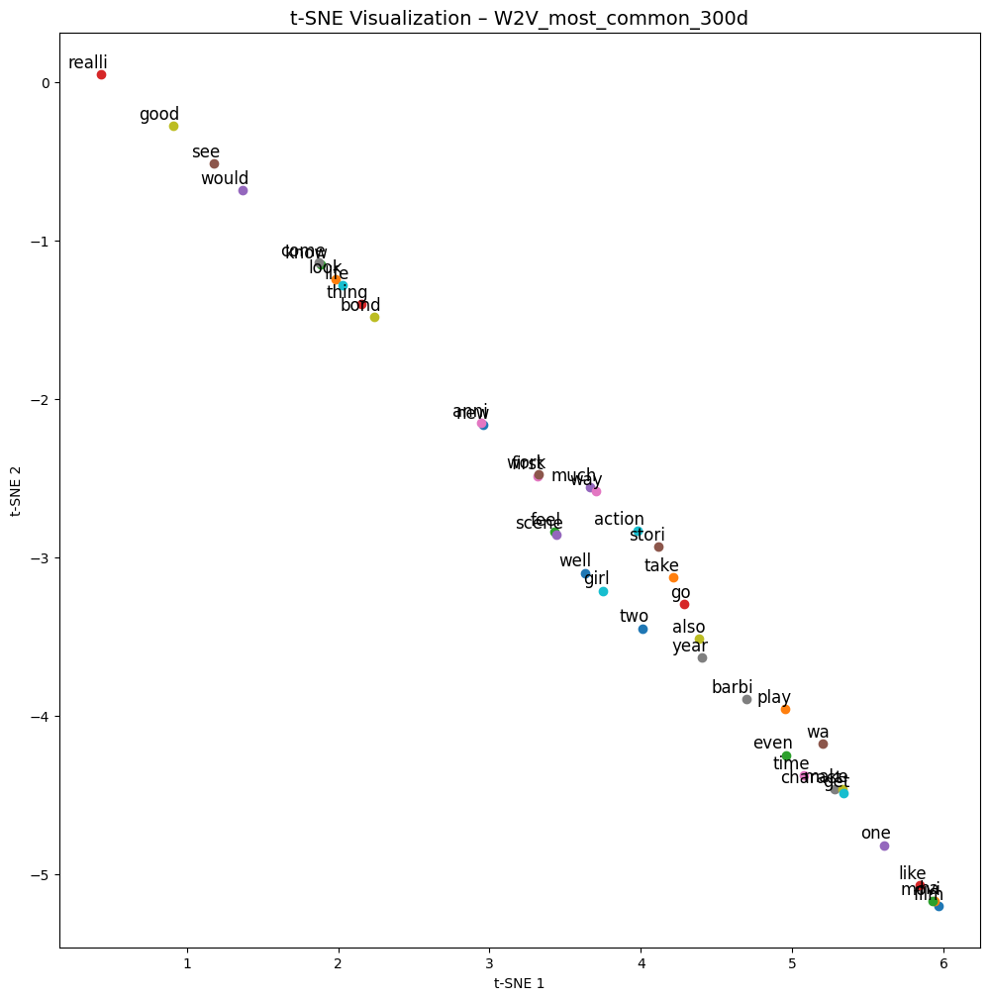

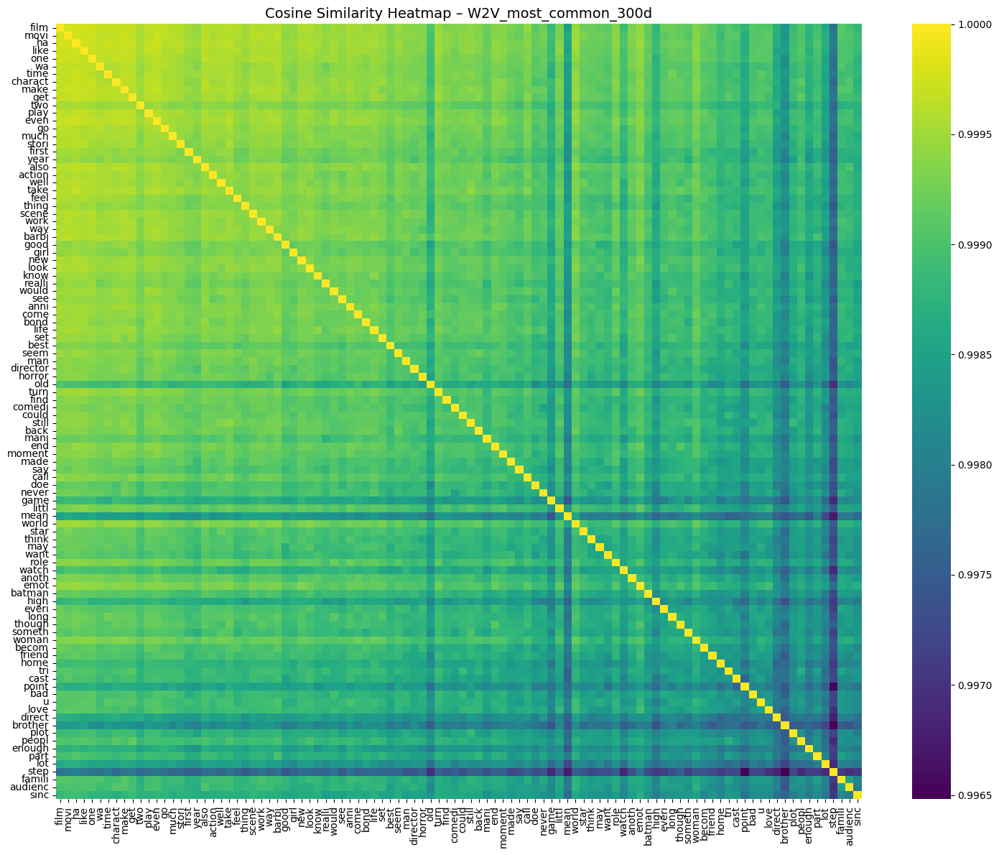

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


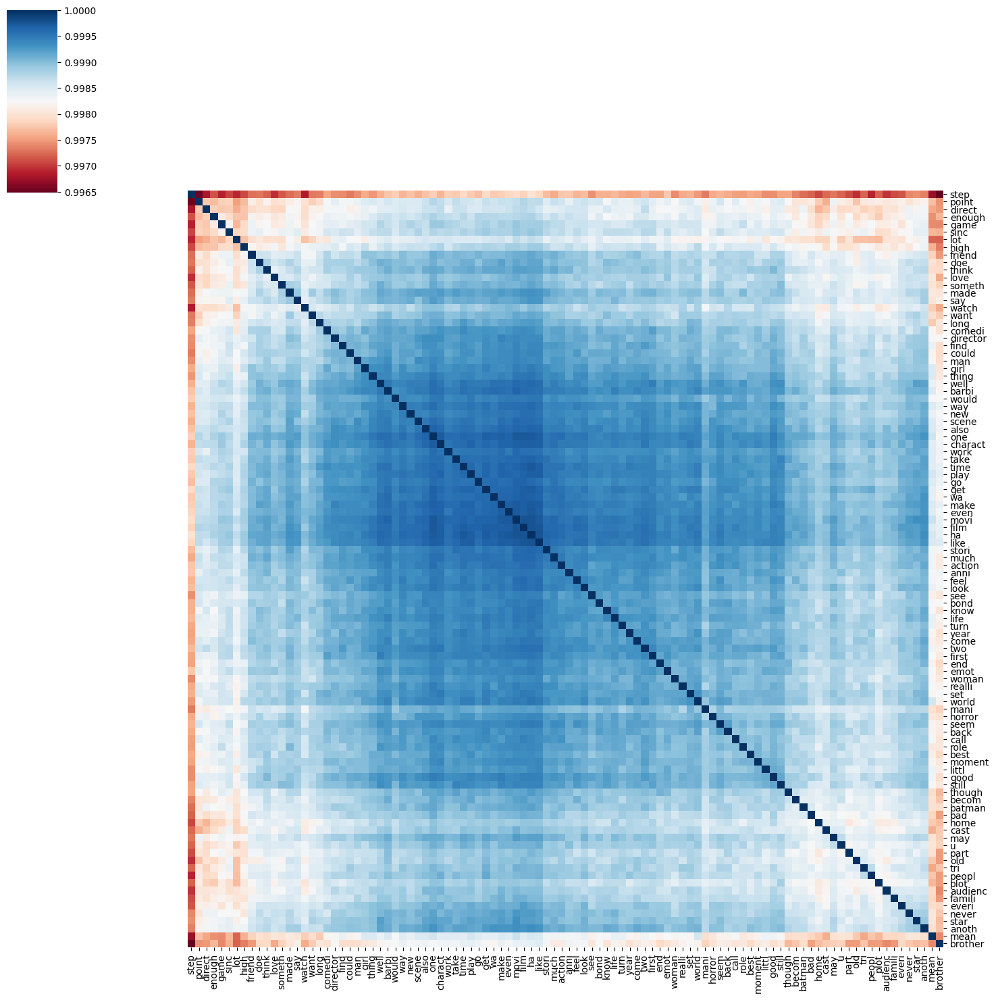

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


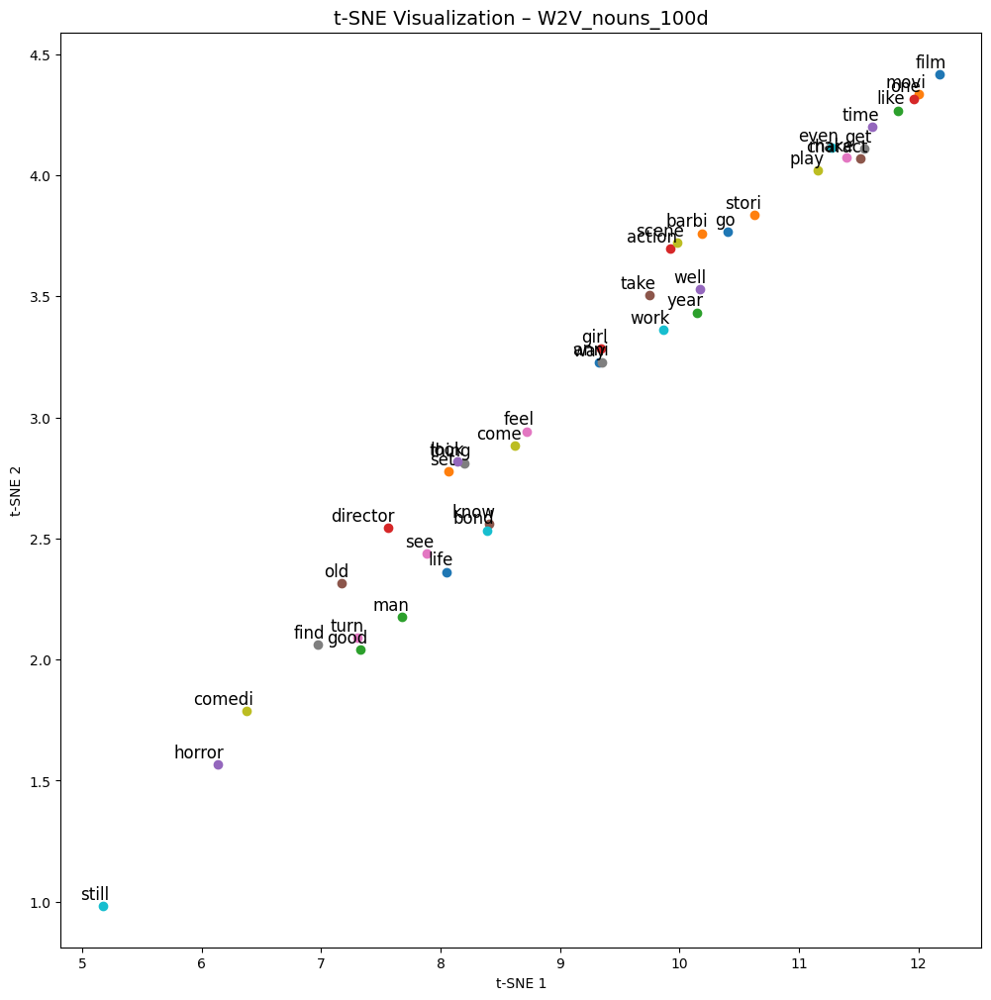

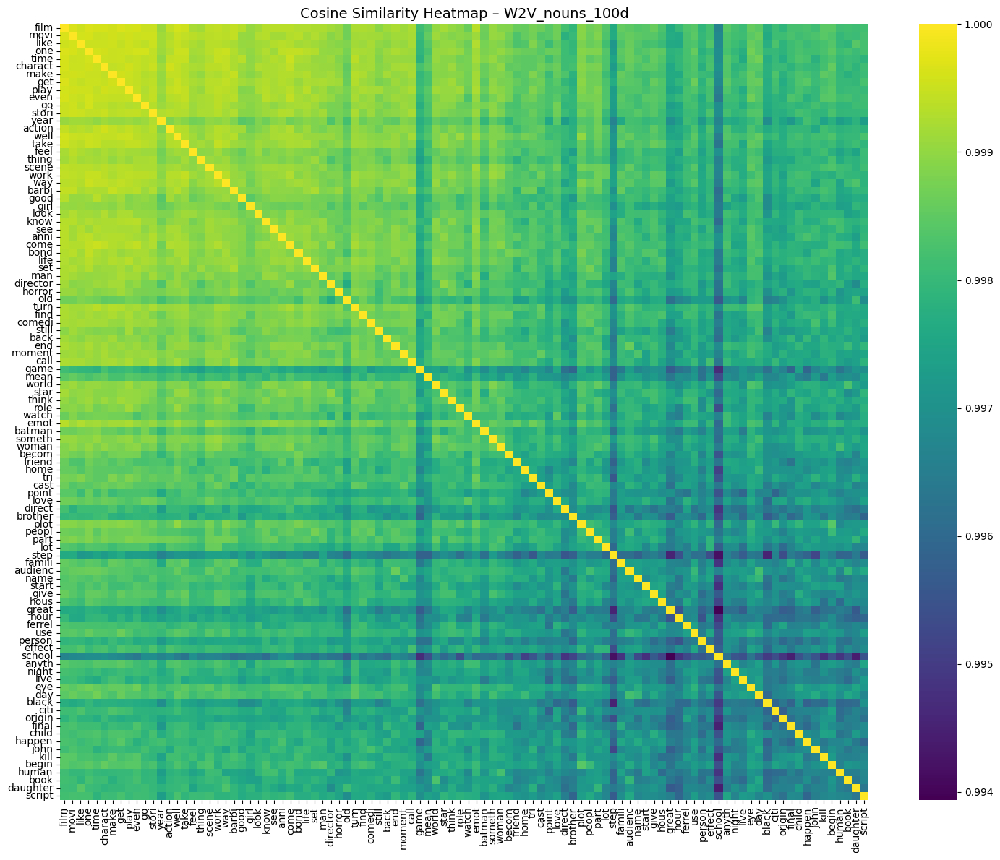

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


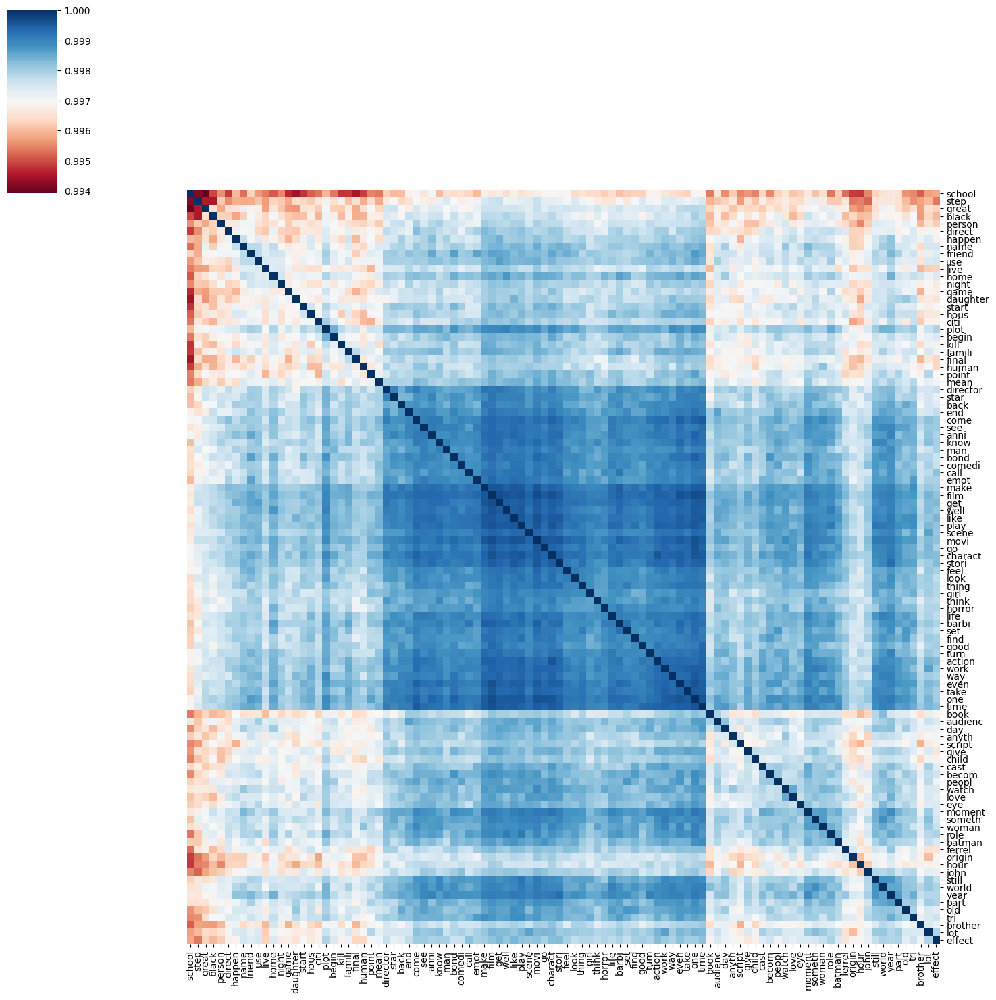

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


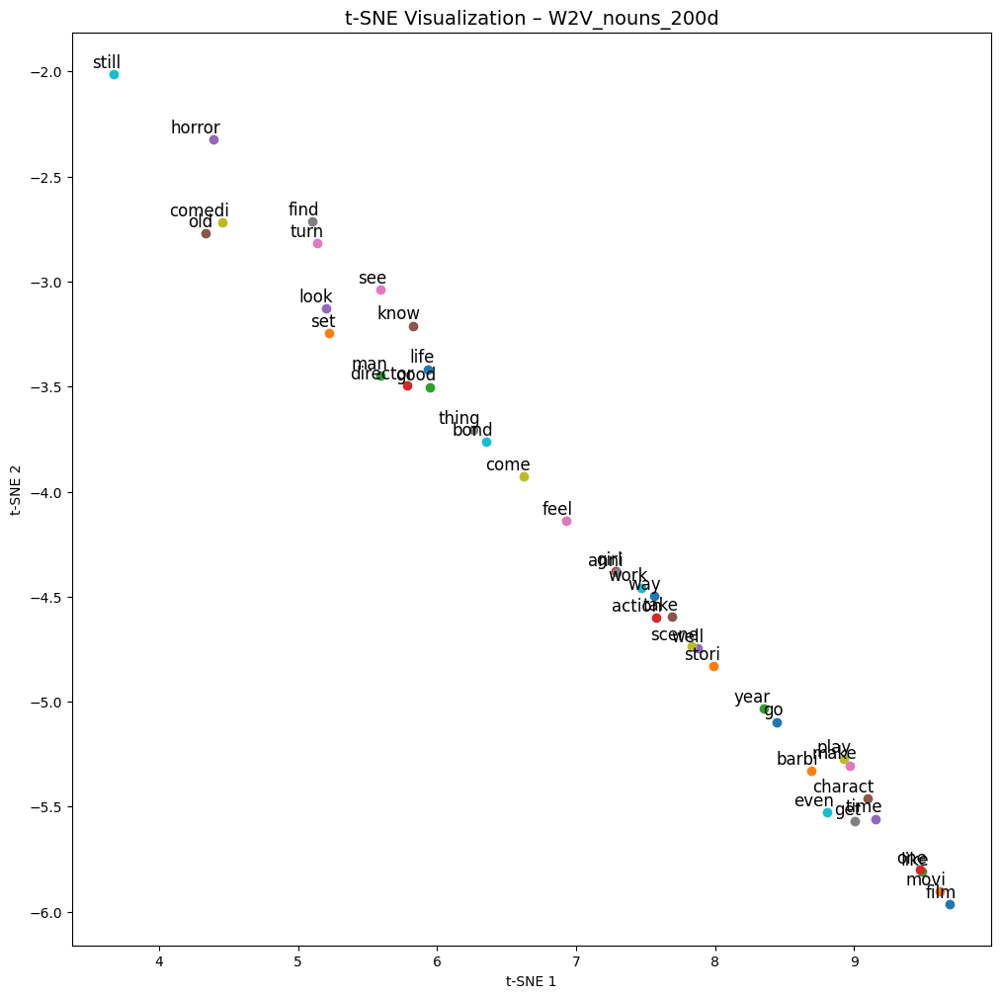

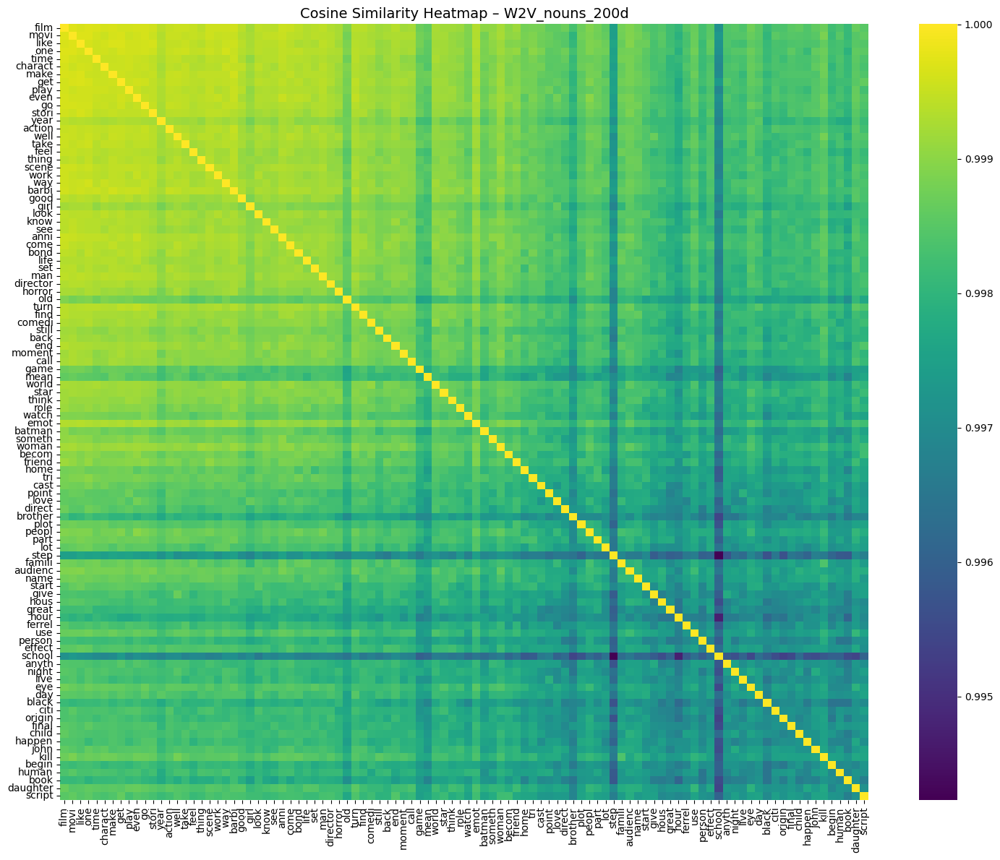

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


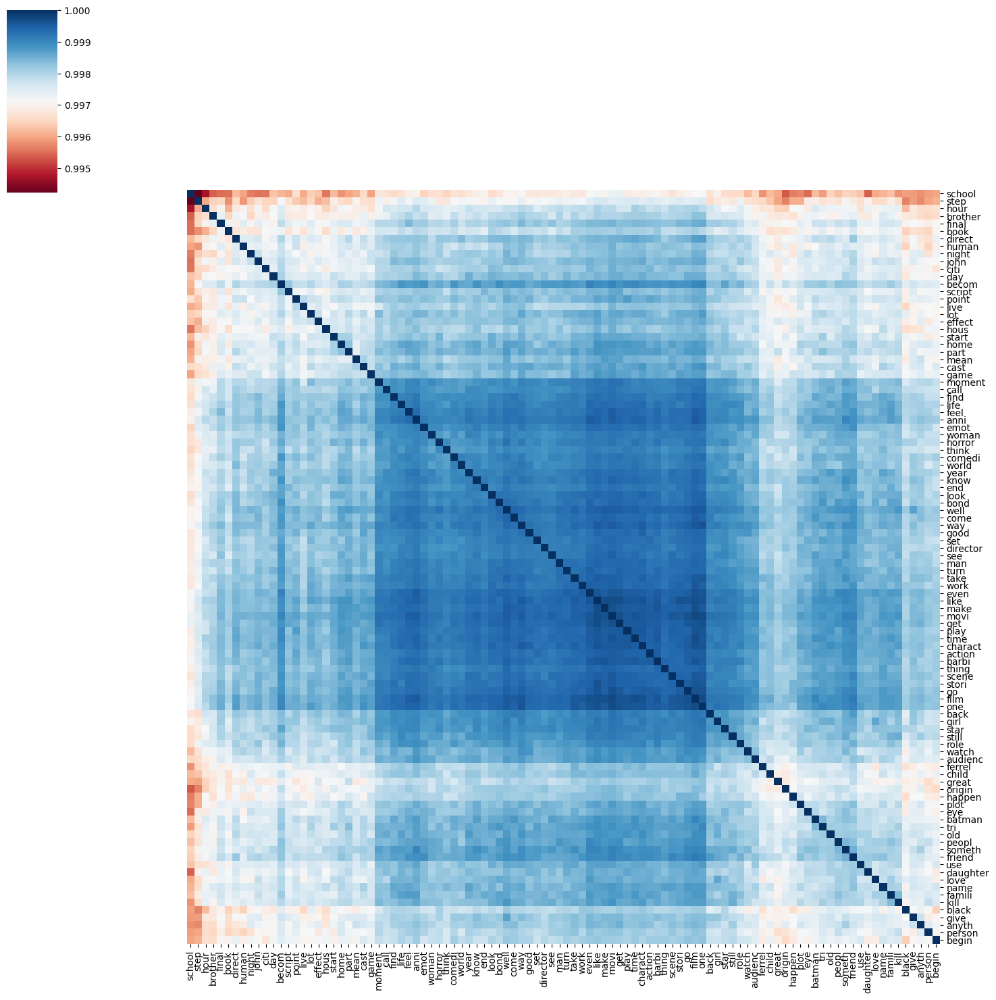

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


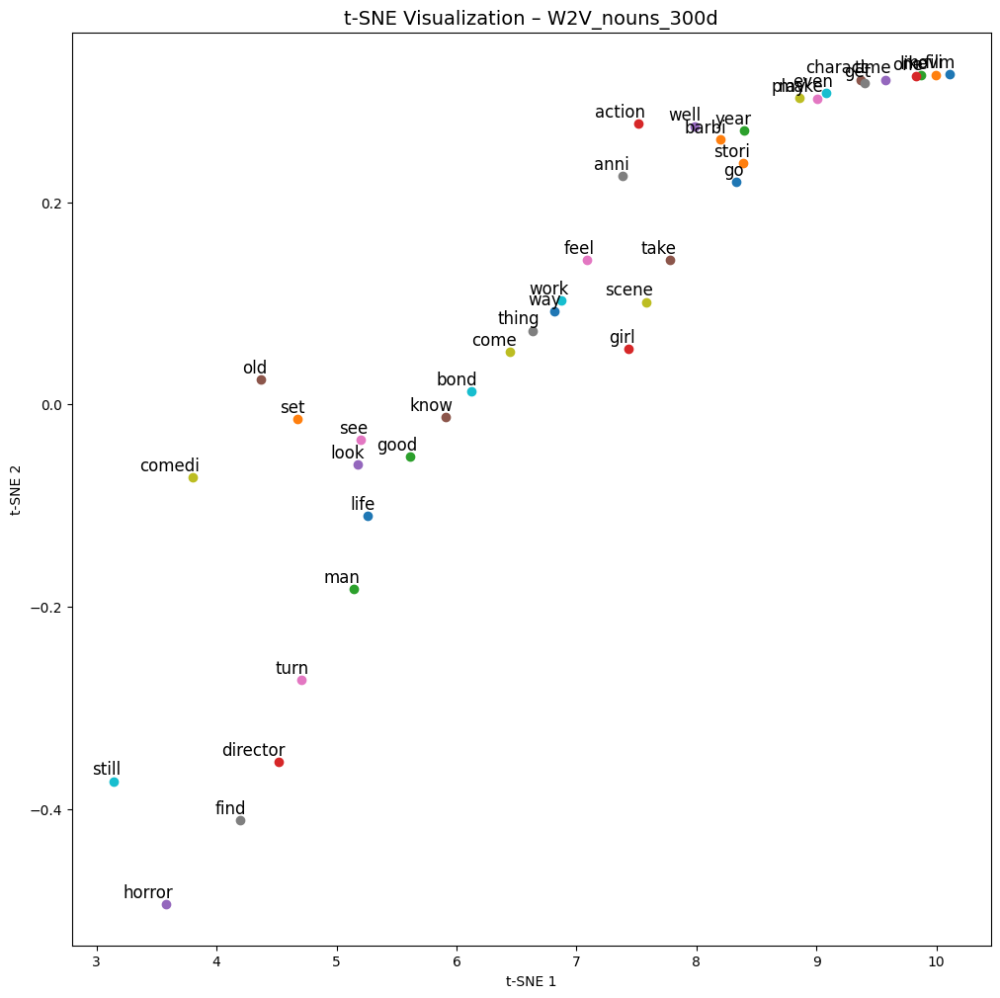

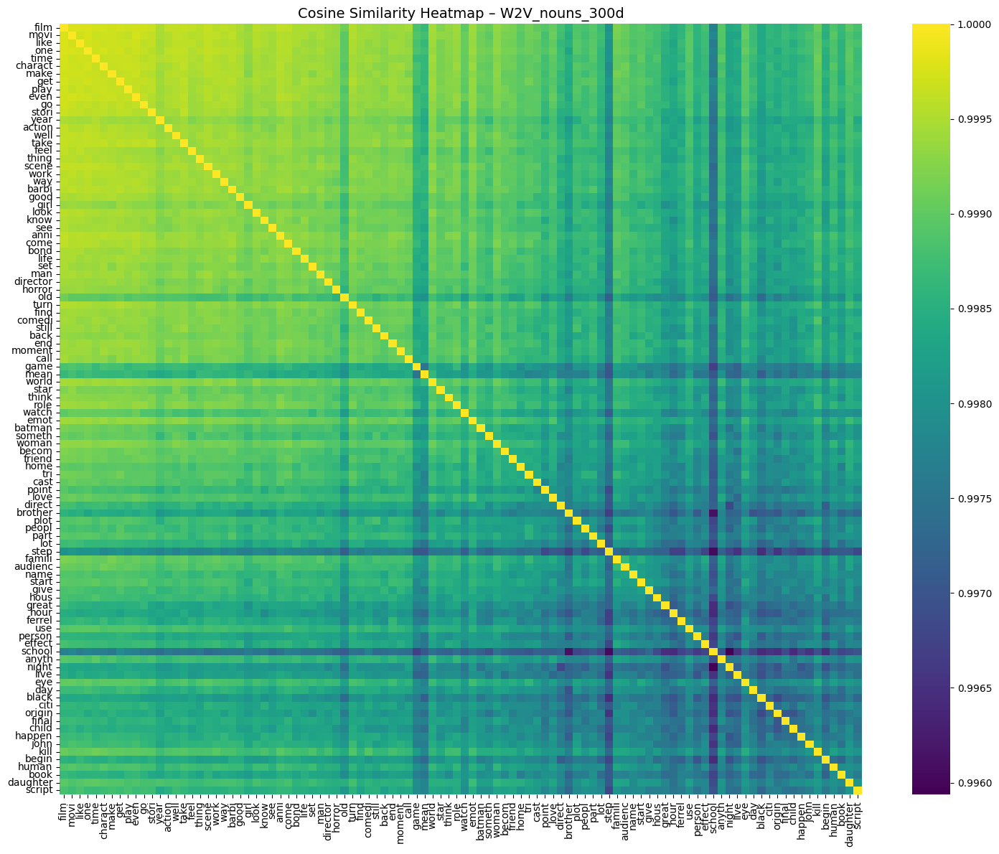

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


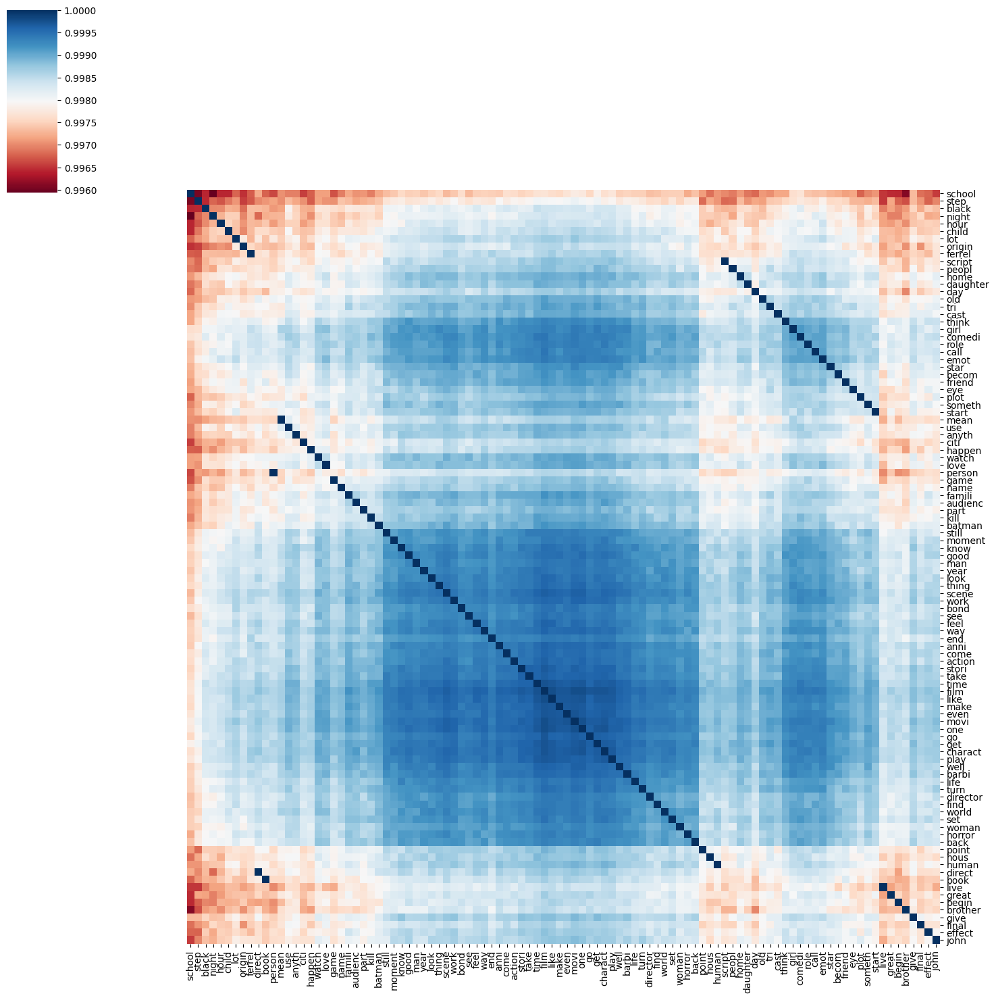

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


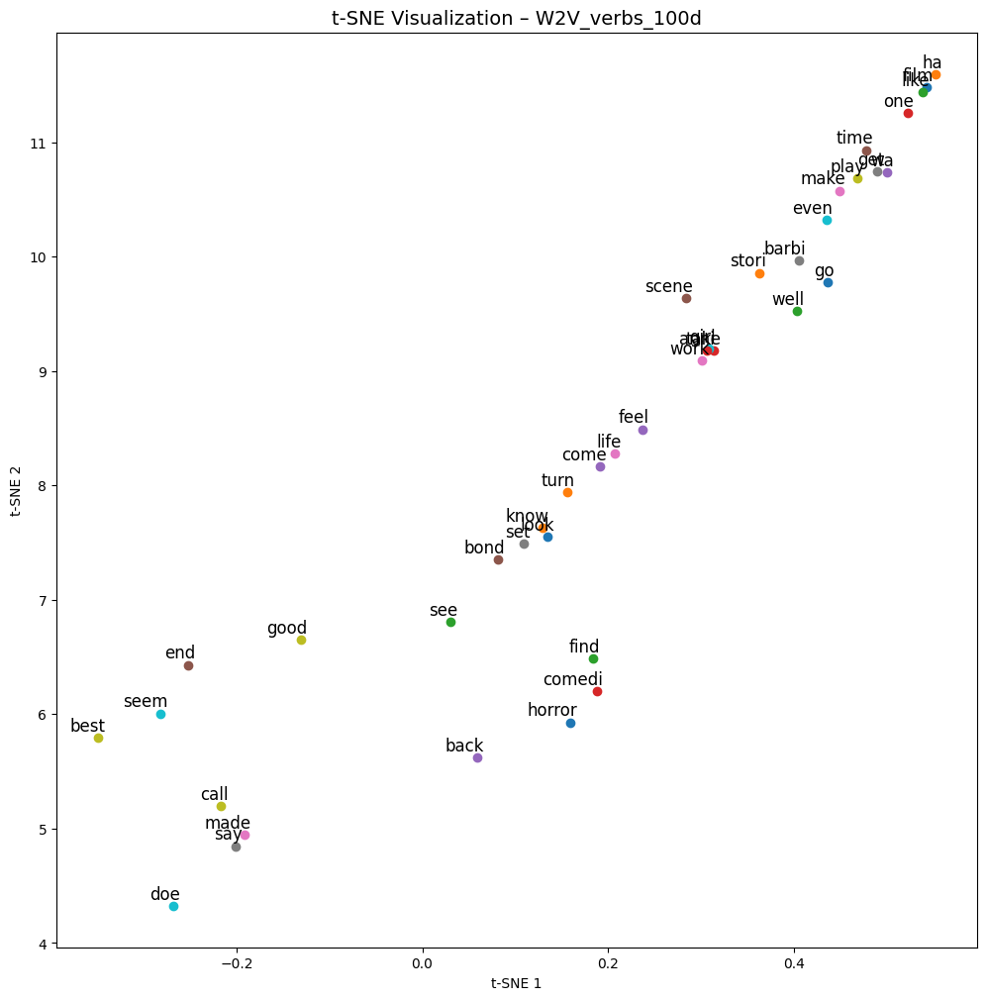

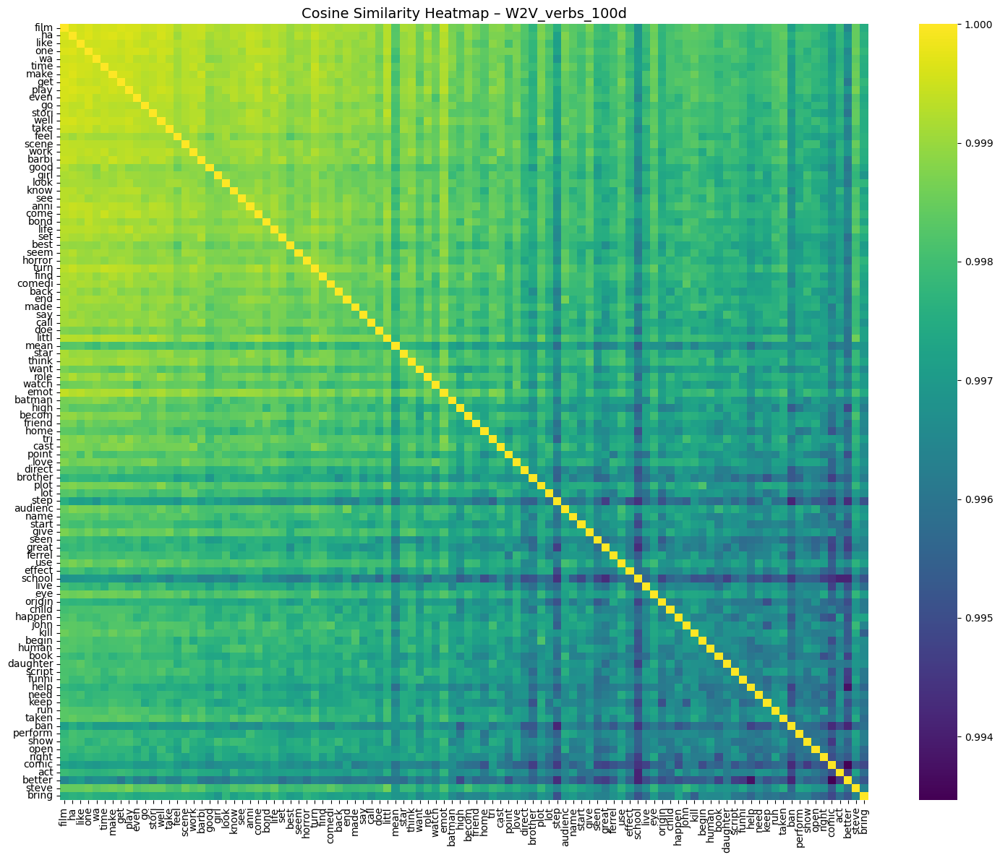

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


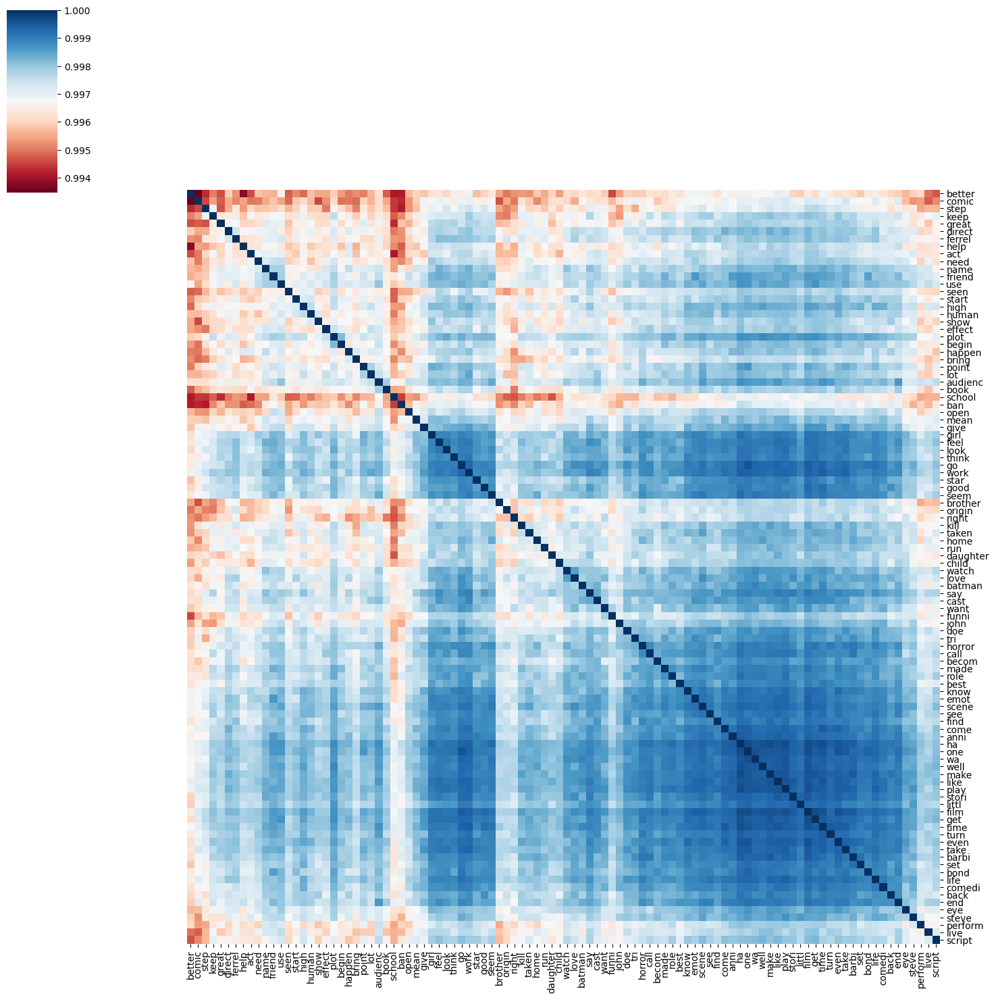

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


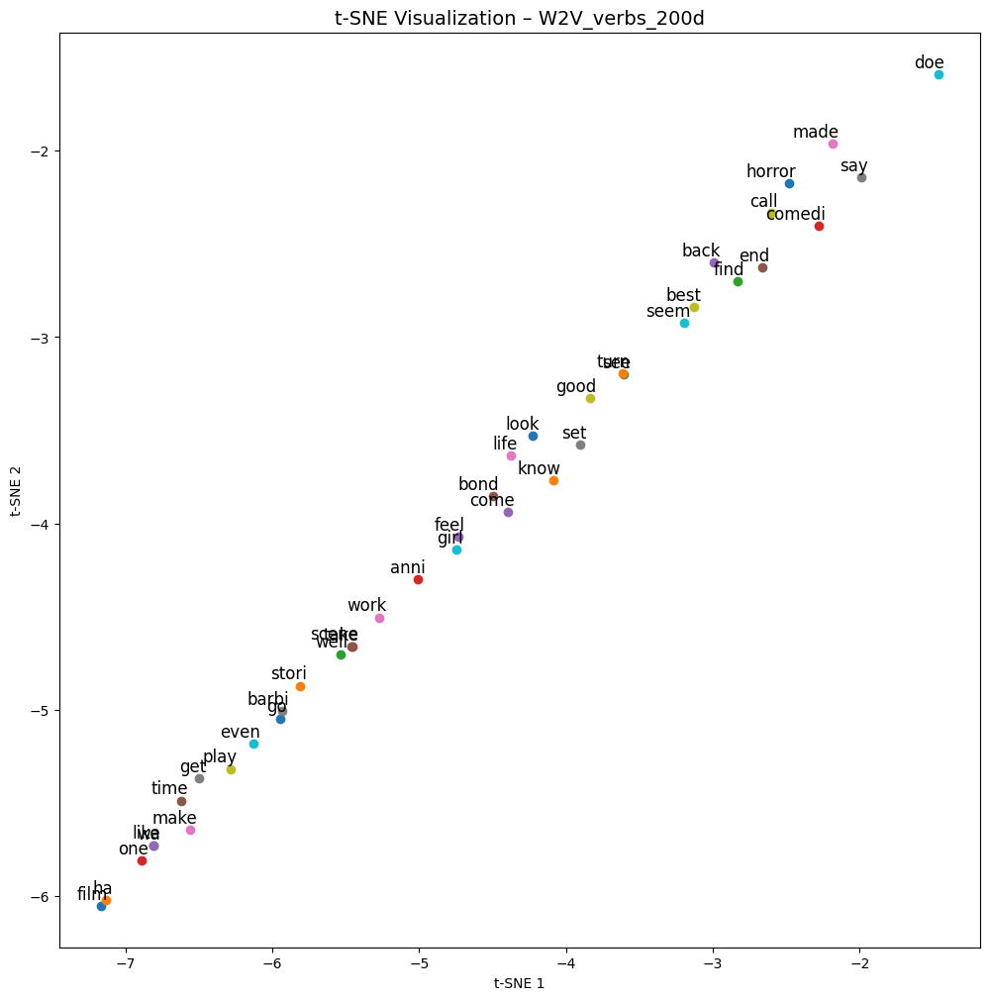

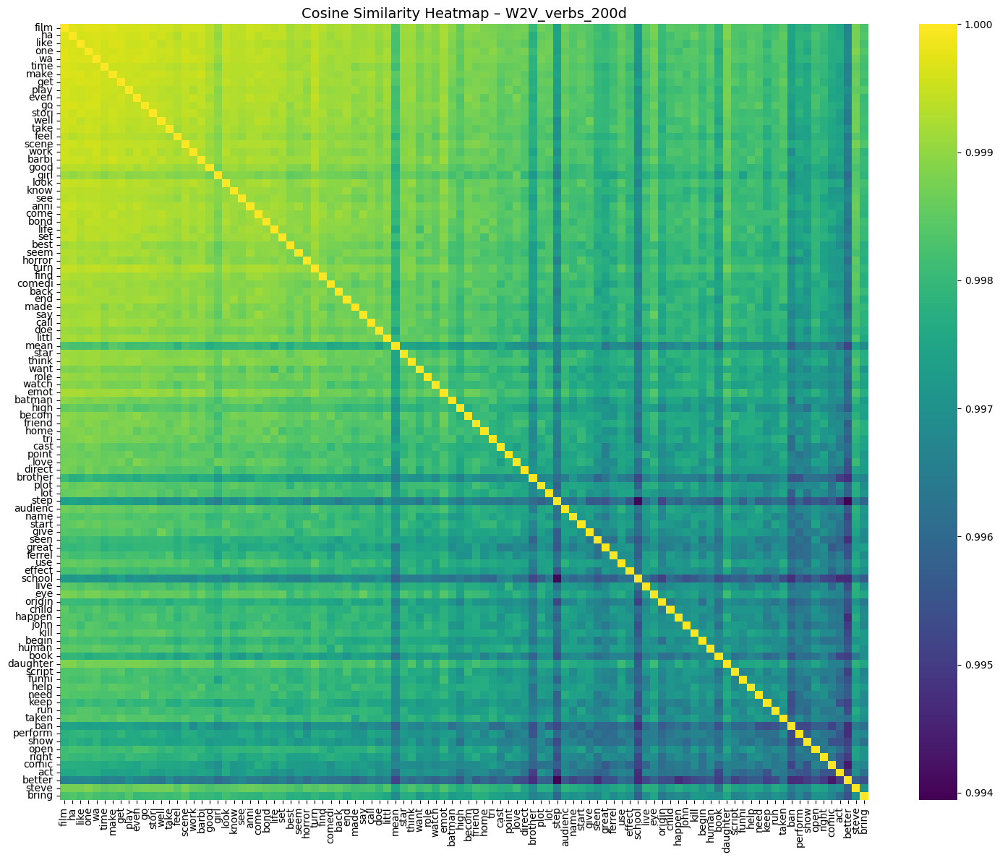

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


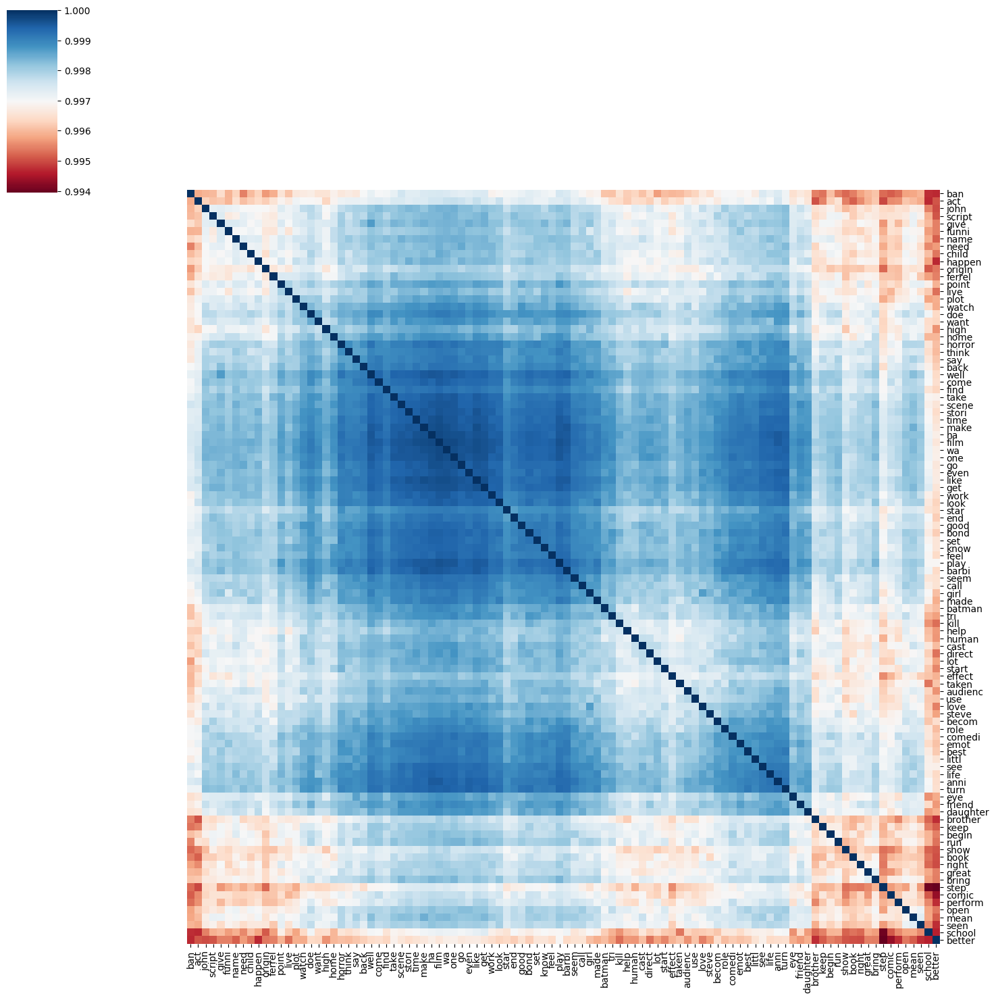

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


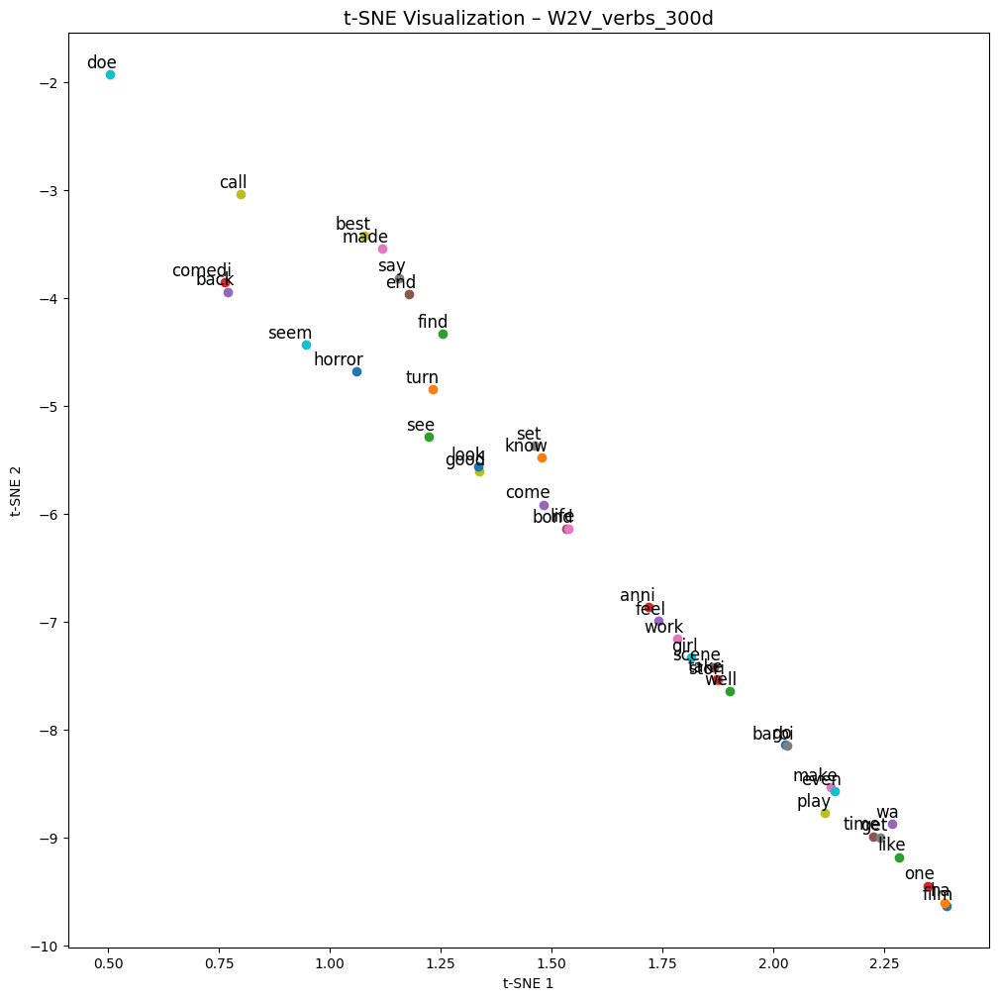

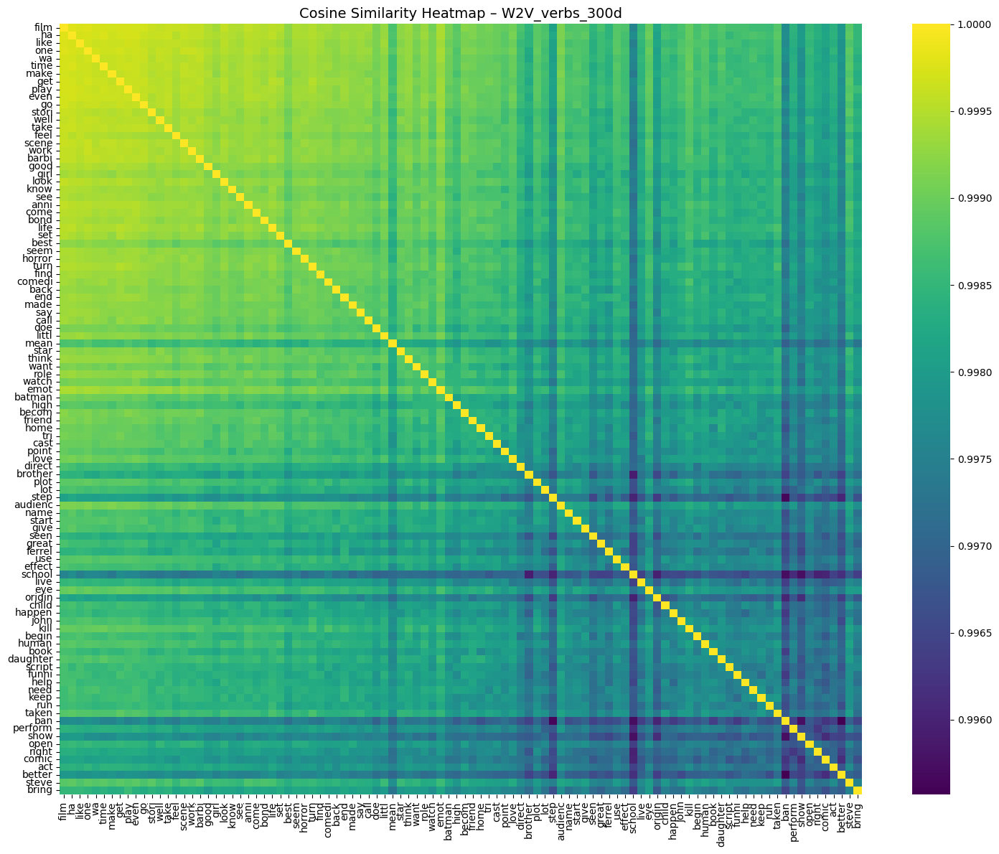

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


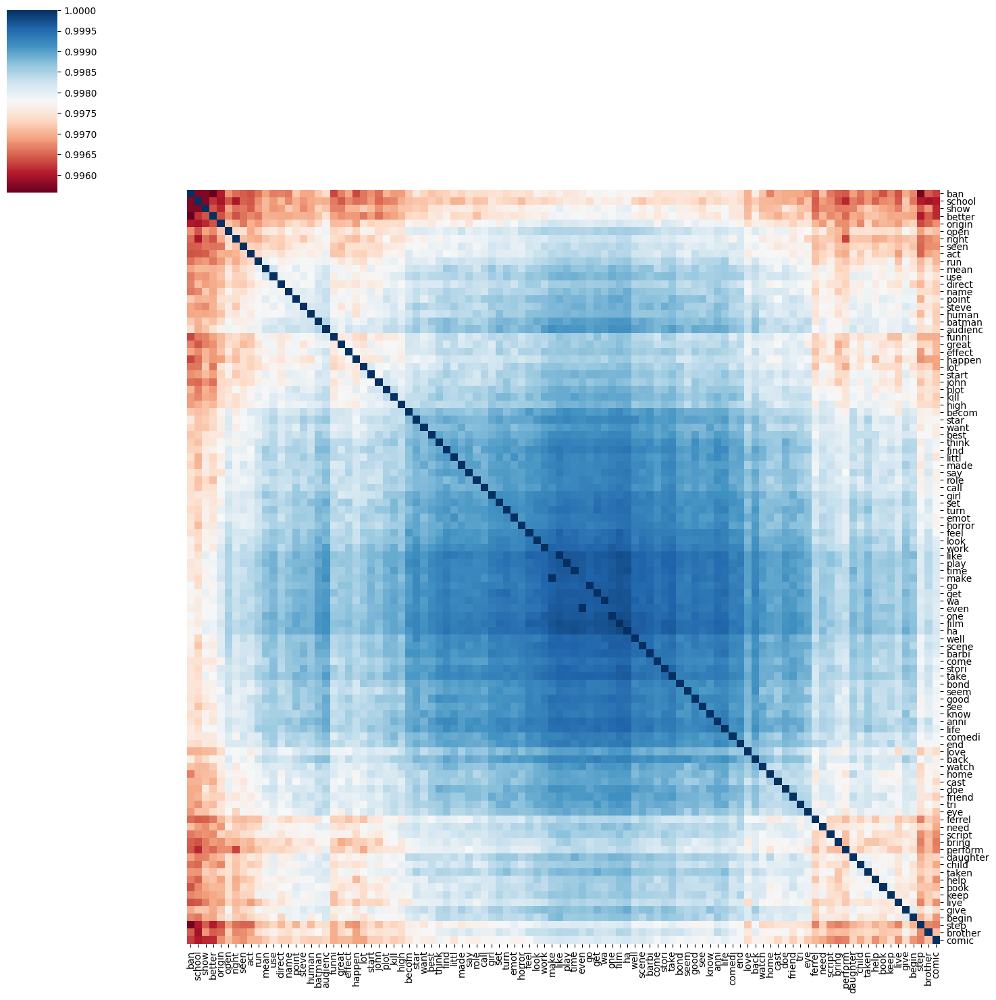

In [ ]:

# Word2Vec Experiment Runner Updated for Readability & Export


def get_word2vec_vectors(documents: List[TokenizedDocument], embedding_size: int) -> pd.DataFrame:
    tokens = [x.tokens for x in documents]
    word2vec_model = Word2Vec(
        sentences=tokens,
        vector_size=embedding_size,
        window=3,
        min_count=1,
        workers=12
    )
    vectors = {i: word2vec_model.wv[i] for i in word2vec_model.wv.index_to_key}
    result = pd.DataFrame(vectors).transpose().sort_index()
    return result


def plot_similarity_matrix(data: pd.DataFrame, experiment_name: str, figsize=(15, 12)):
    sims = cosine_similarity(data, data)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(
        ax=ax,
        data=sims,
        xticklabels=data.index,
        yticklabels=data.index,
        cmap="viridis"
    )
    ax.set_title(f"Cosine Similarity Heatmap – {experiment_name}", fontsize=14)
    plt.xticks(fontsize=10, rotation=90)
    plt.yticks(fontsize=10)
    plt.tight_layout()
    plt.savefig(f"{experiment_name}_heatmap.png", dpi=300, bbox_inches="tight")
    plt.show()


def plot_similarity_clustermap(data: pd.DataFrame, experiment_name: str, figsize=(15, 15)):
    sims = cosine_similarity(data, data)
    cm = sns.clustermap(
        sims,
        metric="cosine",
        xticklabels=data.index,
        yticklabels=data.index,
        method="complete",
        cmap="RdBu",
        figsize=figsize
    )
    cm.ax_row_dendrogram.set_visible(False)
    cm.ax_col_dendrogram.set_visible(False)
    plt.savefig(f"{experiment_name}_clustermap.png", dpi=300, bbox_inches="tight")
    plt.show()


def plot_tsne(data: pd.DataFrame, perplexity: int, experiment_name: str, figsize=(12, 12), top_n=40):
    tsne_model = TSNE(
        perplexity=perplexity,
        n_components=2,
        learning_rate="auto",
        init="pca",
        n_iter=1000,
        random_state=32
    )
    new_values = tsne_model.fit_transform(data)

    labels = list(data.index)[:top_n]  # limit to top N tokens
    coords = new_values[:top_n]

    plt.figure(figsize=figsize)
    for i, (x, y) in enumerate(coords):
        plt.scatter(x, y)
        plt.annotate(
            labels[i],
            xy=(x, y),
            xytext=(5, 2),
            textcoords="offset points",
            ha="right",
            va="bottom",
            fontsize=12
        )
    plt.title(f"t-SNE Visualization – {experiment_name}", fontsize=14)
    plt.xlabel("t-SNE 1")
    plt.ylabel("t-SNE 2")
    plt.savefig(f"{experiment_name}_tsne.png", dpi=300, bbox_inches="tight")
    plt.show()


def run_word2vec_experiment(documents: List[Document],
                            clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                            embedding_size: int,
                            chosen_tokens: List[str],
                            experiment_name: str):
    cleaned_documents = clean_func(documents)
    word2vec_df = get_word2vec_vectors(cleaned_documents, embedding_size)

    # filter only chosen tokens that exist in vocab
    chosen_tokens_in_vocab = [t for t in chosen_tokens if t in word2vec_df.index]
    if not chosen_tokens_in_vocab:
        print(f"[{experiment_name}] No tokens found in vocab.")
        return

    filtered_word2vec_df = word2vec_df.loc[chosen_tokens_in_vocab].copy()

    # Run plots
    plot_tsne(filtered_word2vec_df, perplexity=30, experiment_name=experiment_name)
    plot_similarity_matrix(filtered_word2vec_df, experiment_name)
    plot_similarity_clustermap(filtered_word2vec_df, experiment_name)


# Run ALL Word2Vec Experiments


# Most Common tokens
run_word2vec_experiment(documents, clean_method, 100, tokens_most_common, "W2V_most_common_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_most_common, "W2V_most_common_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_most_common, "W2V_most_common_300d")

# Nouns only
run_word2vec_experiment(documents, clean_method, 100, tokens_nouns, "W2V_nouns_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_nouns, "W2V_nouns_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_nouns, "W2V_nouns_300d")

# Verbs only
run_word2vec_experiment(documents, clean_method, 100, tokens_verbs, "W2V_verbs_100d")
run_word2vec_experiment(documents, clean_method, 200, tokens_verbs, "W2V_verbs_200d")
run_word2vec_experiment(documents, clean_method, 300, tokens_verbs, "W2V_verbs_300d")


In [ ]:
# Extra Terms + Random Token Pool

# Bridesmaids anchor terms
extra_terms = [
    "bridesmaids",
    "annie",
    "lillian",
    "helen",
    "wiig",
    "mccarthy",
    "rudolph",
    "byrne",
    "comedy",
    "wedding",
    "friendship"
]

# Build candidate token pool
all_tokens = get_all_tokens(remove_stop_words(clean_method(documents)))

# xactly 100 tokens: random sample + anchors
import random
chosen_tokens = random.choices(all_tokens, k=100 - len(extra_terms)) + extra_terms

# Lemmatize & stem
lemmatizer = WordNetLemmatizer()
lemmatized_chosen_tokens = [lemmatizer.lemmatize(x) for x in chosen_tokens]
stemmed_chosen_tokens = [stemmer.stem(x) for x in lemmatized_chosen_tokens]

print(f"Chosen tokens : {chosen_tokens[:15]}")


Chosen tokens : ['churn', 'margret', 'preval', 'muse', 'part', 'aspir', 'promis', 'symphoni', 'connor', 'direct', 'welcom', 'drift', 'perfect', 'dour', 'plotlin']


In [ ]:
def run_word2vec_experiment(documents: List[Document],
                            clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                            embedding_size: int,
                            chosen_tokens: List[str],
                            experiment_name: str):
    cleaned_documents = clean_func(documents)
    word2vec_df = get_word2vec_vectors(cleaned_documents, embedding_size)

    tokens_in_vocab = [t for t in chosen_tokens if t in word2vec_df.index]
    if not tokens_in_vocab:
        print(" None of the chosen tokens are in the Word2Vec vocabulary.")
        return

    filtered_word2vec_df = word2vec_df.loc[tokens_in_vocab].copy()

    plot_tsne(filtered_word2vec_df, 30, experiment_name)
    plot_similarity_matrix(filtered_word2vec_df, experiment_name)
    plot_similarity_clustermap(filtered_word2vec_df, experiment_name)


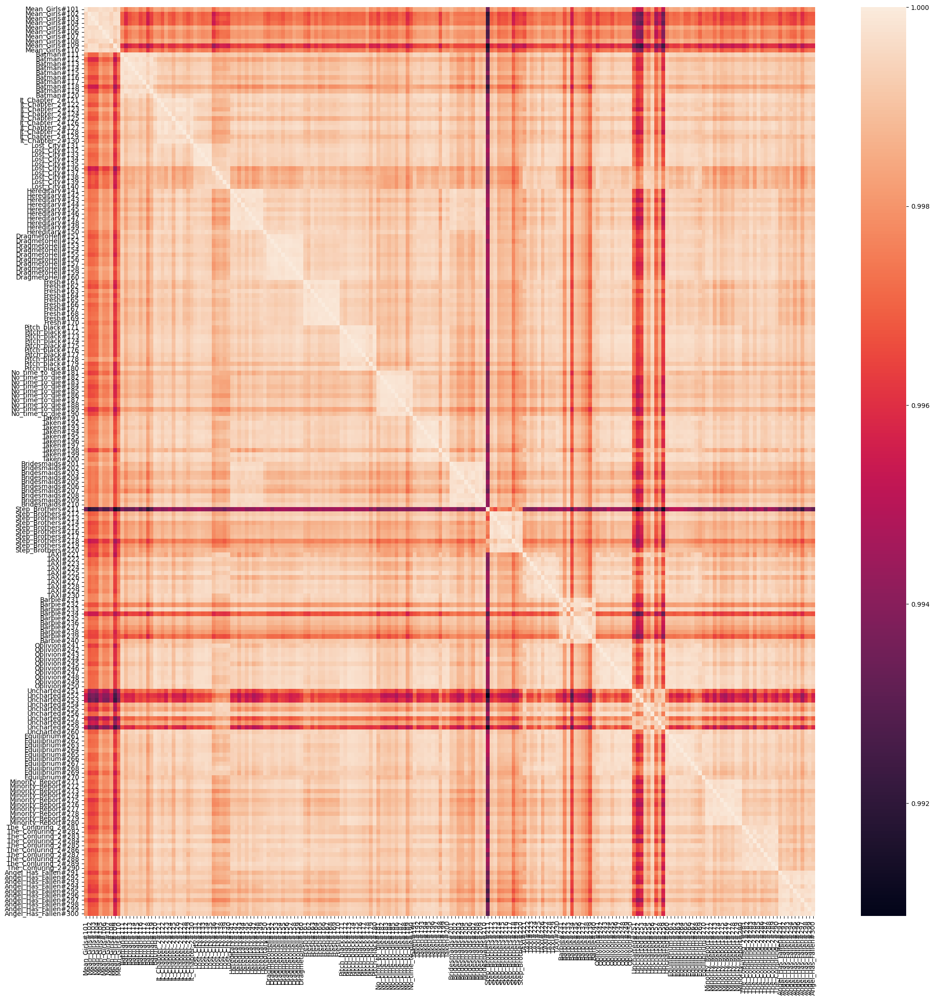

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


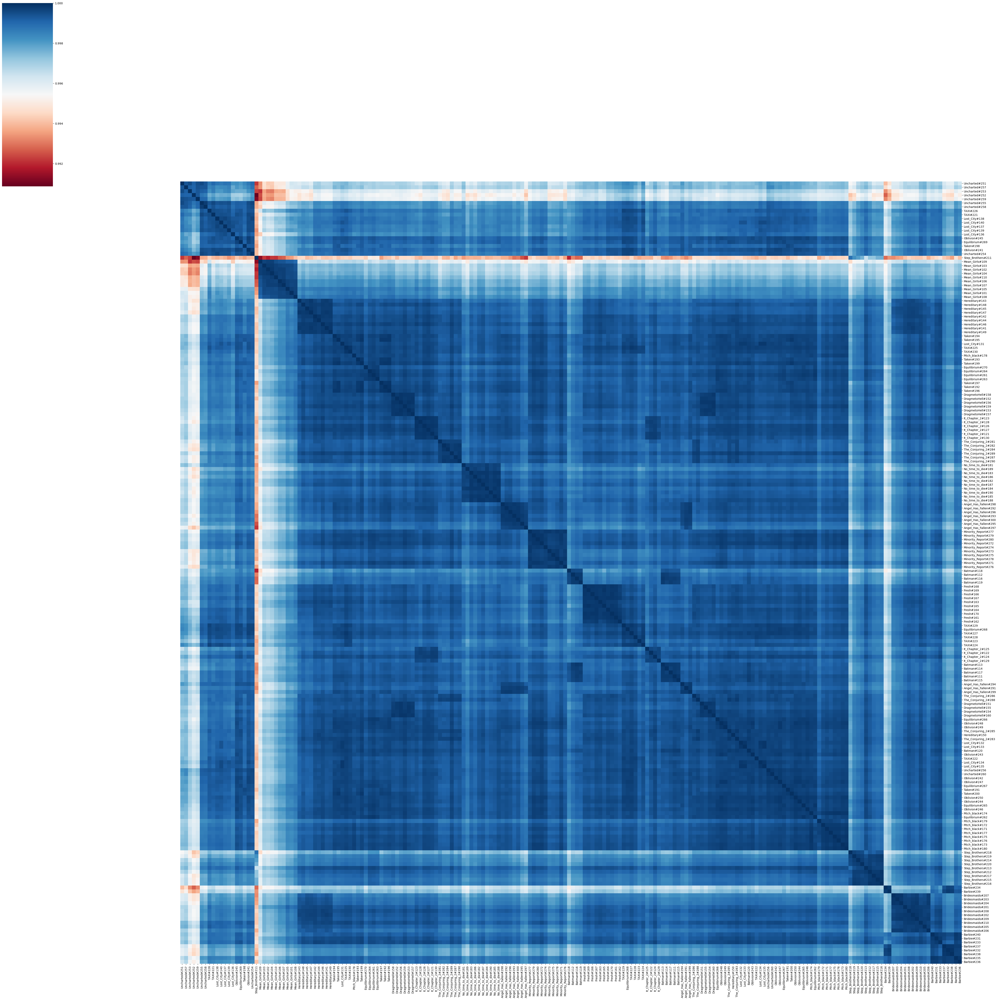

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


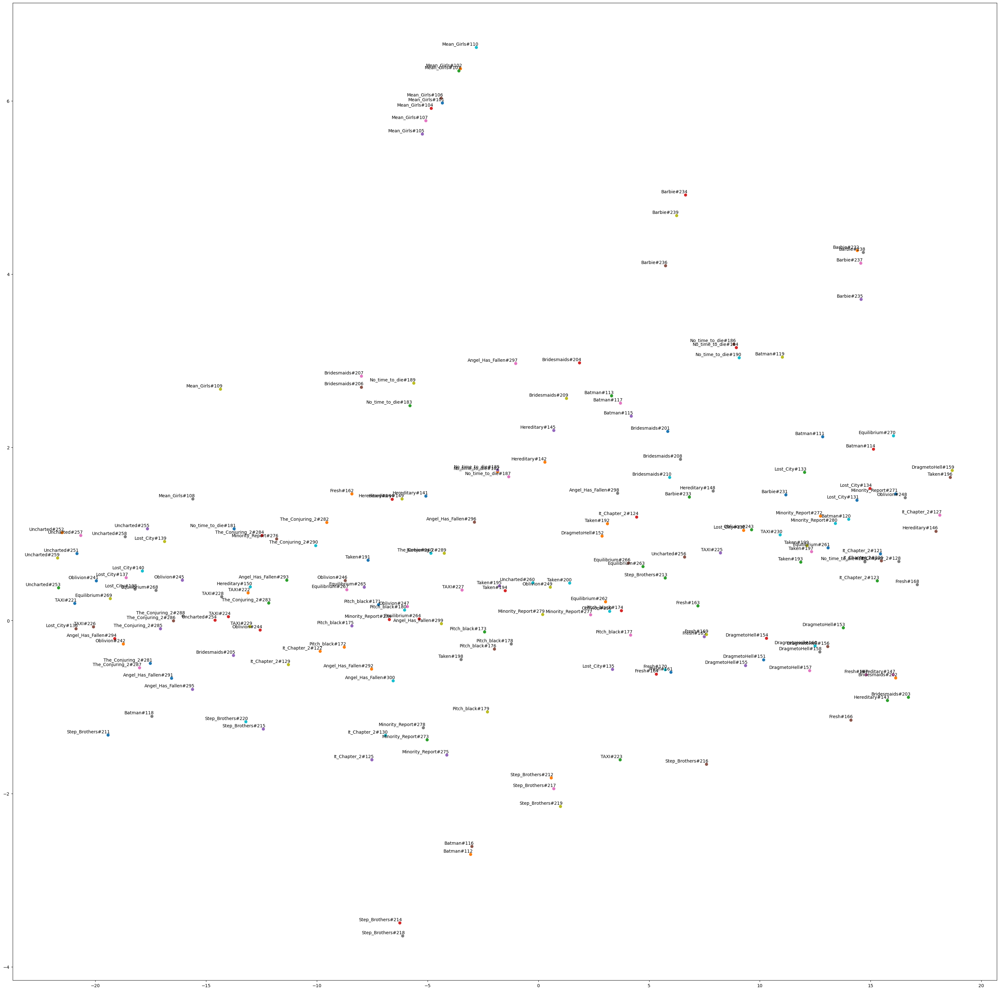

In [ ]:
#  Doc2Vec Experiments

from gensim.models.doc2vec import Doc2Vec, TaggedDocument

def run_doc2vec(documents: List[TokenizedDocument], embedding_size: int, descriptors_by_doc_ids: Dict[int, str]):
    tagged_documents = [TaggedDocument(document.tokens, [i]) for i, document in enumerate(documents)]
    doc2vec_model = Doc2Vec(tagged_documents, vector_size=embedding_size, window=3, min_count=2, workers=12)

    doc2vec_df = pd.DataFrame()
    for document in documents:
        vector = pd.DataFrame(doc2vec_model.infer_vector(document.tokens)).transpose()
        doc2vec_df = pd.concat([doc2vec_df, vector], axis=0)

    doc2vec_df['Descriptor'] = [descriptors_by_doc_ids[x.doc_id] for x in documents]
    doc2vec_df.set_index(['Descriptor'], inplace=True)
    return doc2vec_df

def run_doc2vec_experiment(documents: List[Document],
                           clean_func: Callable[[List[Document]], List[TokenizedDocument]],
                           embedding_size: int,
                           experiment_name: str):
    cleaned_documents = clean_func(documents)
    doc2vec_df = run_doc2vec(cleaned_documents, embedding_size, descriptors_by_doc_ids)

    plot_similarity_matrix(doc2vec_df, experiment_name)
    plot_similarity_clustermap(doc2vec_df, experiment_name, figsize=(50, 50))
    plot_tsne(doc2vec_df, 30, experiment_name)

# Example run
run_doc2vec_experiment(documents, clean_method, 100, "Doc2Vec_exp")


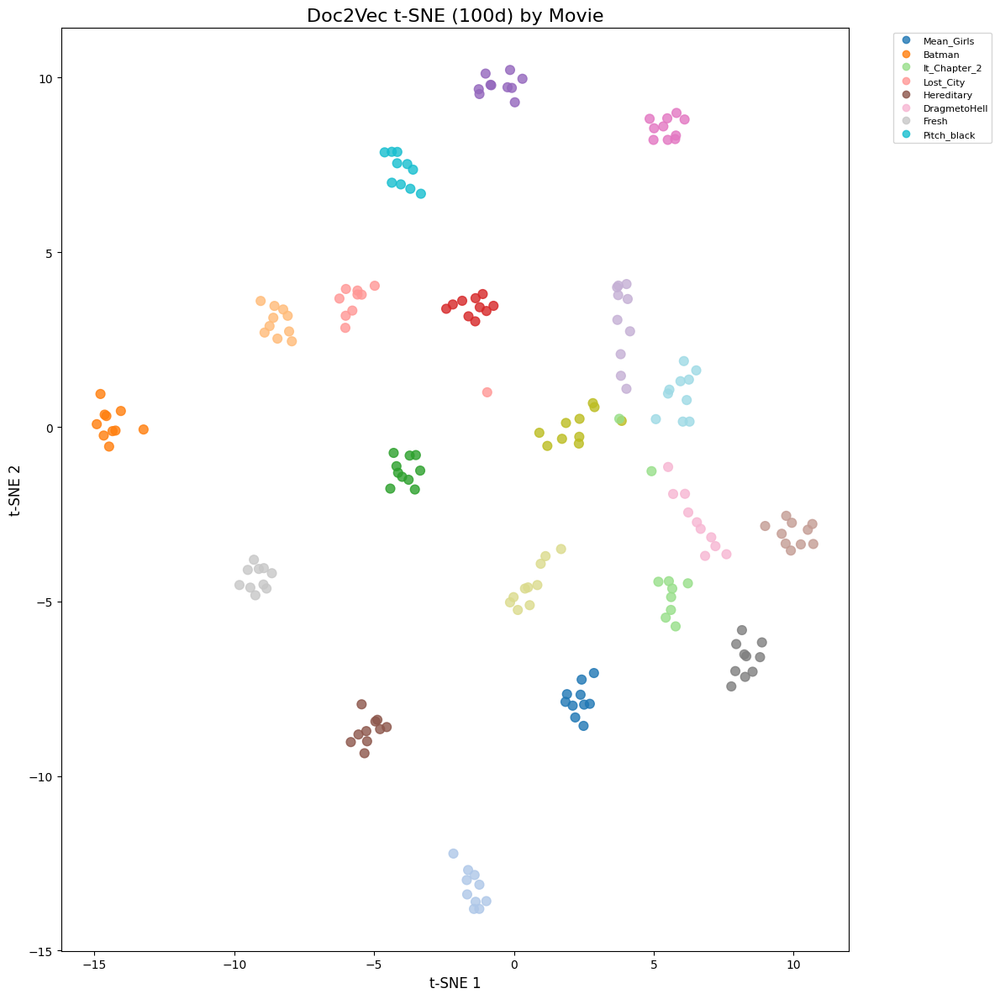

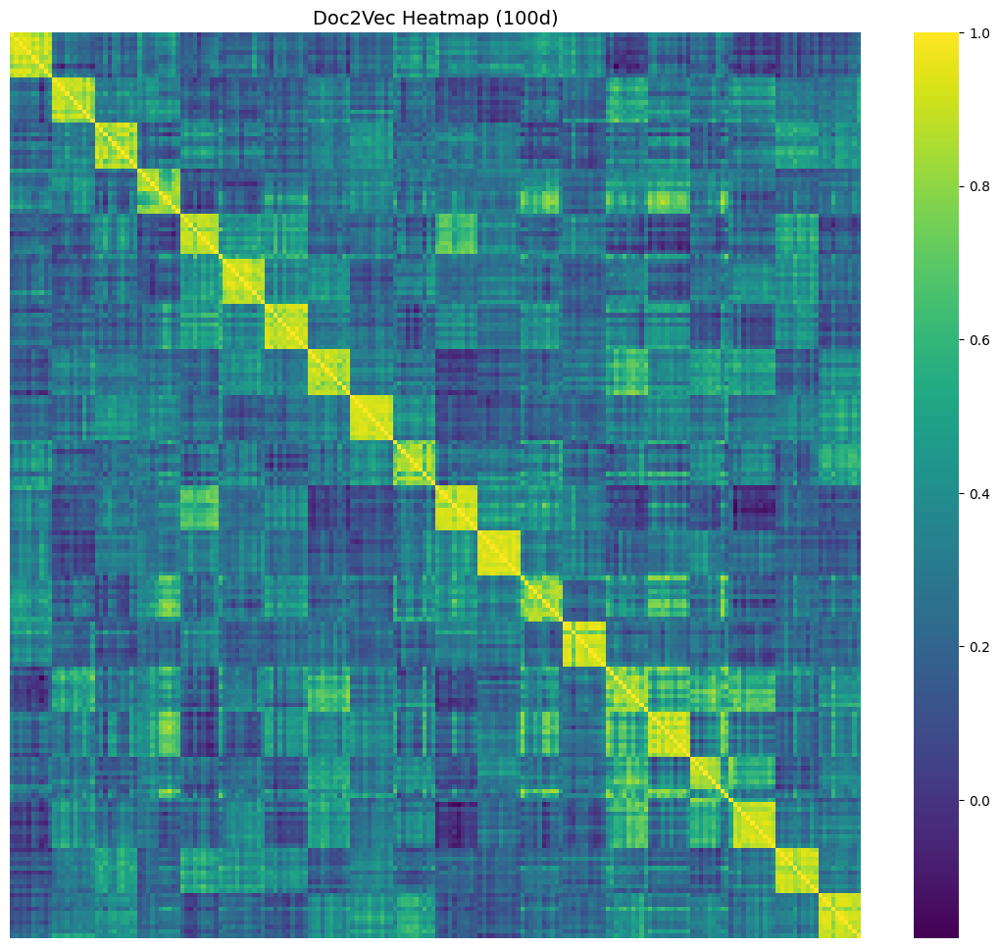

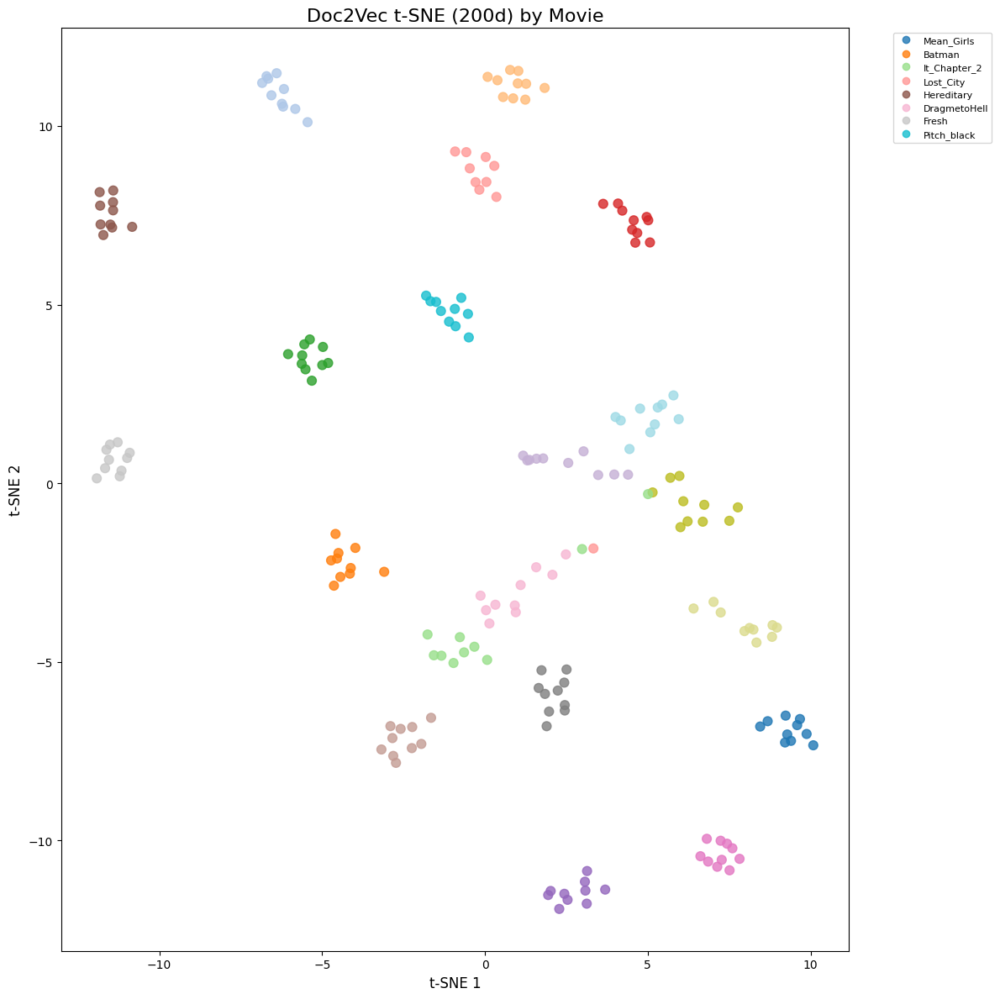

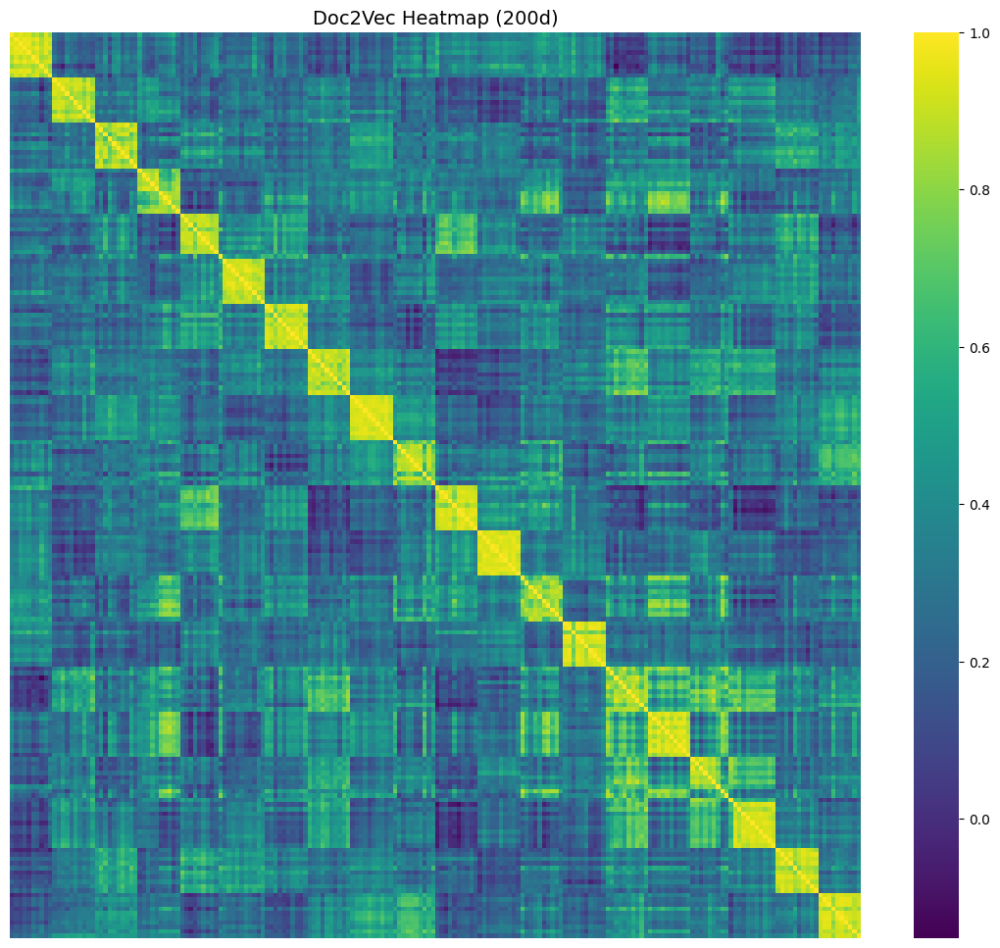

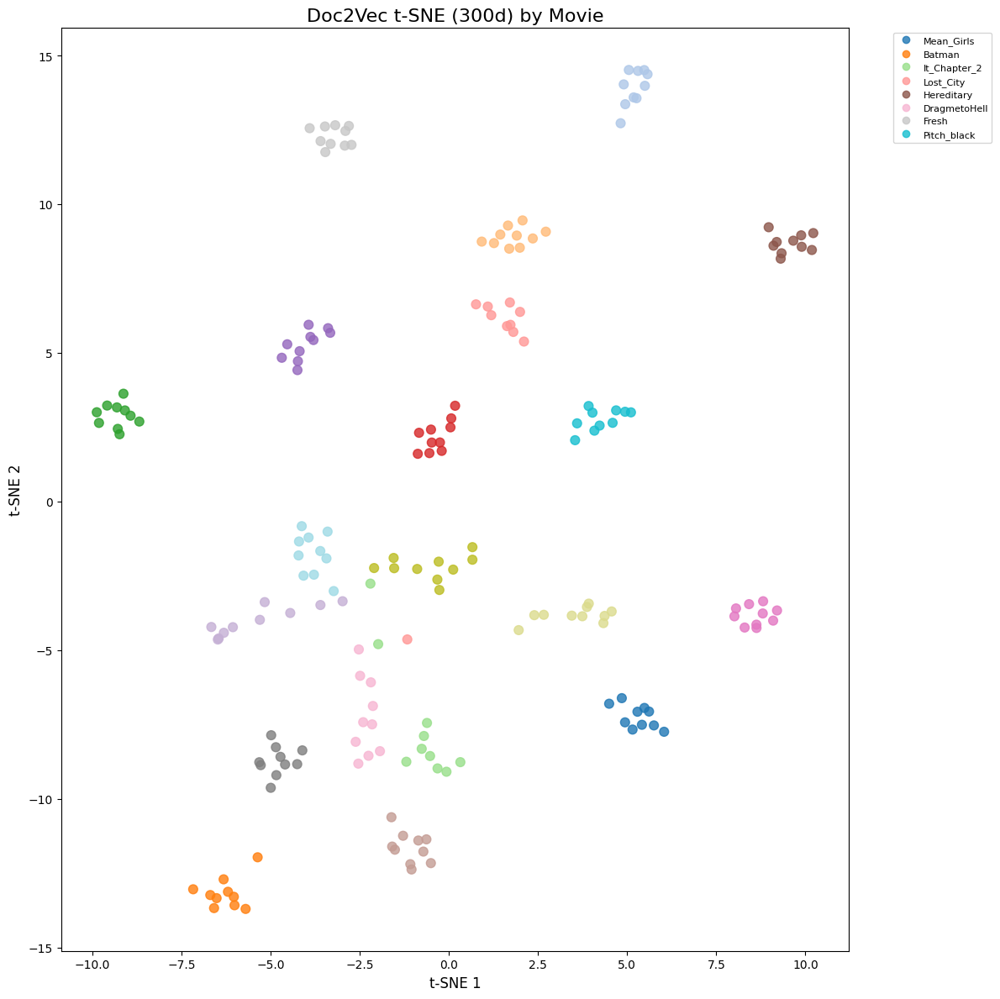

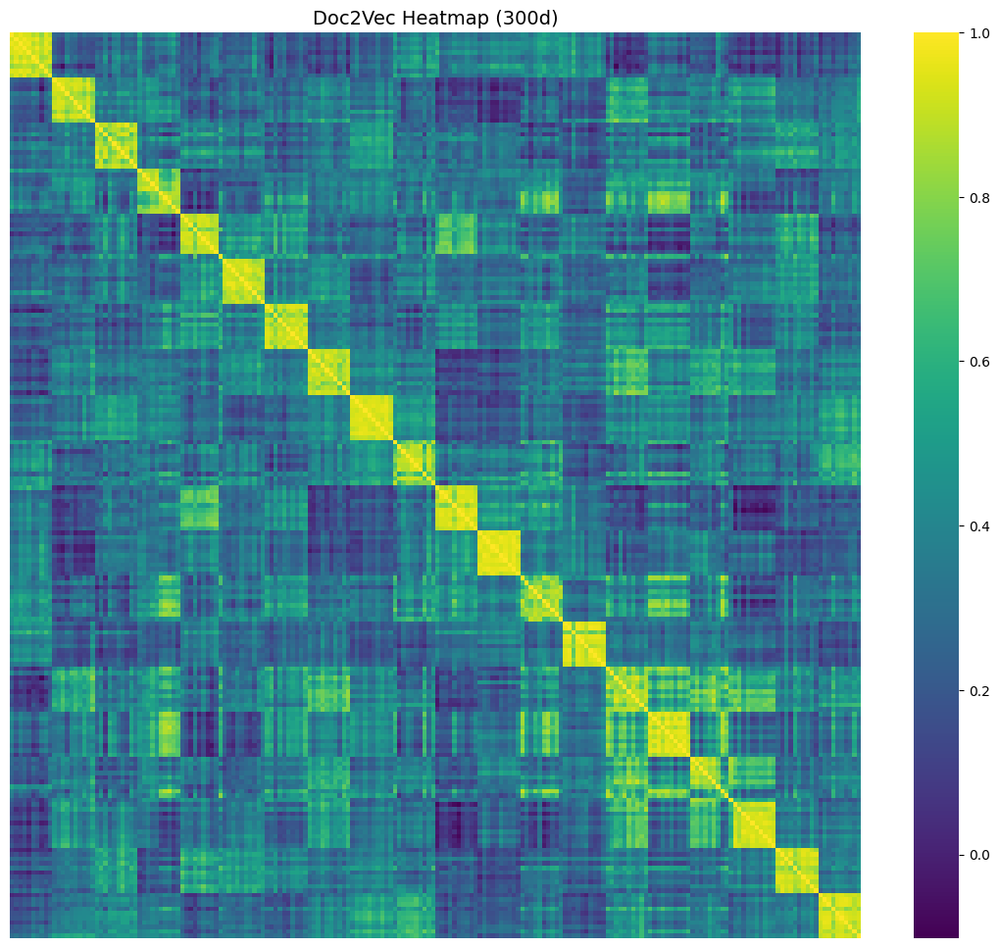

In [ ]:

# Doc2Vec Experiments Readable Plots

from gensim.models.doc2vec import Doc2Vec, TaggedDocument

def train_doc2vec(documents: List[TokenizedDocument], embedding_size: int) -> pd.DataFrame:
    """Train Doc2Vec and return document embeddings as DataFrame indexed by Doc_ID."""
    tagged_docs = [TaggedDocument(words=doc.tokens, tags=[str(doc.doc_id)]) for doc in documents]

    model = Doc2Vec(
        vector_size=embedding_size,
        window=5,
        min_count=2,
        workers=12,
        epochs=40,
        dm=1
    )
    model.build_vocab(tagged_docs)
    model.train(tagged_docs, total_examples=model.corpus_count, epochs=model.epochs)

    vectors = {tag: model.dv[tag] for tag in model.dv.index_to_key}
    df = pd.DataFrame(vectors).transpose()
    df.index = [int(i) for i in df.index]
    return df


def plot_doc2vec_tsne(doc_df: pd.DataFrame, title: str, category_labels: pd.Series, figsize=(12, 12)):
    """t-SNE scatterplot of Doc2Vec embeddings colored by category (e.g., movie or genre)."""
    tsne = TSNE(n_components=2, random_state=42, perplexity=30)
    embeddings_2d = tsne.fit_transform(doc_df.values)

    plt.figure(figsize=figsize)
    scatter = plt.scatter(
        embeddings_2d[:, 0], embeddings_2d[:, 1],
        c=category_labels.astype("category").cat.codes,
        cmap="tab20", s=60, alpha=0.8
    )
    plt.title(title, fontsize=16)
    plt.xlabel("t-SNE 1", fontsize=12)
    plt.ylabel("t-SNE 2", fontsize=12)

    # Add legend
    handles, labels = scatter.legend_elements()
    plt.legend(handles, category_labels.unique(), bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)

    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}_tsne.png", dpi=300, bbox_inches="tight")
    plt.show()


def plot_doc2vec_heatmap(doc_df: pd.DataFrame, title: str, figsize=(14, 12)):
    """Heatmap of cosine similarity for Doc2Vec document embeddings."""
    sims = cosine_similarity(doc_df.values)
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(
        sims,
        cmap="viridis",
        xticklabels=False,
        yticklabels=False,
        ax=ax
    )
    ax.set_title(title, fontsize=14)
    plt.savefig(f"{title.replace(' ', '_')}_heatmap.png", dpi=300, bbox_inches="tight")
    plt.show()



# Run Doc2Vec Experiments


# Clean documents
cleaned_docs = clean_method(documents)

# Try multiple dims, pick clearest
for dim in [100, 200, 300]:
    doc2vec_df = train_doc2vec(cleaned_docs, embedding_size=dim)

    # Map doc IDs to movie titles (or genres if you have that field)
    movie_series = pd.Series({doc_id: titles_by_doc_ids[doc_id] for doc_id in doc2vec_df.index})

    # t-SNE scatterplot (pick clearest one for report)
    plot_doc2vec_tsne(
        doc2vec_df,
        title=f"Doc2Vec t-SNE ({dim}d) by Movie",
        category_labels=movie_series
    )

    # Heatmap (block structure by movie/genre)
    plot_doc2vec_heatmap(
        doc2vec_df,
        title=f"Doc2Vec Heatmap ({dim}d)"
    )


Processed batch 1/6
Processed batch 2/6
Processed batch 3/6
Processed batch 4/6
Processed batch 5/6
ELMo embedding shape: (20, 1024)


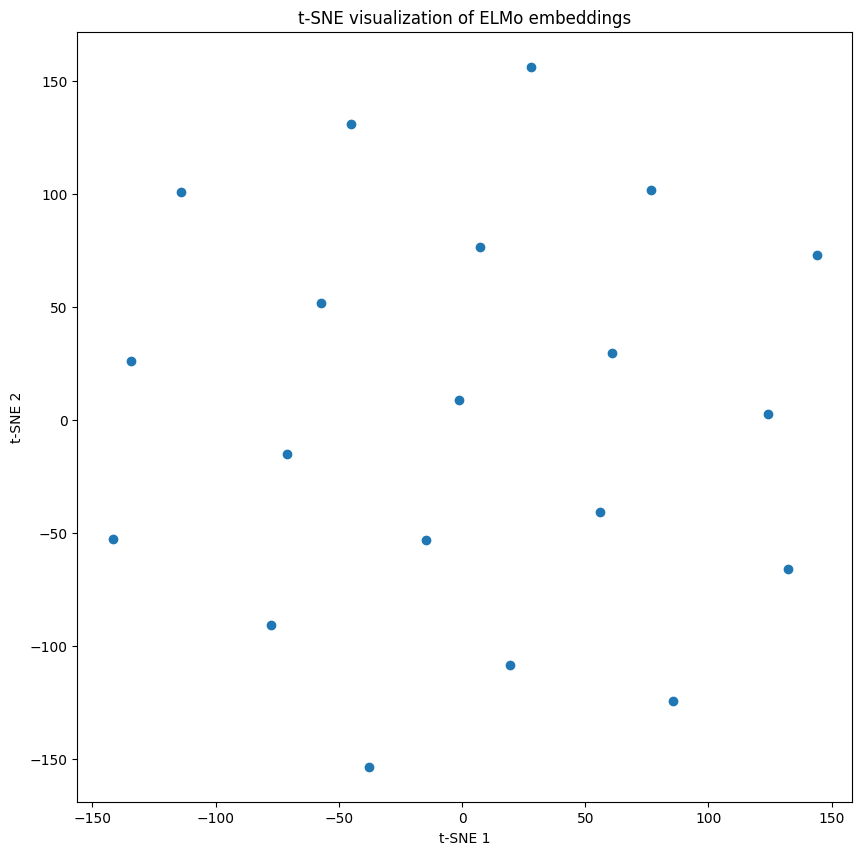

/tmp/ipython-input-3580207400.py:78: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("tab10", len(unique_cats))


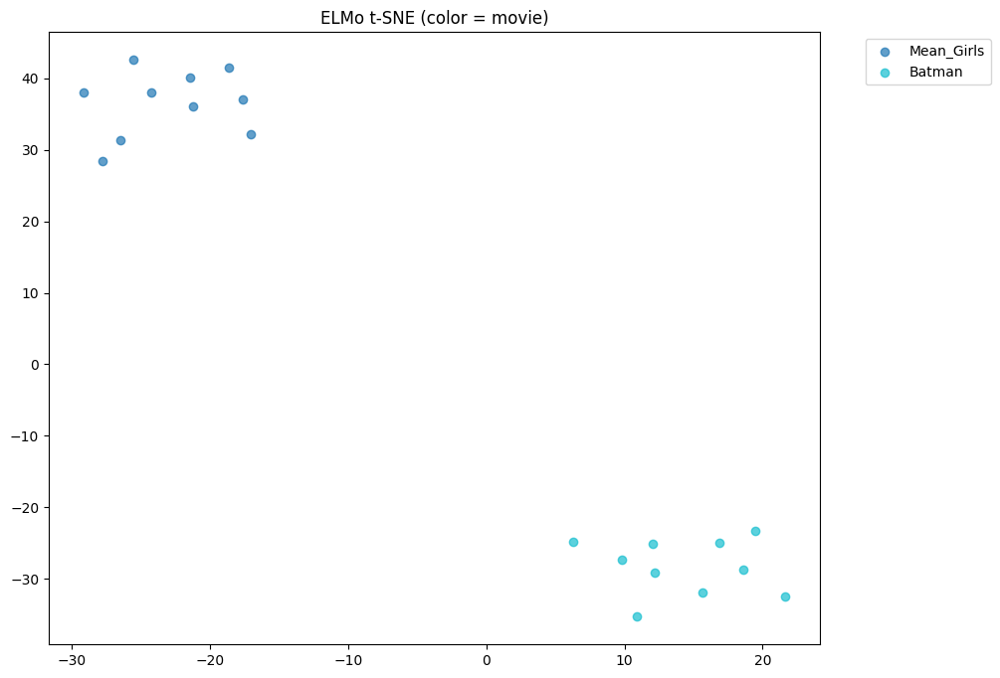

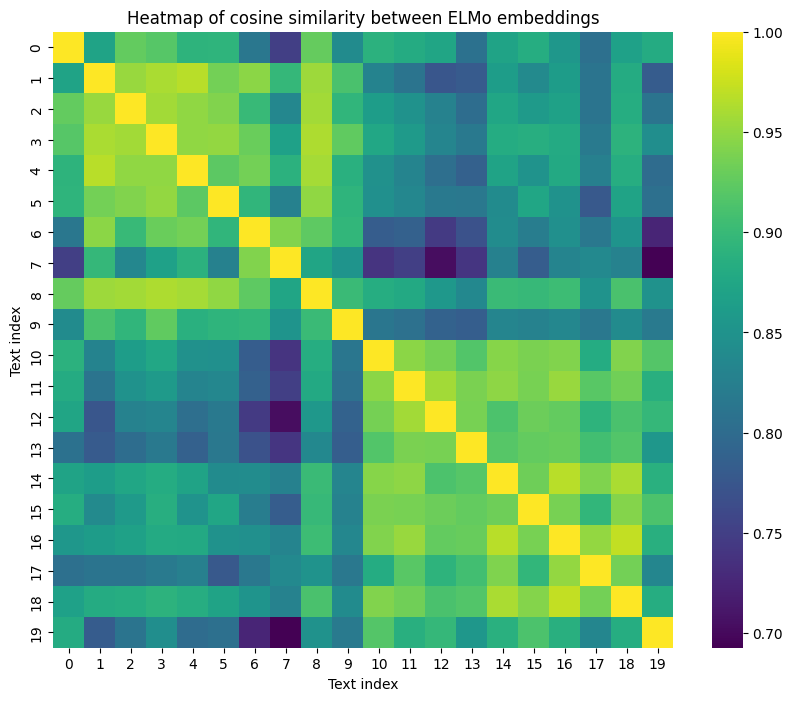

In [ ]:
# ELMo Embeddings (TensorFlow Hub)
!pip install tensorflow tensorflow-hub

import tensorflow_hub as hub
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns

# Load ELMo model from TF Hub
elmo = hub.load("https://tfhub.dev/google/elmo/3")

def get_elmo_embeddings(texts):
    """
    Generate ELMo embeddings for a list of texts.
    """
    text_tf = tf.constant(texts)
    embeddings = elmo.signatures['default'](text_tf)['elmo']
    return embeddings

# Use raw texts
texts = corpus_df['Text'].tolist()

# Batch processing
batch_size = 4
sample_size = 20   # use smaller sample for speed

all_embeddings = []
for i in range(0, sample_size, batch_size):
    batch_texts = texts[i:i+batch_size]
    batch_embeddings = get_elmo_embeddings(batch_texts)
    all_embeddings.append(batch_embeddings)
    print(f"Processed batch {i//batch_size + 1}/{(sample_size//batch_size)+1}")

# Convert to numpy
all_embeddings_np = np.concatenate(
    [batch.numpy().mean(axis=1) for batch in all_embeddings], axis=0
)

print("ELMo embedding shape:", all_embeddings_np.shape)

# t-SNE Visualization
if sample_size >= 30:
    tsne = TSNE(n_components=2, random_state=42)
else:
    tsne = TSNE(n_components=2, random_state=42, perplexity=max(2, sample_size-1))

embeddings_tsne = tsne.fit_transform(all_embeddings_np)

plt.figure(figsize=(10, 10))
plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1])
plt.title("t-SNE visualization of ELMo embeddings")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.show()

#  ELMo t-SNE colored by Movie
n_used = all_embeddings_np.shape[0]

doc_ids_for_embeddings = list(corpus_df['Doc_ID'])[:n_used]

# Build DataFrame of embeddings indexed by Doc_ID
elmo_doc_df = pd.DataFrame(all_embeddings_np, index=doc_ids_for_embeddings)

# Map Doc_IDs to movie titles
movie_series = pd.Series({doc_id: titles_by_doc_ids[doc_id] for doc_id in elmo_doc_df.index})

# Define helper function to plot t-SNE by category
def plot_tsne_by_category(df, categories, title="t-SNE by category"):
    tsne = TSNE(n_components=2, random_state=42, perplexity=5)
    tsne_values = tsne.fit_transform(df.values)

    plt.figure(figsize=(10, 8))
    unique_cats = categories.unique()
    colors = plt.cm.get_cmap("tab10", len(unique_cats))

    for i, cat in enumerate(unique_cats):
        idx = [j for j, c in enumerate(categories) if c == cat]
        plt.scatter(tsne_values[idx, 0], tsne_values[idx, 1],
                    label=cat, alpha=0.7, c=[colors(i)])

    plt.title(title)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

# Now plot t-SNE by movie
plot_tsne_by_category(elmo_doc_df, movie_series, title="ELMo t-SNE (color = movie)")

#  Heatmap of ELMo Similarities
similarity_matrix = cosine_similarity(all_embeddings_np)

plt.figure(figsize=(10, 8))
sns.heatmap(similarity_matrix, cmap="viridis")
plt.title("Heatmap of cosine similarity between ELMo embeddings")
plt.xlabel("Text index")
plt.ylabel("Text index")
plt.show()


In [ ]:
# TF-IDF Summary Tables (fixed for stemming)

from nltk.stem import PorterStemmer

# nominated terms from Part 1
nominated_terms = ["annie", "helen", "women", "wedding", "wiig"]

ps = PorterStemmer()
vocab = set(doc_term_df.columns)

# Map nominees -> stemmed forms used in TF-IDF matrix
stem_map = {t: ps.stem(t.lower()) for t in nominated_terms}

# Keep only nominees whose stem exists in the TF-IDF columns
present_map = {orig: stem for orig, stem in stem_map.items() if stem in vocab}
missing_map = {orig: stem for orig, stem in stem_map.items() if stem not in vocab}

print("Stemmed nominees that exist in TF-IDF vocab:", present_map)
if missing_map:
    print("Stemmed nominees missing from vocab (FYI):", missing_map)

# --- 1a: Mean TF-IDF for nominated terms (pretty index restored) ---
if present_map:
    cols = list(present_map.values())
    nominated_tfidf = doc_term_df[cols].mean().round(4)
    # restore original term names in the index
    pretty = {v: k for k, v in present_map.items()}
    nominated_tfidf.index = [pretty[c] for c in nominated_tfidf.index]
    nominated_tfidf_table = pd.DataFrame(nominated_tfidf, columns=["Mean TF-IDF"])
    nominated_tfidf_table.index.name = "Term"
    print("=== Mean TF-IDF Scores for  Nominated Terms  ===")
    display(nominated_tfidf_table)
else:
    print(" None of the nominated terms matched the TF-IDF vocabulary after stemming.")

# --- 1b: Top 10 Highest Mean TF-IDF Terms  ---
cols_clean = [c for c in doc_term_df.columns if len(c) >= 3]
doc_term_df_clean = doc_term_df[cols_clean]

top10_tfidf_table = (
    pd.DataFrame(doc_term_df_clean.mean().round(4).sort_values(ascending=False).head(10))
    .rename(columns={0: "Mean TF-IDF"})
)
top10_tfidf_table.index.name = "Term"

print("=== Top 10 Terms by Mean TF-IDF Score (tokens ≥ 3 chars) ===")
display(top10_tfidf_table)



Stemmed nominees that exist in TF-IDF vocab: {'annie': 'anni', 'helen': 'helen', 'wedding': 'wed', 'wiig': 'wiig'}
Stemmed nominees missing from vocab (FYI): {'women': 'women'}
=== Mean TF-IDF Scores for  Nominated Terms  ===


,Mean TF-IDF
Term,
annie,1.8522
helen,0.4964
wedding,0.3001
wiig,0.6834


=== Top 10 Terms by Mean TF-IDF Score (tokens ≥ 3 chars) ===


,Mean TF-IDF
Term,
film,3.5484
movi,3.3052
barbi,2.4799
like,2.4071
one,2.2639
time,1.9994
charact,1.8805
anni,1.8522
get,1.7376


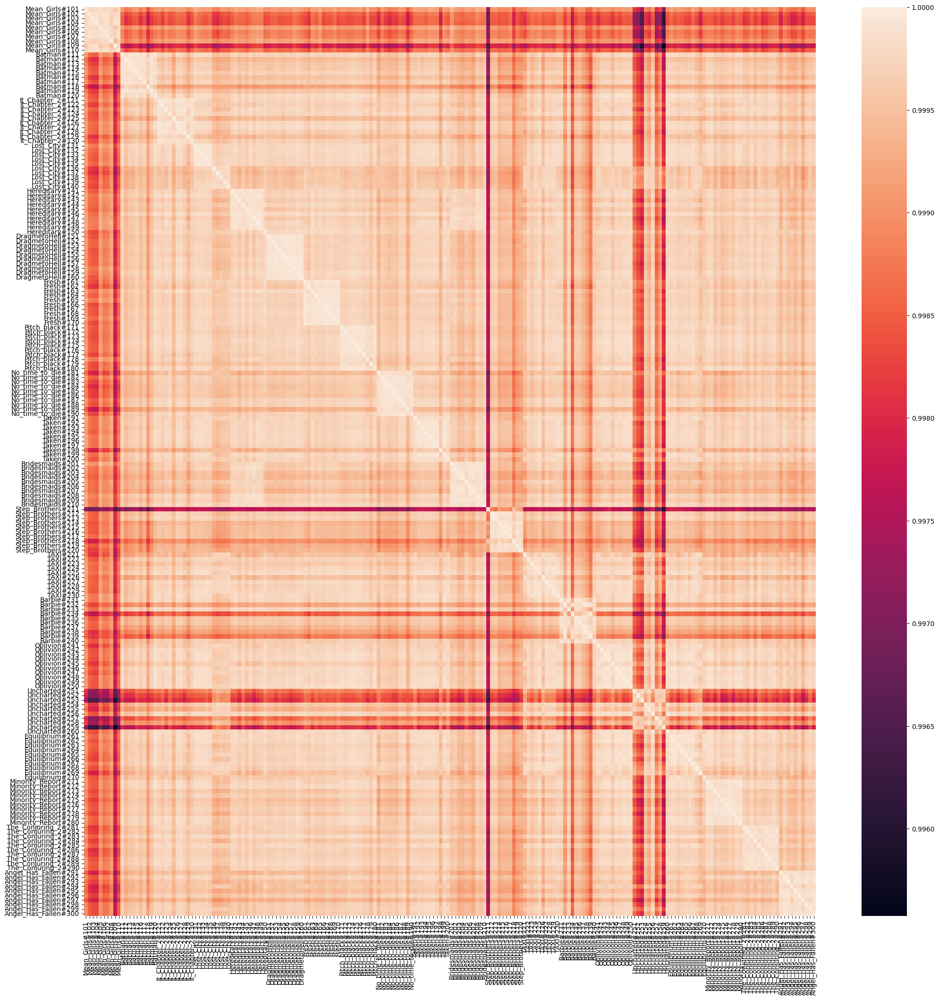

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


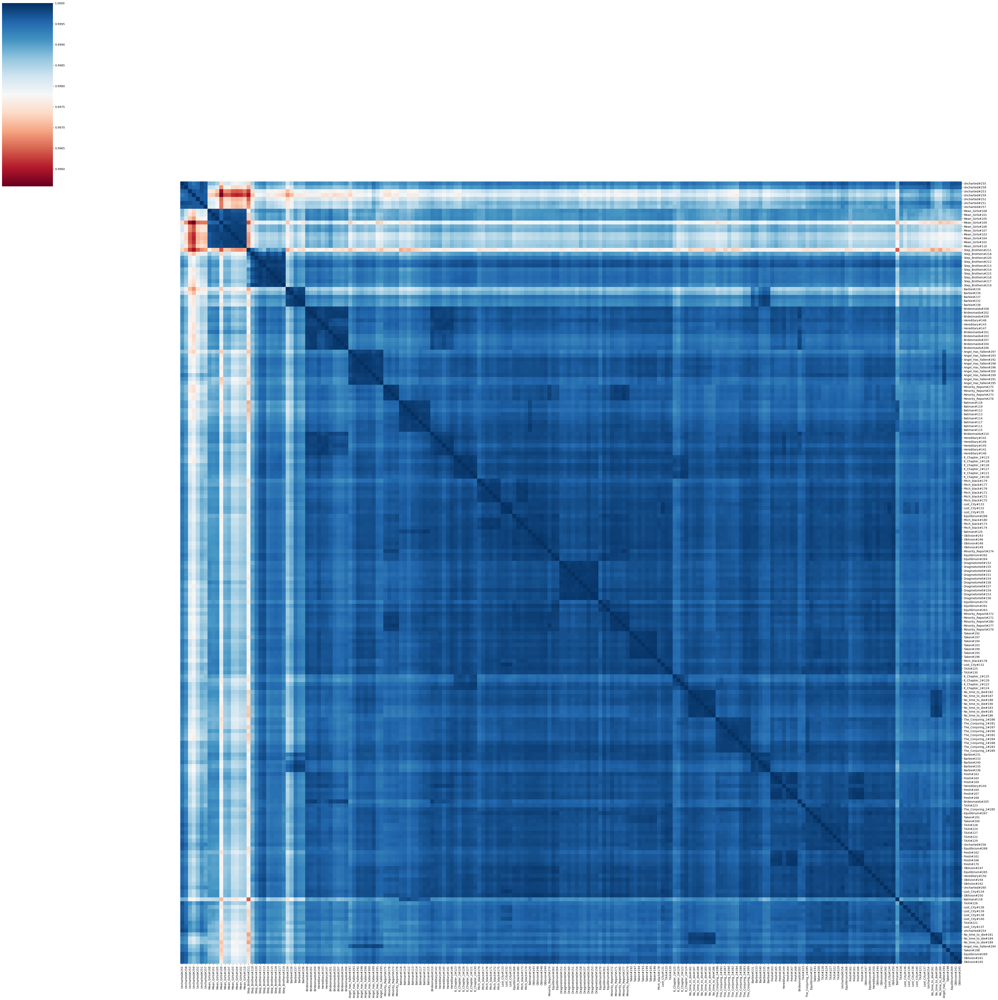

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


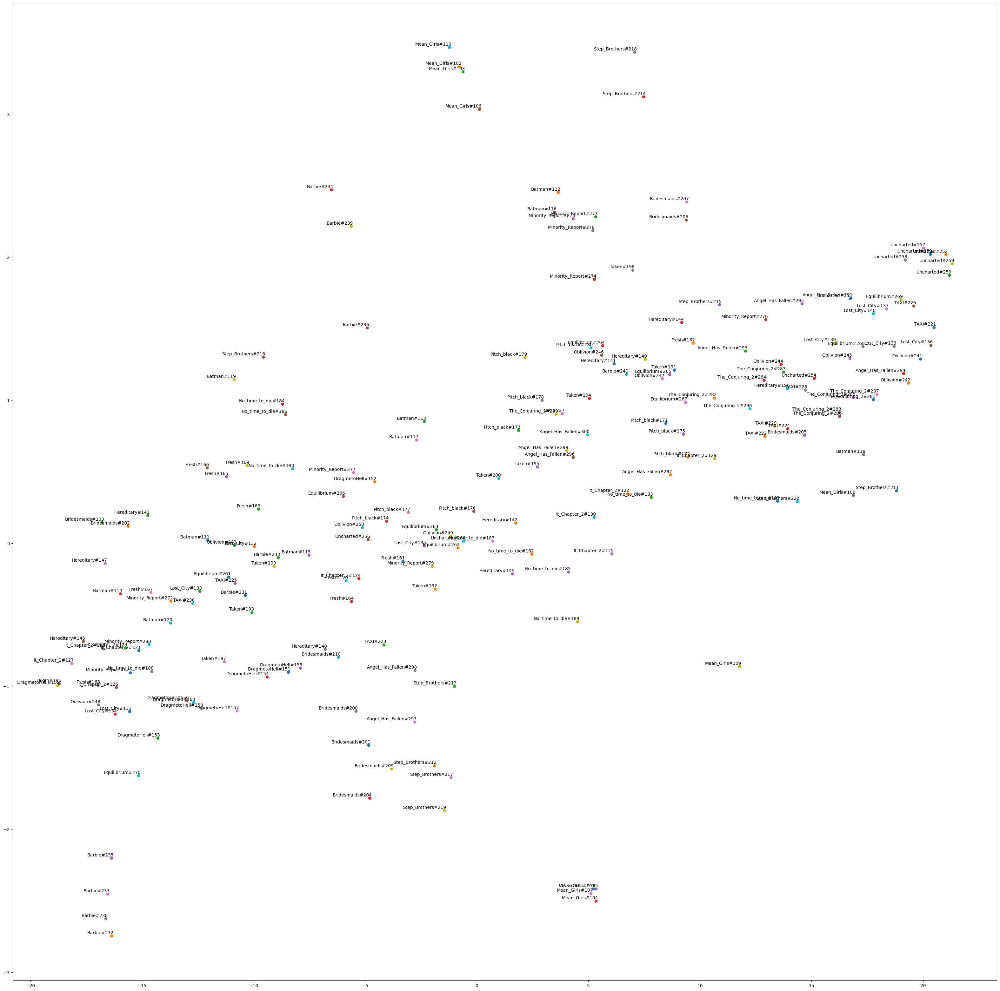

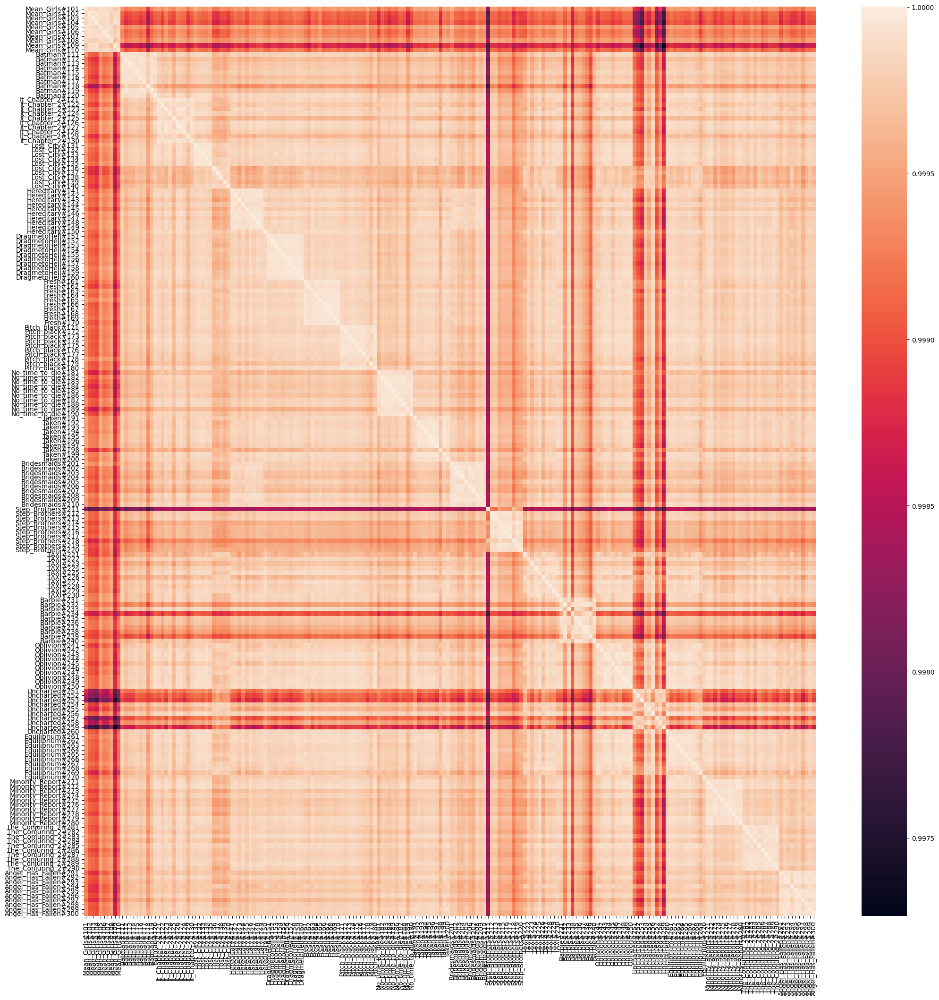

/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.12/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


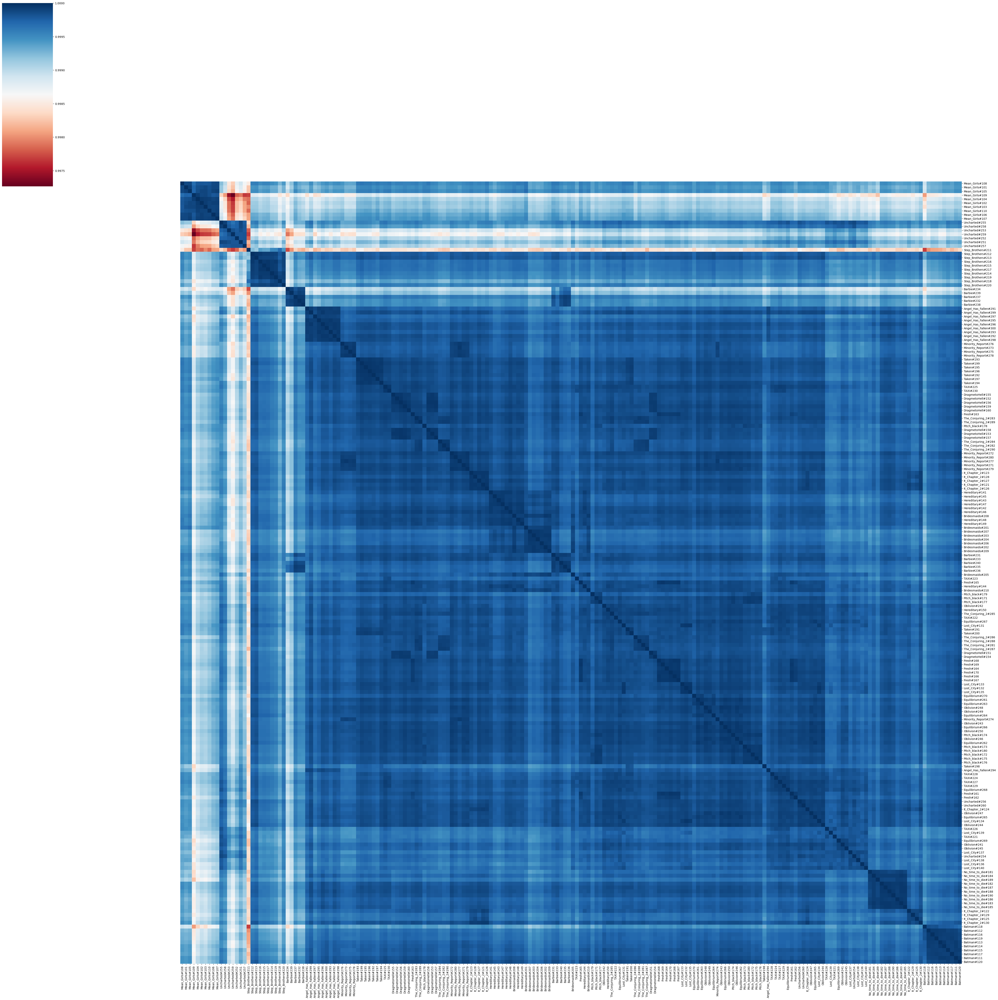

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


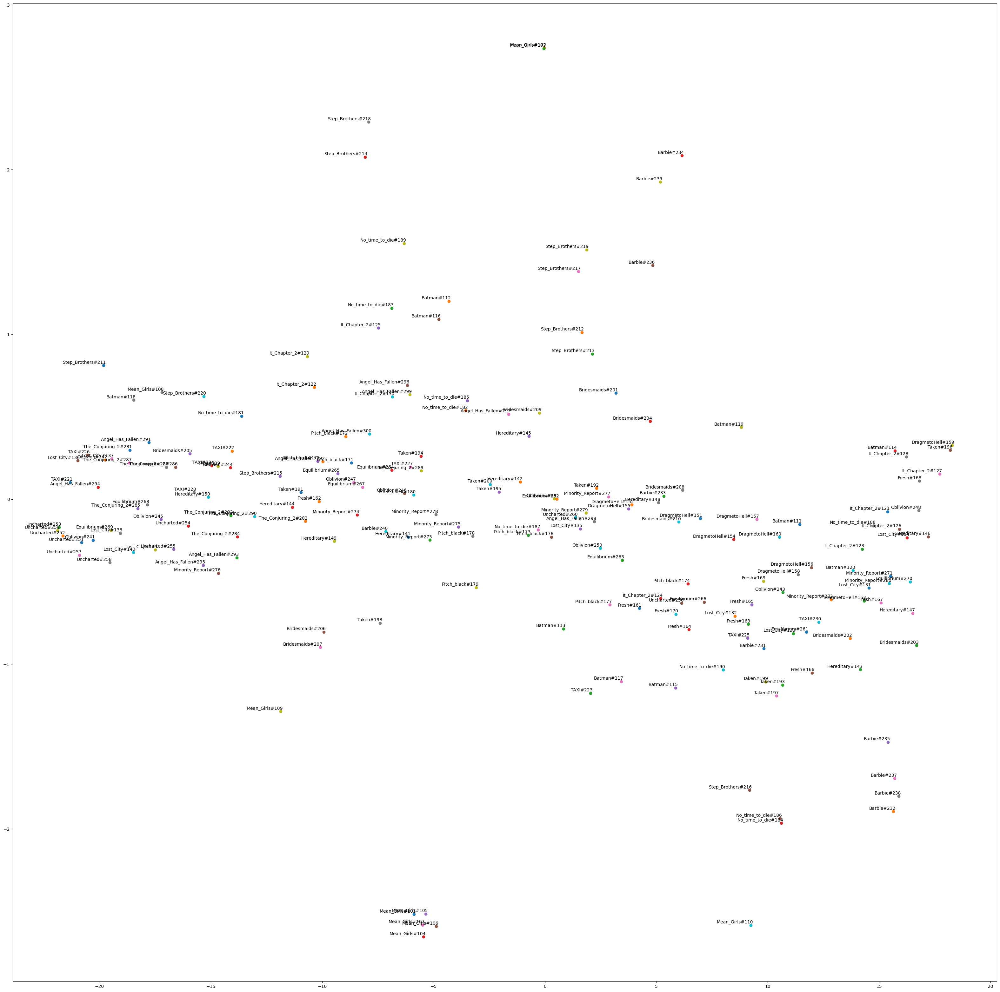

In [ ]:
# 1 Doc2Vec Experiments (200d and 300d)

# Run Doc2Vec with embedding size 200
run_doc2vec_experiment(documents, clean_method, 200, "Doc2Vec_exp_200d")

# Run Doc2Vec with embedding size 300
run_doc2vec_experiment(documents, clean_method, 300, "Doc2Vec_exp_300d")
